# Data science is OSEMN

According to a popular model, the elements of data science are

* Obtaining data
* Scrubbing data
* Exploring data
* Modeling data
* iNterpreting data

and hence the acronym OSEMN, pronounced as “Awesome”.

We will start with the **O**, moving towards the rest later, but first let's have a quick look at what it all boils down to

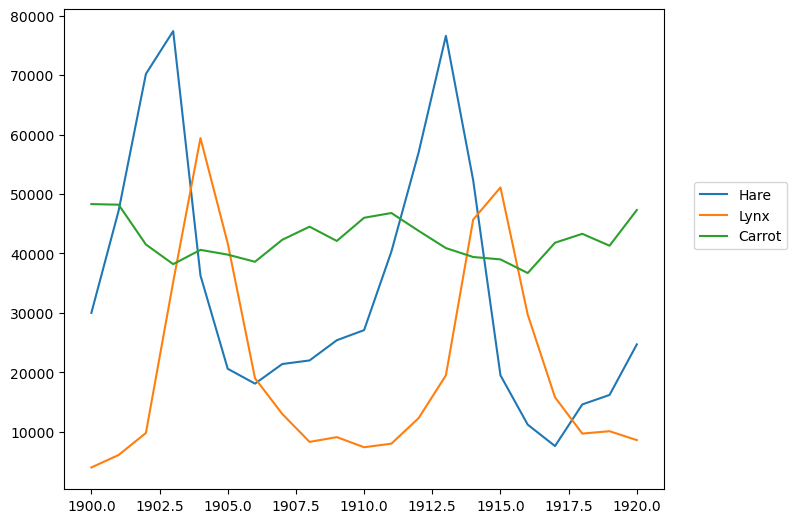

In [1]:
import numpy as np
data = np.loadtxt('populations.txt')
year, hares, lynxes, carrots = data.T # trick: columns to variables


from matplotlib import pyplot as plt
%matplotlib inline

plt.figure(figsize=(12,6))
plt.axes([0.2, 0.1, 0.5, 0.8]) 
plt.plot(year, hares, year, lynxes, year, carrots) 
plt.legend(('Hare', 'Lynx', 'Carrot'), loc=(1.05, 0.5)) 

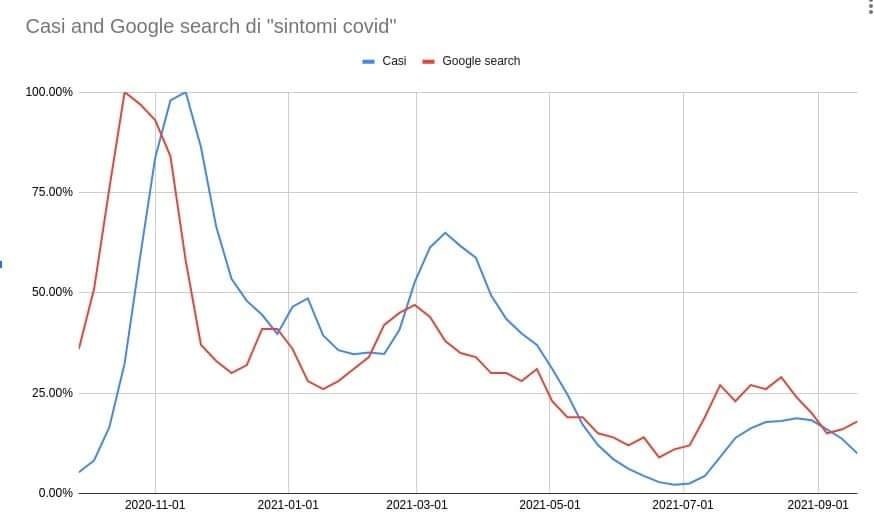

In [2]:
from IPython.display import Image
Image("cases_vs_searches.jpeg")

By plotting the data a clear (and reasonable) correlations between pray and predator becomes evident. How can it be quantified? Is that statistical significant? What about the correlation between carrots and hares? Is that evident? Is that significant?

Finding correlations in data is the main goal of data science, though that is not the end of the story: as this precious [site](http://tylervigen.com/spurious-correlations) demonstrates, **correlations is not causation**. 

(I've been invited to a school of Philosophy of Science to talk about the role of ML in Physics and they even asked me to write a summary of that. You find it [here](https://www.dropbox.com/s/lcjpgsrsoi0iyq3/Fisica_ML.docx), in Italian.. (humanists like that better than English))


*Exercise*: write an algorithm that determins and quantifies a correlation between two time series. Use as an example the hare-lynx-carrot dataset.

**N.B:** 
If in the cells below you import a packpage not yet installed, you can either install it the usual way, or run a cell like the following:

In [ ]:
# uncomment and set  NAME_OF_THE_PACKAGE to what you need
'''
import subprocess
subprocess.call(['pip', 'install', 'NAME_OF_THE_PACKAGE'])
'''

# Obtaining and processing (remote) data

Accessing data is a really serious business. Data can sit on public or on remote machines. In the case of the former, things may be straightforward, whereas in the latter case you need to worry about a few things.

In both cases, depending on the size of the dataset, the managment of the dataset can become extremely complicated. We won't deal here with large datasets, which require a whole course per se.., but still care should be put. In particular, it is not wise to keep (and even worse commit) data into a git repository!

The suggestion is then to create a directory somewhere and copy the example datasets there. From a terminal:

```bash

# create a data directory in your home directory
mkdir ~/data/

# check the content (it's empty now of course)
ls -ltr ~/data/

# in the case you need to move there:
cd ~/data/
```

### Download data from a server

A nice set of interesting datasets can be found on this [server](https://archive.ics.uci.edu/ml/datasets.php) that collects training/test data for machine learning developments. Several of those pertein physical sciences, it is worth browsing through those.

You can download any of those, in the following we will consider a dataset from the MAGIC experiment. For that we will the `wget` command

In [3]:
# get the dataset and its description on the proper data directory
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/magic/magic04.data -P ~/data/
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/magic/magic04.names -P ~/data/    

--2023-11-15 10:59:49--  https://archive.ics.uci.edu/ml/machine-learning-databases/magic/magic04.data
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘/home/albertosalvador/data/magic04.data’

magic04.data            [               <=>  ]   1.41M   421KB/s    in 3.4s    

2023-11-15 10:59:53 (421 KB/s) - ‘/home/albertosalvador/data/magic04.data’ saved [1477391]

--2023-11-15 10:59:53--  https://archive.ics.uci.edu/ml/machine-learning-databases/magic/magic04.names
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘/home/albertosalvador/data/magic04.names’

magic04.names           [ <=>                ]   5.27K  --.

In [4]:
# print the description. This can (and better) be done from a terminal
!cat ~/data/magic04.names

1. Title of Database: MAGIC gamma telescope data 2004

2. Sources:

   (a) Original owner of the database:

       R. K. Bock
       Major Atmospheric Gamma Imaging Cherenkov Telescope project (MAGIC)
       http://wwwmagic.mppmu.mpg.de
       rkb@mail.cern.ch

   (b) Donor:

       P. Savicky
       Institute of Computer Science, AS of CR
       Czech Republic
       savicky@cs.cas.cz

   (c) Date received: May 2007

3. Past Usage:

   (a) Bock, R.K., Chilingarian, A., Gaug, M., Hakl, F., Hengstebeck, T.,
       Jirina, M., Klaschka, J., Kotrc, E., Savicky, P., Towers, S.,
       Vaicilius, A., Wittek W. (2004).
       Methods for multidimensional event classification: a case study
       using images from a Cherenkov gamma-ray telescope.
       Nucl.Instr.Meth. A, 516, pp. 511-528.

   (b) P. Savicky, E. Kotrc.
       Experimental Study of Leaf Confidences for Random Forest.
       Proceedings of COMPSTAT 2004, In: Computational Statistics.
       (Ed.: Antoch J.) - Heidelberg, Physi

In [5]:
!cat ~/data/magic04.data

28.7967,16.0021,2.6449,0.3918,0.1982,27.7004,22.011,-8.2027,40.092,81.8828,g
31.6036,11.7235,2.5185,0.5303,0.3773,26.2722,23.8238,-9.9574,6.3609,205.261,g
162.052,136.031,4.0612,0.0374,0.0187,116.741,-64.858,-45.216,76.96,256.788,g
23.8172,9.5728,2.3385,0.6147,0.3922,27.2107,-6.4633,-7.1513,10.449,116.737,g
75.1362,30.9205,3.1611,0.3168,0.1832,-5.5277,28.5525,21.8393,4.648,356.462,g
51.624,21.1502,2.9085,0.242,0.134,50.8761,43.1887,9.8145,3.613,238.098,g
48.2468,17.3565,3.0332,0.2529,0.1515,8.573,38.0957,10.5868,4.792,219.087,g
26.7897,13.7595,2.5521,0.4236,0.2174,29.6339,20.456,-2.9292,0.812,237.134,g
96.2327,46.5165,4.154,0.0779,0.039,110.355,85.0486,43.1844,4.854,248.226,g
46.7619,15.1993,2.5786,0.3377,0.1913,24.7548,43.8771,-6.6812,7.875,102.251,g
62.7766,29.9104,3.3331,0.2475,0.1261,-33.9065,57.5848,23.771,9.9144,323.094,g
18.8562,16.46,2.4385,0.5282,0.2933,25.1269,-6.5401,-16.9327,11.461,162.848,g
45.6321,22.71,3.0441,0.2213,0.1215,-18.3986,-20.6427,-14.3164,0.3822,178.255,g
33.1

28.9745,10.8616,2.5441,0.44,0.2557,-18.5555,18.1993,8.1459,5.1486,168.448,g
21.1063,6.6598,2.0917,0.7611,0.4737,20.1204,15.6882,6.1724,7.8499,150.165,g
83.1099,38.2191,3.6877,0.2092,0.1089,-18.9875,-40.7731,25.8337,1.9969,366.082,g
47.8281,19.7515,3.2392,0.2543,0.1289,28.5766,34.306,-14.579,3.53,244.304,g
77.5988,38.494,3.9316,0.1006,0.0505,83.1377,61.3527,29.8495,4.774,247.285,g
36.7526,10.7672,2.433,0.4465,0.2269,-51.6149,11.8839,8.2875,6.816,145.572,g
35.5151,17.6425,2.6258,0.3645,0.1905,-5.8108,-32.7277,6.846,77.961,128.676,g
70.1391,23.6089,3.4812,0.1892,0.1002,69.4322,56.7105,-12.7678,1.149,256.641,g
23.9049,11.3034,2.4935,0.5457,0.2745,-6.1584,-20.4676,3.8512,19.4896,268.549,g
21.9111,9.7568,2.2304,0.6471,0.4088,-20.1798,-20.0216,11.5157,87.9835,186.455,g
17.9821,10.7309,2.3032,0.5672,0.296,1.6666,-7.6764,-5.202,23.651,144.039,g
86.3454,31.682,3.4011,0.2621,0.1448,8.8598,58.8187,-29.8343,7.0441,372.642,g
49.2474,20.7543,3.3033,0.2263,0.1256,19.1143,41.5419,4.9216,8.3432,252.168,

85.6428,24.2711,3.5073,0.1269,0.0648,68.3764,77.4443,-14.1791,6.784,204.996,g
34.6098,24.9802,2.8913,0.2235,0.1137,-5.8604,22.1893,6.4483,13.962,127.753,g
71.8872,31.5961,2.9694,0.2167,0.11,-79.9779,40.7022,24.5327,3.211,255.282,g
32.2869,16.2117,2.6385,0.4161,0.2356,13.109,24.6315,-12.0596,5.8259,195.812,g
22.35,14.565,2.7701,0.4431,0.2368,23.1078,11.831,-7.2555,15.335,244.838,g
29.0234,15.0818,2.6749,0.463,0.2928,2.4375,1.2191,-11.5072,46.187,174.816,g
28.0195,11.2982,2.5038,0.4263,0.2147,13.16,-13.012,6.3103,7.994,171.566,g
29.76,20.914,2.882,0.2992,0.1594,0.5537,9.3549,-7.9018,6.2206,80.1779,g
90.8675,24.7563,3.1543,0.2986,0.1728,68.0419,63.9433,11.4056,3.5131,302.552,g
33.4593,15.542,2.7177,0.3755,0.2059,-15.7864,23.7646,-10.6204,6.2132,270.461,g
93.0625,35.6295,3.587,0.1998,0.1207,-49.8679,-60.4177,-13.3153,7.6778,310.108,g
43.8728,19.0744,2.8817,0.323,0.1832,-56.0637,13.1093,-14.8955,6.3685,272.114,g
68.3993,14.9059,2.889,0.377,0.2072,-86.9664,64.793,-8.5827,1.651,254.099,g
20.9

17.5266,10.7937,2.2068,0.6087,0.3447,2.0403,-7.3702,-6.718,14.9484,135.567,g
36.328,15.3849,2.7118,0.3573,0.1816,-16.9161,-15.0475,11.495,12.0273,116.339,g
20.9711,7.1236,2.0354,0.7005,0.3548,24.6388,9.2732,6.1364,8.9281,182.127,g
32.9875,17.0613,2.9256,0.3134,0.1869,4.9571,-6.4855,-10.384,7.5903,221.887,g
38.9589,22.2936,2.798,0.2659,0.1393,-10.7617,-22.966,15.807,20.615,182.32,g
27.4853,20.164,2.5428,0.4155,0.2536,32.1097,21.6209,-17.7377,13.981,154.488,g
34.434,17.7236,2.7016,0.334,0.1759,-23.4726,-23.4143,-7.8193,12.113,140.927,g
19.7541,16.4317,2.2613,0.4219,0.2219,-6.3288,18.1879,-0.5014,86.18,130.193,g
79.1223,27.1422,3.3206,0.2586,0.1738,-37.4337,50.88,-21.005,1.1933,293.084,g
50.5449,30.4447,3.009,0.1822,0.0945,25.2365,24.3465,27.5276,9.854,177.72,g
26.2893,19.8336,2.8238,0.3631,0.1928,-6.9989,-13.3547,-4.9754,16.7926,114.063,g
38.9707,11.7101,2.451,0.3681,0.2,-17.2561,-17.781,7.3396,14.4926,135.379,g
98.6144,32.5417,3.4926,0.203,0.1076,-28.7309,69.058,16.8049,0.7895,332.552,g

29.7368,21.2993,2.4526,0.3774,0.2169,-13.1269,-16.8538,-15.3985,43.616,106.011,g
27.9286,12.2904,2.4691,0.5263,0.3209,-2.1073,17.9805,-8.8211,4.7018,146.317,g
65.3382,27.563,3.363,0.1985,0.1207,-66.9972,37.0247,18.1334,0.847,294.505,g
33.8011,16.5381,2.4409,0.4022,0.2264,36.1095,-21.6556,8.689,0.6014,95.0528,g
33.5536,13.2952,2.7271,0.4349,0.3008,12.6131,18.8399,-9.8063,5.2729,180.283,g
65.739,24.7642,3.4049,0.1779,0.1175,13.6016,41.4762,-17.7319,2.7714,223.683,g
16.9619,7.3198,2.2343,0.828,0.5685,-2.8022,-5.5395,5.3377,82.7575,113.965,g
25.7435,11.5007,2.3936,0.5495,0.2808,13.1792,13.5935,-11.6217,8.982,181.026,g
50.7112,24.4091,3.4817,0.1963,0.0991,23.3746,31.9105,-13.1056,0.5754,181.872,g
18.3601,12.5485,2.5004,0.5845,0.327,16.6842,13.4913,-6.4762,9.025,134.525,g
21.887,6.7909,2.1255,0.7116,0.3783,-24.8621,-9.3553,6.6275,24.1247,86.2358,g
17.1349,11.1551,2.356,0.5771,0.3194,2.1347,-7.3279,-5.7304,8.1236,186.055,g
24.7931,17.4496,2.7536,0.4109,0.2284,-0.1667,-9.03,-15.2918,5.178,197.

85.054,30.1405,3.991,0.1182,0.0615,-83.0643,77.7161,-16.878,2.82,258.322,g
21.0483,17.6112,2.4409,0.4529,0.2373,29.591,-9.6241,14.2623,32.4415,173.549,g
74.8373,28.3282,3.4859,0.1721,0.09,-76.7946,53.9904,-11.9086,0.1197,253.66,g
47.9863,14.4663,2.9722,0.322,0.169,47.1752,36.8788,8.3362,3.9724,213.408,g
31.3412,21.5299,2.8395,0.3271,0.1758,26.4682,20.2562,18.8403,22.1398,134.372,g
18.8834,10.09,2.444,0.5935,0.3327,-22.8136,-10.8397,4.4965,57.86,197.527,g
54.8736,15.18,2.5422,0.4189,0.2769,14.4831,53.7051,8.0421,3.4462,181.609,g
21.4291,12.6409,2.4289,0.4916,0.2775,13.7993,15.2283,8.7216,38.5808,211.057,g
18.437,15.6922,2.5159,0.5244,0.3034,0.6647,-12.8405,9.6849,87.3123,110.3,g
64.2085,33.2754,3.5144,0.1575,0.0794,-4.0258,31.0346,-29.3788,13.8747,183.081,g
37.1453,19.5056,3.107,0.2696,0.1395,-1.9338,26.7564,12.0698,0.6385,135.21,g
22.0959,6.646,2.1189,0.73,0.4068,-23.8832,-11.7155,-6.6937,13.3891,163.277,g
83.8436,31.8164,3.588,0.1498,0.0853,77.5835,92.3676,25.6721,3.2408,244.771,g
47.

29.343,14.3352,2.5192,0.3933,0.2254,7.481,17.3714,-10.1171,85.8903,47.2501,g
20.7706,7.0894,2.0881,0.7347,0.3878,-23.0042,-11.9469,-5.953,19.8866,143.924,g
19.3382,12.613,2.4091,0.5263,0.2904,-1.9269,11.2469,-9.2856,40.7067,237.436,g
28.0488,11.8991,2.5085,0.5767,0.3612,32.2326,15.0283,11.4086,8.2259,182.558,g
20.2339,18.7936,2.5058,0.3775,0.2075,-19.4777,-11.7949,-11.544,42.79,64.4979,g
108.6,51.6088,4.3048,0.0621,0.0325,-23.3234,82.0186,26.2819,0.013,291.739,g
29.5906,18.5962,2.7122,0.3899,0.1988,20.2784,16.6716,9.4868,16.103,130.696,g
50.8142,27.7736,3.3463,0.1901,0.1061,28.326,39.9401,-20.2304,4.7419,187.57,g
24.4082,19.4895,2.9914,0.36,0.2198,9.615,15.303,7.9559,20.487,91.0575,g
62.4115,31.2051,3.4099,0.2222,0.1138,58.6048,51.5254,25.8018,6.1268,267.515,g
20.4405,7.2784,2.0273,0.7042,0.3803,-0.8379,6.9937,-5.7382,3.57,77.4207,g
20.1939,12.0628,2.437,0.5265,0.2724,-1.6762,-4.8527,-8.7804,16.3257,131.568,g
21.0895,11.704,2.2455,0.6136,0.3324,10.5048,20.3281,-8.2767,17.201,196.733,g


26.0362,12.9389,2.7814,0.4036,0.2142,-24.4867,-18.4544,-4.7631,18.338,146.511,g
60.523,20.5941,2.9559,0.2568,0.1312,-95.9883,38.2529,-14.9239,9.3455,241.618,g
23.3194,18.3503,2.4935,0.443,0.236,13.5709,-16.6518,13.3584,62.9998,115.607,g
35.2593,28.7212,3.3384,0.2092,0.1053,-5.5941,21.9436,11.4688,29.8043,78.0852,g
59.435,19.6081,2.913,0.3177,0.2046,-77.3754,-29.321,-19.4123,5.841,284.039,g
30.2816,0,2.1931,0.6154,0.3173,0,0,-9.7897,77.0283,231.484,g
31.6768,11.5698,2.6107,0.5,0.315,-11.2555,15.8089,10.6832,0.1453,155.778,g
20.8079,11.8039,2.3971,0.509,0.2986,-1.3538,10.29,11.4076,66.158,66.2116,g
13.023,10.28,2.1477,0.7829,0.5231,-12.3598,-6.5581,-8.6419,66.082,124.327,g
13.3791,9.9131,2.2393,0.8184,0.4986,-12.9121,-7.7106,11.2857,0.708,124.509,g
18.7188,7.4401,2.2393,0.7781,0.4755,-2.4933,7.4645,-2.728,76.831,86.2408,g
100.61,18.4984,2.2799,0.4672,0.2546,-76.4084,-81.1744,-10.7762,88.2467,149.028,g
24.9369,19.1991,2.6325,0.4429,0.3019,4.5498,14.8654,-18.1092,83.7468,37.3899,g
82.8786,

47.57,13.3866,2.7853,0.2951,0.1648,-69.7939,22.5369,4.4099,3.654,219.484,g
64.9481,35.2075,3.0757,0.1957,0.1004,-66.3145,41.6654,25.127,2.9623,315.02,g
32.1173,8.6703,2.5581,0.5367,0.3223,38.6335,17.8782,11.2552,12.3552,253.279,g
44.8497,18.4744,2.9863,0.2054,0.1078,-15.6975,-15.9804,-4.3948,11.1617,181.296,g
22.0999,13.2785,2.5599,0.5565,0.3402,12.7705,12.8172,4.2833,17.6539,171.036,g
117.986,11.2223,2.8248,0.4746,0.2597,-92.2538,-76.6361,2.6605,1.3389,388.998,g
27.5166,20.3364,2.7631,0.3848,0.2114,-11.0687,21.4525,-17.8332,44.6119,152.287,g
26.6236,11.8438,2.5563,0.4194,0.2208,7.3868,17.682,11.307,5.2526,143.83,g
85.4369,30.3729,3.6503,0.1324,0.0746,17.285,78.4434,16.0943,2.791,227.554,g
67.8471,23.3169,3.1067,0.2456,0.1334,91.1437,49.6572,15.9699,0.8502,287.433,g
66.6232,18.4378,3.2647,0.1859,0.1014,48.5714,50.3889,-14.5178,2.2166,227.106,g
24.313,12.0951,2.3874,0.4221,0.2561,-10.0699,-8.7859,-7.1759,7.161,198.646,g
21.2876,11.4904,2.4771,0.6167,0.4117,-13.26,-20.5012,-8.1759,14.948

25.5677,13.9963,2.5988,0.5063,0.2783,14.5574,12.6384,-9.8595,5.282,271.324,h
129.588,17.3475,2.8963,0.367,0.2356,-55.0224,-126.579,-4.9852,12.489,52.9832,h
29.4179,11.7708,2.3531,0.4612,0.2373,-40.6959,16.1943,-8.1564,27.195,53.6041,h
42.7722,4.5409,2.3663,0.422,0.2066,59.0081,-10.6186,-4.9732,61.7914,150.1526,h
91.6025,13.9875,3.0438,0.2803,0.146,-70.2291,65.8994,10.5203,43.096,284.879,h
95.8843,23.7653,2.8139,0.3162,0.2018,95.1811,64.2982,-20.3877,65.137,153.985,h
190.585,52.0182,3.3878,0.1801,0.0956,-113.913,-136.932,45.3605,34.157,245.866,h
41.188,8.7842,2.8172,0.5072,0.3191,12.6751,30.7532,-2.4186,15.6484,200.298,h
133.405,56.024,3.3631,0.0875,0.0505,-121.718,107.542,64.3733,62.358,173.875,h
103.407,64.4265,4.1762,0.0668,0.0349,-0.7411,64.3895,49.2008,74.192,159.135,h
18.4881,6.2289,2.4091,0.8772,0.5595,15.2583,16.3451,2.9808,87.6399,80.5684,h
33.1934,10.4132,2.772,0.3956,0.2088,-2.7203,17.3502,-6.319,60.397,204.423,h
20.7106,12.0267,2.4976,0.5183,0.2782,-0.8819,-6.5739,-10.4168,3

152.1148,111.9084,4.2757,0.0501,0.0478,23.3989,-143.0185,104.2935,78.333,322.8603,h
72.1747,9.7887,2.9621,0.3013,0.1267,73.2587,34.1685,5.9555,29.0584,165.1348,h
227.5594,55.3849,3.8508,0.0959,0.0389,-203.9186,-145.6697,33.365,80.3525,240.8288,h
204.3035,33.0586,2.9113,0.4168,0.2006,-276.8136,153.2959,17.748,49.3124,134.7812,h
18.7103,14.6184,2.3883,0.5521,0.2883,-20.0492,-17.8785,5.8284,61.7061,213.428,h
78.4298,41.9392,3.0871,0.1874,0.0978,-84.9542,-62.6607,-14.4169,10.5036,206.881,h
41.1187,12.7348,2.6815,0.1935,0.1166,-30.7605,-13.3091,-11.2792,76.5615,53.1324,h
97.6316,26.6124,3.2527,0.1621,0.0914,79.4193,62.1694,-23.3873,73.2991,220.015,h
17.5764,10.8668,2.3945,0.5927,0.3085,-2.858,8.6927,-5.6742,50.6709,116.39,h
37.5719,10.1147,2.7853,0.4443,0.2254,31.2099,18.2122,6.5291,67.624,143.643,h
22.4461,1.7177,2.1143,0.7929,0.4383,-2.3507,-4.5425,22.5544,18.4254,211.4323,h
20.5036,8.7406,2.4683,0.6565,0.4201,21.2188,14.2452,-2.6566,16.992,157.411,h
21.8391,6.8034,2.2135,0.7095,0.3823,-2

29.1979,5.5862,2.2863,0.8092,0.5875,14.6833,13.4088,-8.3881,83.602,237.952,h
41.9892,11.468,2.6592,0.3039,0.1857,35.877,11.3109,18.5477,70.9603,106.3456,h
35.2705,19.3642,2.7419,0.317,0.1821,-40.5453,-27.359,16.449,80.8997,63.119,h
12.9526,9.8511,2.2911,0.8031,0.5601,11.4097,8.4522,8.6573,85.4342,226.159,h
20.7517,14.927,2.4518,0.5555,0.3881,4.6303,33.2333,-12.9532,57.1232,205.1802,h
18.336,10.3094,2.281,0.6126,0.3272,-1.9974,8.2036,6.2581,68.2545,62.5226,h
29.8424,11.0503,2.2857,0.4764,0.2834,-3.9082,-16.1008,-8.3781,62.5605,142.3577,h
28.0997,8.6496,2.8038,0.5703,0.3244,7.2847,21.4257,9.6579,8.2367,217.871,h
98.3474,41.8692,2.9761,0.3423,0.1791,-66.4291,-87.8181,-32.4785,26.902,343.841,h
63.1442,21.225,2.8404,0.3235,0.1682,48.6847,55.4917,18.033,64.627,197.537,h
174.257,41.9042,3.4632,0.1408,0.0793,-205.994,-80.0821,36.5045,34.5846,261.822,h
15.8992,9.9494,2.5267,0.5282,0.2889,-5.5882,0.0313,-4.6896,16.2751,229.8505,h
30.8445,7.0755,2.4759,0.6478,0.3148,2.6924,-25.6934,3.7971,80.2869

205.825,79.6351,3.5672,0.1479,0.0773,-105.779,-114.624,-83.0358,40.808,263.852,h
35.4434,15.4958,2.7796,0.3654,0.2334,13.8784,22.2955,-10.3435,47.273,244.308,h
33.6525,9.2823,2.7536,0.5176,0.2579,16.7471,17.8816,-9.0987,0.1516,154.3232,h
21.417,10.8622,2.2504,0.5562,0.2949,-21.8918,-18.919,-10.3199,84.3192,136.646,h
29.777,9.475,2.5408,0.4538,0.2148,43.7275,21.9444,8.5132,78.5463,175.1842,h
68.5716,16.3808,2.8271,0.2285,0.1852,-35.5697,-43.3323,12.9469,13.7631,135.1112,h
22.651,17.1751,2.6735,0.4645,0.2534,7.4406,-9.902,7.5273,39.676,207.251,h
32.1338,15.7307,2.7408,0.3361,0.1898,-29.7303,22.323,10.0916,15.817,228.861,h
19.1242,13.3689,2.4158,0.5605,0.3743,-4.3206,15.3461,-3.3485,26.1093,230.355,h
50.6003,10.4472,2.8876,0.4761,0.2508,18.9452,28.7274,-1.143,50.4959,149.4257,h
66.3173,37.1935,3.0145,0.3259,0.1678,-88.1575,44.5534,25.3617,4.738,274.443,h
88.287,34.2164,3.2123,0.2024,0.1064,-114.63,48.8101,-30.404,38.32,285.643,h
164.7605,47.2287,2.9351,0.4495,0.2438,-88.8637,-189.448,-11.

It is possible to download and load remote files via their url's directly from within python (and thus on a jupyter session). This is a rather powerful tool as it allows http communications, IO streaming and so on.

Care should be put as the dataset is stored in memory.

In [6]:
import urllib.request
url ='https://archive.ics.uci.edu/ml/machine-learning-databases/magic/magic04.names'
with urllib.request.urlopen(url) as data_file:
    #print (data_file.read(300))
    for line in data_file:
        print (line)

b'1. Title of Database: MAGIC gamma telescope data 2004\n'
b'\n'
b'2. Sources:\n'
b'\n'
b'   (a) Original owner of the database:\n'
b'\n'
b'       R. K. Bock\n'
b'       Major Atmospheric Gamma Imaging Cherenkov Telescope project (MAGIC)\n'
b'       http://wwwmagic.mppmu.mpg.de\n'
b'       rkb@mail.cern.ch\n'
b'\n'
b'   (b) Donor:\n'
b'\n'
b'       P. Savicky\n'
b'       Institute of Computer Science, AS of CR\n'
b'       Czech Republic\n'
b'       savicky@cs.cas.cz\n'
b'\n'
b'   (c) Date received: May 2007\n'
b'\n'
b'3. Past Usage:\n'
b'\n'
b'   (a) Bock, R.K., Chilingarian, A., Gaug, M., Hakl, F., Hengstebeck, T.,\n'
b'       Jirina, M., Klaschka, J., Kotrc, E., Savicky, P., Towers, S.,\n'
b'       Vaicilius, A., Wittek W. (2004).\n'
b'       Methods for multidimensional event classification: a case study\n'
b'       using images from a Cherenkov gamma-ray telescope.\n'
b'       Nucl.Instr.Meth. A, 516, pp. 511-528.\n'
b'\n'
b'   (b) P. Savicky, E. Kotrc.\n'
b'       Experimental Stu

###  Copy data from a remote machine

Often datasets are not available on websites but rather they are sitting on some remote machine. Several tools are there that can allow you to get hold off remote data, even from within python (e.g. [paramiko](https://www.paramiko.org/)), but best in this case is to get a local copy. E.g. from a terminal:

```bash
scp guest104@gatep.fisica.unipd.it:~/data/data_000637.* ~/data/
```

by issuing that command you are immediately exposed to the most relevant problem in obtaining the data: permissions/authorization.

Indeed that will not work (as you don't have an account on that machine and I'd be put into jail if I gave you the password), still you'll need that file later, so "wget" it:


In [7]:
!wget https://www.dropbox.com/s/69xe1d5f19nvtw3/data_000637.dat -P ~/data/

# copy the interpreted version as well
!wget https://www.dropbox.com/s/xvjzaxzz3ysphme/data_000637.txt -P ~/data/

--2023-11-15 11:18:40--  https://www.dropbox.com/s/69xe1d5f19nvtw3/data_000637.dat
Resolving www.dropbox.com (www.dropbox.com)... 162.125.69.18, 2620:100:6025:18::a27d:4512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.69.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/69xe1d5f19nvtw3/data_000637.dat [following]
--2023-11-15 11:18:40--  https://www.dropbox.com/s/raw/69xe1d5f19nvtw3/data_000637.dat
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc4366fc6a2238e5223a43f6caab.dl.dropboxusercontent.com/cd/0/inline/CHm3_LuIuCWYgbhD_OEmMaqHXyHamnw8WWpV6lyie6kBHw-2R0VjQqAxlm040iH_KVV0z3NRiB7AZtsWtAtIExo9z_2rcPWSv7f4hGQUYw5XZQiGIkE_tWFDxB2vPusERl8/file# [following]
--2023-11-15 11:18:40--  https://uc4366fc6a2238e5223a43f6caab.dl.dropboxusercontent.com/cd/0/inline/CHm3_LuIuCWYgbhD_OEmMaqHXyHamnw8WWpV6lyie6kBHw-2R0VjQqAxlm040iH_KVV0z3NRiB7AZtsWtAtIExo9z_2rcPWSv7f4hGQUYw5XZQi

Secondily (essentially a further consequence of the same issue), the remote machine itself may have accessibility restrictions, e.g. being behind a firewall. In that case you may need to use a tunnel:

``` bash
ssh -L 1234:<address of R known to G>:22 <user at G>@<address of G> 

scp -P 1234 <user at R>@127.0.0.1:/path/to/file file-name-to-be-copied
```

In summary, just getting the data is a complicated business.

## Data Formats

datasets can be stored in a gazillion different ways, often they have formats which are application dependent, even though more and more standards are being established. Python have "readers" for most of the formats, another reason for being the optimal programming language for data analysis.

### Text files 

Plain text files are commonly used for "readibility", at the price of a very poor storing efficiency due to their low entropy. [UTF-8](https://en.wikipedia.org/wiki/UTF-8) is the most common encoding.

Reading (and writing) text files in python is straightforward:

In [1]:
file_name = "/home/albertosalvador/data/magic04.data"

# mode can be specified for writing, reading or both
with open(file_name, mode='r') as f:
    # print-out the whole file
    # print (f.read()) 
    for line in f:
        ## print line by line
        print (line)
        ## each line is a string, you need to split it yourself
        for c in line.split(): print(c) # check the functionalities of the split() method 

28.7967,16.0021,2.6449,0.3918,0.1982,27.7004,22.011,-8.2027,40.092,81.8828,g

28.7967,16.0021,2.6449,0.3918,0.1982,27.7004,22.011,-8.2027,40.092,81.8828,g
31.6036,11.7235,2.5185,0.5303,0.3773,26.2722,23.8238,-9.9574,6.3609,205.261,g

31.6036,11.7235,2.5185,0.5303,0.3773,26.2722,23.8238,-9.9574,6.3609,205.261,g
162.052,136.031,4.0612,0.0374,0.0187,116.741,-64.858,-45.216,76.96,256.788,g

162.052,136.031,4.0612,0.0374,0.0187,116.741,-64.858,-45.216,76.96,256.788,g
23.8172,9.5728,2.3385,0.6147,0.3922,27.2107,-6.4633,-7.1513,10.449,116.737,g

23.8172,9.5728,2.3385,0.6147,0.3922,27.2107,-6.4633,-7.1513,10.449,116.737,g
75.1362,30.9205,3.1611,0.3168,0.1832,-5.5277,28.5525,21.8393,4.648,356.462,g

75.1362,30.9205,3.1611,0.3168,0.1832,-5.5277,28.5525,21.8393,4.648,356.462,g
51.624,21.1502,2.9085,0.242,0.134,50.8761,43.1887,9.8145,3.613,238.098,g

51.624,21.1502,2.9085,0.242,0.134,50.8761,43.1887,9.8145,3.613,238.098,g
48.2468,17.3565,3.0332,0.2529,0.1515,8.573,38.0957,10.5868,4.792,219.087,g



IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



### CSV files

If you are lucky text files are already framed into a defined structured, in a "table-like" manner. These files are colled "comma separated values" (csv), even though the separator may well not be the "," symbol.
Python have package to deal with that:

In [13]:
import csv

with open('/home/albertosalvador/data/magic04.data') as data_file:
    for line in csv.reader(data_file, delimiter=','): # the delimiter is often guessed by the reader
        # again note that elements of each line are treated as strings
        # if you need to convert them into numbers, you need to to that yourself
        fLength,fWidth,fSize,\
        fConc,fConc1,fAsym,\
        fM3Long,fM3Trans,fAlpha,fDist = map(float,line[:-1])
        category = line[-1]
        print (fLength,fWidth,fSize,fConc,fConc1,fAsym,fM3Long,fM3Trans,fAlpha,fDist)
        print (category)
        break

28.7967 16.0021 2.6449 0.3918 0.1982 27.7004 22.011 -8.2027 40.092 81.8828
g


More often than not, csv files have comments (e.g. starting with '#'), which cannot be interpreted by the reader. Tricks like:

```python
csv.reader(row for row in f if not row.startswith('#'))
```

may be useful

## Binary (hexadecimal) files

The output of sensors often is stored as hexadecimal files. Information is packed in a well defined format (similarly to how floating point numbers are formatted).
To read and process hexadecimal files in python you need to use the "b" option of `open` and progress along the file at step of defined lenght (depending on the size of the words information is packed into)

There are several tool to display and edit hex/bin files, e.g. this [one](https://hexed.it/)

The following is an example from data collected from an FPGA implementing a TDC. Relevant infomation are the coordinates of the TDC channels and their time measurements.

In [14]:
import struct, time

with  open('/home/albertosalvador/data/data_000637.dat','rb') as file:
    file_content=file.read()
    word_counter=0
    word_size = 8 # size of the word in bytes
    for i in range(0, len(file_content), word_size):
        word_counter+=1
        if word_counter>100: break
        time.sleep(0.1)
        thisInt = struct.unpack('<q', file_content[i:i+word_size])[0]
        head = (thisInt >> 62) & 0x3
        if head == 1:
            fpga     = (thisInt >> 58) & 0xF
            tdc_chan = (thisInt >> 49) & 0x1FF
            orb_cnt  = (thisInt >> 17) & 0xFFFFFFFF
            bx       = (thisInt >> 5 ) & 0xFFF
            tdc_meas = (thisInt >> 0 ) & 0x1F
            if i==0 : print ('{0},{1},{2},{3},{4},{5}'.format('HEAD', 'FPGA', 'TDC_CHANNEL', 'ORB_CNT', 'BX', 'TDC_MEAS'))
            print ('{0},{1},{2},{3},{4},{5}'.format(head, fpga, tdc_chan, orb_cnt, bx, tdc_meas))
        else:
            print ('ERROR! head =', head)



HEAD,FPGA,TDC_CHANNEL,ORB_CNT,BX,TDC_MEAS
1,0,122,3869200167,2374,27
1,0,123,3869200167,2374,28
1,0,62,3869200167,2553,29
1,0,63,3869200167,2558,20
1,0,63,3869200167,2760,26
1,0,62,3869200167,2762,5
1,0,60,3869200167,2772,15
1,0,138,3869200167,2776,1
1,0,61,3869200167,2774,22
1,0,59,3869200167,2788,8
1,1,6,3869200167,2785,5
1,0,63,3869200167,2786,20
1,1,5,3869200167,2792,19
1,0,35,3869200167,2791,24
1,0,55,3869200167,2789,4
1,1,138,3869200167,2797,1
1,1,7,3869200167,2787,15
1,0,62,3869200167,2790,11
1,1,4,3869200167,2795,5
1,0,52,3869200167,2796,27
1,1,9,3869200167,2789,15
1,0,56,3869200167,2789,11
1,0,60,3869200167,2790,24
1,0,37,3869200167,2799,16
1,0,57,3869200167,2795,20
1,0,61,3869200167,2797,15
1,0,58,3869200167,2799,15
1,0,58,3869200167,3081,22
1,0,60,3869200167,3081,2
1,0,59,3869200167,3083,21
1,0,138,3869200167,3085,1
1,0,61,3869200167,3079,5
1,0,60,3869200167,3085,26
1,0,53,3869200167,3134,5
1,0,52,3869200167,3136,26
1,0,50,3869200167,3146,21
1,0,58,3869200167,3176,9
1,0,52,3

### JSON files

JSON is JavaScript Object Notation - a format used widely for web-based resource sharing. It is very similar in structure to a Python nested dictionary. Here is an example from http://json.org/example

In [15]:
%%file example.json
{
    "glossary": {
        "title": "example glossary",
            "GlossDiv": {
            "title": "S",
                    "GlossList": {
                "GlossEntry": {
                    "ID": "SGML",
                                    "SortAs": "SGML",
                                    "GlossTerm": "Standard Generalized Markup Language",
                                    "Acronym": "SGML",
                                    "Abbrev": "ISO 8879:1986",
                                    "GlossDef": {
                        "para": "A meta-markup language, used to create markup languages such as DocBook.",
                                            "GlossSeeAlso": ["GML", "XML"]
                    },
                                    "GlossSee": "markup"
                }
            }
        }
    }
}

Writing example.json


In [16]:
!cat example.json

{
    "glossary": {
        "title": "example glossary",
            "GlossDiv": {
            "title": "S",
                    "GlossList": {
                "GlossEntry": {
                    "ID": "SGML",
                                    "SortAs": "SGML",
                                    "GlossTerm": "Standard Generalized Markup Language",
                                    "Acronym": "SGML",
                                    "Abbrev": "ISO 8879:1986",
                                    "GlossDef": {
                        "para": "A meta-markup language, used to create markup languages such as DocBook.",
                                            "GlossSeeAlso": ["GML", "XML"]
                    },
                                    "GlossSee": "markup"
                }
            }
        }
    }
}


In [17]:
import json
data = json.load(open('example.json'))
print (data)

{'glossary': {'title': 'example glossary', 'GlossDiv': {'title': 'S', 'GlossList': {'GlossEntry': {'ID': 'SGML', 'SortAs': 'SGML', 'GlossTerm': 'Standard Generalized Markup Language', 'Acronym': 'SGML', 'Abbrev': 'ISO 8879:1986', 'GlossDef': {'para': 'A meta-markup language, used to create markup languages such as DocBook.', 'GlossSeeAlso': ['GML', 'XML']}, 'GlossSee': 'markup'}}}}}


In [ ]:
# and can be parsed using standard key lookups
data['glossary']['GlossDiv']#['GlossList']

### HDF5

HDF5 is a hierarchical format often used to store complex scientific data. For instance, Matlab now saves its data to HDF5. It is particularly useful to store complex hierarchical data sets with associated metadata, for example, the results of a computer simulation experiment.

The main concepts associated with HDF5 are

* file: container for hierachical data - serves as ‘root’ for tree
* group: a node for a tree
* dataset: array for numeric data - can be huge
* attribute: small pieces of metadata that provide additional context

Now let's create a dummy dataset

In [24]:
import numpy as np
import h5py 


#Now mock up some simple dummy data to save to our file.
d1 = np.random.random(size = (1000,20))
d2 = np.random.random(size = (1000,200))

print (d1.shape, d2.shape)


hf = h5py.File('data.h5', 'w')
hf.create_dataset('dataset_1', data=d1)
hf.create_dataset('dataset_2', data=d2)
hf.close()

(1000, 20) (1000, 200)


OSError: Unable to create file (unable to truncate a file which is already open)

and read it

In [21]:
hf = h5py.File('data.h5', 'r')

print (hf.keys())

n1 = hf.get('dataset_1')
print (n1)

n1 = np.array(n1)
print (n1.shape)

<KeysViewHDF5 ['dataset_1', 'dataset_2']>
<HDF5 dataset "dataset_1": shape (1000, 20), type "<f8">
(1000, 20)


here is another example

In [22]:
import h5py
import numpy as np
import os

# creating a HDF5 file
import datetime

if not os.path.exists('example.hdf5'):

    with h5py.File('example.hdf5') as f:
        project = f.create_group('project')
        expt1 = project.create_group('expt1')
        expt2 = project.create_group('expt2')
        expt1.create_dataset('counts', (100,), dtype='i')
        expt2.create_dataset('values', (1000,), dtype='f')

        expt1['counts'][:] = range(100)
        expt2['values'][:] = np.random.random(1000)

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'example.hdf5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
with h5py.File('example.hdf5') as f:
    project = f['project']
    print (project['expt1']['counts'][:10])
    print (project['expt2']['values'][:10])

### Pandas

the most convenient tool to read and process formatted dataset is however Pandas. In the following a couple of examples. Pandas will be the main subject of the next classes


In [26]:
import pandas as pd
file_name="/home/albertosalvador/data/data_000637.txt"
data=pd.read_csv(file_name,nrows=10,skiprows=range(1,1))
data

,HEAD,FPGA,TDC_CHANNEL,ORBIT_CNT,BX_COUNTER,TDC_MEAS
0,1,0,123,3869200167,2374,26
1,1,0,124,3869200167,2374,27
2,1,0,63,3869200167,2553,28
3,1,0,64,3869200167,2558,19
4,1,0,64,3869200167,2760,25
5,1,0,63,3869200167,2762,4
6,1,0,61,3869200167,2772,14
7,1,0,139,3869200167,2776,0
8,1,0,62,3869200167,2774,21
9,1,0,60,3869200167,2788,7


In [27]:
!cat /home/albertosalvador/data/data_000637.txt

HEAD,FPGA,TDC_CHANNEL,ORBIT_CNT,BX_COUNTER,TDC_MEAS
1,0,123,3869200167,2374,26
1,0,124,3869200167,2374,27
1,0,63,3869200167,2553,28
1,0,64,3869200167,2558,19
1,0,64,3869200167,2760,25
1,0,63,3869200167,2762,4
1,0,61,3869200167,2772,14
1,0,139,3869200167,2776,0
1,0,62,3869200167,2774,21
1,0,60,3869200167,2788,7
1,1,7,3869200167,2785,4
1,0,64,3869200167,2786,19
1,1,6,3869200167,2792,18
1,0,36,3869200167,2791,23
1,0,56,3869200167,2789,3
1,1,139,3869200167,2797,0
1,1,8,3869200167,2787,14
1,0,63,3869200167,2790,10
1,1,5,3869200167,2795,4
1,0,53,3869200167,2796,26
1,1,10,3869200167,2789,14
1,0,57,3869200167,2789,10
1,0,61,3869200167,2790,23
1,0,38,3869200167,2799,15
1,0,58,3869200167,2795,19
1,0,62,3869200167,2797,14
1,0,59,3869200167,2799,14
1,0,59,3869200167,3081,21
1,0,61,3869200167,3081,1
1,0,60,3869200167,3083,20
1,0,139,3869200167,3085,0
1,0,62,3869200167,3079,4
1,0,61,3869200167,3085,25
1,0,54,3869200167,3134,4
1,0,53,3869200167,3136,25
1,0,51,3869200167,3146,20
1,0,59,3869200167,3176

1,0,139,3869200193,1167,0
1,0,46,3869200193,1163,11
1,1,20,3869200193,1168,3
1,0,47,3869200193,1165,20
1,1,6,3869200193,1157,5
1,1,7,3869200193,1168,11
1,1,18,3869200193,1168,24
1,1,21,3869200193,1164,22
1,0,35,3869200193,1884,10
1,0,29,3869200193,1895,29
1,1,12,3869200193,1897,3
1,0,32,3869200193,1897,7
1,1,13,3869200193,1899,21
1,0,63,3869200193,1899,17
1,1,139,3869200193,1906,0
1,1,11,3869200193,1902,22
1,0,61,3869200193,1908,27
1,1,14,3869200193,1904,29
1,0,32,3869200193,2041,18
1,0,29,3869200193,2046,29
1,0,31,3869200193,2046,3
1,1,102,3869200193,2202,22
1,0,119,3869200193,2234,15
1,0,119,3869200193,2244,17
1,1,1,3869200193,2600,21
1,1,139,3869200193,2605,0
1,1,7,3869200193,2600,13
1,1,62,3869200193,2599,9
1,1,19,3869200193,2600,17
1,1,60,3869200193,2610,20
1,1,2,3869200193,2603,25
1,0,40,3869200193,2608,8
1,1,10,3869200193,2599,4
1,1,20,3869200193,2603,24
1,1,6,3869200193,2609,26
1,1,8,3869200193,2604,24
1,1,21,3869200193,2609,15
1,1,8,3869200193,2613,20
1,1,11,3869200193,2613,8


1,1,3,3869200245,2843,4
1,0,42,3869200245,2837,11
1,1,115,3869200245,2852,5
1,1,4,3869200245,2846,15
1,0,44,3869200245,2840,9
1,1,114,3869200245,2856,2
1,0,61,3869200245,2841,3
1,0,63,3869200245,2848,5
1,1,32,3869200245,3027,6
1,1,2,3869200245,3027,8
1,0,117,3869200245,3029,27
1,0,50,3869200245,3028,7
1,1,8,3869200245,3027,16
1,0,121,3869200245,3028,27
1,1,139,3869200245,3038,0
1,1,3,3869200245,3026,26
1,0,139,3869200245,3034,0
1,0,63,3869200245,3037,1
1,1,7,3869200245,3029,14
1,0,115,3869200245,3033,0
1,1,5,3869200245,3036,28
1,0,124,3869200245,3028,22
1,0,64,3869200245,3038,3
1,0,60,3869200246,2505,18
1,0,64,3869200246,2514,21
1,0,113,3869200246,2563,8
1,1,2,3869200246,2931,14
1,0,57,3869200246,2931,15
1,1,4,3869200246,2933,23
1,0,42,3869200246,2938,10
1,1,5,3869200246,2932,3
1,0,59,3869200246,2933,15
1,0,139,3869200246,2940,0
1,0,44,3869200246,2944,9
1,1,139,3869200246,2946,0
1,1,6,3869200246,2937,25
1,0,60,3869200246,2938,11
1,1,1,3869200246,2938,15
1,0,62,3869200246,2945,26
1,1,2,

1,0,83,3869200301,498,1
1,0,19,3869200301,499,13
1,0,84,3869200301,499,6
1,0,86,3869200301,510,20
1,0,18,3869200301,510,18
1,0,35,3869200301,566,26
1,1,4,3869200301,580,9
1,1,8,3869200301,589,14
1,1,61,3869200301,633,12
1,1,59,3869200301,634,23
1,1,125,3869200301,633,28
1,1,62,3869200301,632,29
1,1,139,3869200301,636,0
1,1,57,3869200301,637,6
1,1,64,3869200301,641,11
1,1,125,3869200301,644,28
1,1,63,3869200301,642,12
1,1,127,3869200301,640,29
1,1,128,3869200301,642,2
1,1,10,3869200301,720,3
1,0,61,3869200301,719,16
1,1,3,3869200301,724,13
1,0,59,3869200301,719,26
1,0,139,3869200301,724,0
1,0,63,3869200301,721,6
1,1,139,3869200301,729,0
1,1,4,3869200301,724,28
1,0,54,3869200301,721,18
1,1,1,3869200301,727,7
1,0,64,3869200301,722,29
1,0,63,3869200301,725,11
1,1,2,3869200301,729,16
1,0,62,3869200301,729,28
1,0,60,3869200301,766,10
1,1,4,3869200301,766,2
1,0,56,3869200301,766,25
1,0,53,3869200301,774,8
1,0,124,3869200301,775,3
1,0,59,3869200301,767,7
1,0,139,3869200301,777,0
1,0,53,3869200

1,1,4,3869200340,77,0
1,0,36,3869200340,88,28
1,0,20,3869200340,87,21
1,0,46,3869200340,540,13
1,0,47,3869200340,541,11
1,0,49,3869200340,545,21
1,0,44,3869200340,552,13
1,0,139,3869200340,554,0
1,0,49,3869200340,550,8
1,1,36,3869200340,558,28
1,0,44,3869200340,559,16
1,1,40,3869200340,560,11
1,0,63,3869200340,569,15
1,0,64,3869200340,568,23
1,0,139,3869200340,599,0
1,0,63,3869200340,595,7
1,0,41,3869200340,597,2
1,0,64,3869200340,599,2
1,0,42,3869200340,596,14
1,0,43,3869200340,606,2
1,0,49,3869200340,677,29
1,0,9,3869200340,680,28
1,1,83,3869200340,685,29
1,0,50,3869200340,681,28
1,0,11,3869200340,685,14
1,0,51,3869200340,682,7
1,0,54,3869200340,684,15
1,0,53,3869200340,691,6
1,0,61,3869200340,837,28
1,1,2,3869200340,839,8
1,0,62,3869200340,837,11
1,0,59,3869200340,849,29
1,0,60,3869200340,850,26
1,0,139,3869200340,852,0
1,0,123,3869200340,1193,20
1,0,63,3869200340,1829,18
1,0,64,3869200340,1832,12
1,0,26,3869200340,2243,23
1,0,5,3869200340,2244,9
1,0,28,3869200340,2250,0
1,0,5,38692

1,0,29,3869200391,2975,27
1,0,57,3869200391,3199,10
1,0,46,3869200391,3204,9
1,0,56,3869200391,3199,25
1,0,44,3869200391,3208,15
1,0,58,3869200391,3209,16
1,0,84,3869200391,3364,17
1,0,80,3869200391,3365,0
1,0,88,3869200391,3375,19
1,1,6,3869200392,158,15
1,0,96,3869200392,160,3
1,0,75,3869200392,163,22
1,1,2,3869200392,158,19
1,0,122,3869200392,158,27
1,0,5,3869200392,163,15
1,1,139,3869200392,171,0
1,1,5,3869200392,160,21
1,0,139,3869200392,165,0
1,1,7,3869200392,169,29
1,0,124,3869200392,164,3
1,1,4,3869200392,165,20
1,0,119,3869200392,166,2
1,0,122,3869200392,288,13
1,0,124,3869200392,292,21
1,0,63,3869200392,384,14
1,0,64,3869200392,386,2
1,0,63,3869200392,509,9
1,0,64,3869200392,508,13
1,0,139,3869200392,524,0
1,0,61,3869200392,519,24
1,0,62,3869200392,522,5
1,0,53,3869200392,918,16
1,1,4,3869200392,919,0
1,0,56,3869200392,920,23
1,0,54,3869200392,923,21
1,1,139,3869200392,930,0
1,1,6,3869200392,921,6
1,1,7,3869200392,928,2
1,1,5,3869200392,928,0
1,1,3,3869200392,933,0
1,0,60,386

1,0,121,3869200429,2330,27
1,0,63,3869200429,2333,23
1,1,12,3869200429,2335,16
1,0,122,3869200429,2331,13
1,1,27,3869200429,2338,12
1,0,119,3869200429,2339,15
1,1,3,3869200429,2335,19
1,1,18,3869200429,2761,25
1,1,19,3869200429,2761,5
1,1,139,3869200429,2771,0
1,1,17,3869200429,2769,10
1,0,63,3869200429,2768,11
1,1,20,3869200429,2768,5
1,0,84,3869200429,3540,27
1,0,81,3869200429,3546,16
1,0,139,3869200429,3554,0
1,0,83,3869200429,3545,19
1,0,82,3869200429,3552,19
1,0,56,3869200430,613,25
1,0,57,3869200430,621,25
1,0,58,3869200430,622,23
1,1,59,3869200430,1044,29
1,0,61,3869200430,1044,5
1,1,127,3869200430,1044,26
1,1,60,3869200430,1045,3
1,1,139,3869200430,1048,0
1,1,64,3869200430,1045,24
1,0,62,3869200430,1048,8
1,1,58,3869200430,1046,9
1,0,59,3869200430,1056,28
1,0,139,3869200430,1058,0
1,1,62,3869200430,1052,11
1,0,60,3869200430,1055,7
1,1,57,3869200430,1050,17
1,1,58,3869200430,1055,8
1,1,59,3869200430,1055,29
1,1,60,3869200430,1056,25
1,0,64,3869200430,1297,7
1,0,56,3869200430,130

1,1,18,3869200472,280,4
1,0,60,3869200472,283,8
1,1,1,3869200472,281,26
1,0,31,3869200472,283,8
1,0,62,3869200472,278,25
1,1,2,3869200472,283,27
1,0,32,3869200472,286,24
1,0,63,3869200472,286,8
1,0,61,3869200472,366,21
1,0,20,3869200472,368,28
1,0,47,3869200472,367,2
1,0,139,3869200472,376,0
1,0,53,3869200472,374,29
1,0,56,3869200472,369,24
1,0,63,3869200472,370,26
1,0,48,3869200472,374,20
1,0,50,3869200472,378,21
1,0,64,3869200472,371,4
1,0,45,3869200472,375,23
1,0,54,3869200472,377,29
1,1,1,3869200472,410,9
1,0,62,3869200472,374,10
1,1,2,3869200472,408,0
1,0,139,3869200472,415,0
1,0,63,3869200472,413,3
1,1,3,3869200472,421,3
1,0,64,3869200472,413,11
1,0,11,3869200472,729,8
1,1,4,3869200472,798,0
1,1,139,3869200472,807,0
1,1,6,3869200472,799,3
1,1,3,3869200472,799,16
1,1,5,3869200472,805,22
1,1,27,3869200472,1259,8
1,0,61,3869200472,1281,26
1,0,64,3869200472,1281,10
1,0,63,3869200472,1288,7
1,0,63,3869200472,1294,2
1,0,77,3869200472,1316,17
1,0,81,3869200472,1318,17
1,0,139,3869200472

1,1,22,3869200522,78,3
1,1,4,3869200522,83,11
1,0,61,3869200522,89,2
1,1,20,3869200522,87,4
1,1,2,3869200522,84,14
1,0,61,3869200522,431,19
1,0,59,3869200522,431,11
1,1,56,3869200522,434,17
1,0,62,3869200522,431,20
1,0,139,3869200522,438,0
1,0,60,3869200522,436,28
1,0,61,3869200522,441,6
1,0,57,3869200522,442,12
1,0,62,3869200522,440,12
1,0,63,3869200522,440,26
1,0,64,3869200522,442,20
1,0,45,3869200522,772,9
1,0,46,3869200522,774,15
1,0,139,3869200522,785,0
1,0,47,3869200522,783,26
1,0,48,3869200522,779,2
1,0,47,3869200522,956,25
1,0,63,3869200522,957,19
1,0,48,3869200522,959,19
1,0,139,3869200522,967,0
1,0,49,3869200522,965,19
1,0,64,3869200522,959,25
1,0,50,3869200522,962,22
1,1,12,3869200522,1276,7
1,1,10,3869200522,1282,11
1,0,44,3869200522,1375,25
1,0,64,3869200522,1380,8
1,0,44,3869200522,1384,13
1,1,2,3869200522,1435,4
1,0,139,3869200522,1439,0
1,0,61,3869200522,1435,10
1,1,139,3869200522,1443,0
1,1,8,3869200522,1438,4
1,0,43,3869200522,1437,26
1,1,1,3869200522,1438,1
1,0,50,38

1,1,1,3869200566,2270,7
1,0,53,3869200566,2269,6
1,1,109,3869200566,2270,12
1,1,2,3869200566,2275,3
1,0,54,3869200566,2277,27
1,0,51,3869200566,2277,20
1,0,50,3869200566,2689,10
1,0,47,3869200566,2703,18
1,1,8,3869200566,2854,7
1,0,53,3869200566,2858,19
1,1,10,3869200566,2858,20
1,0,56,3869200566,2854,8
1,1,7,3869200566,2861,28
1,0,58,3869200566,2856,8
1,0,54,3869200566,2861,29
1,0,57,3869200566,2861,1
1,1,16,3869200566,3209,21
1,1,17,3869200566,3216,14
1,1,15,3869200566,3216,8
1,1,139,3869200566,3221,0
1,1,18,3869200566,3219,24
1,0,118,3869200566,3301,29
1,0,122,3869200566,3312,7
1,0,124,3869200566,3310,11
1,0,61,3869200566,3320,25
1,0,60,3869200566,3327,4
1,0,139,3869200566,3325,0
1,0,62,3869200566,3323,12
1,0,64,3869200566,3326,28
1,0,63,3869200566,3332,15
1,0,37,3869200566,3455,2
1,0,105,3869200567,339,17
1,1,3,3869200567,400,20
1,1,4,3869200567,402,4
1,1,6,3869200567,409,8
1,0,56,3869200567,688,15
1,0,53,3869200567,698,28
1,0,139,3869200567,700,0
1,0,57,3869200567,696,5
1,0,63,386

1,0,123,3869200621,1412,27
1,0,49,3869200621,1410,20
1,1,14,3869200621,1412,2
1,0,139,3869200621,1418,0
1,0,50,3869200621,1416,8
1,1,22,3869200621,1418,4
1,0,91,3869200621,1451,20
1,0,90,3869200621,1459,14
1,0,92,3869200621,1459,21
1,0,49,3869200621,1628,29
1,0,32,3869200621,1635,4
1,0,61,3869200621,1718,14
1,0,58,3869200621,1722,8
1,0,62,3869200621,1720,5
1,0,60,3869200621,1724,19
1,0,139,3869200621,1731,0
1,0,63,3869200621,1729,2
1,0,58,3869200622,124,19
1,0,60,3869200622,136,22
1,1,2,3869200622,151,14
1,1,1,3869200622,154,10
1,1,139,3869200622,163,0
1,1,3,3869200622,160,5
1,1,4,3869200622,161,9
1,0,62,3869200622,822,29
1,1,36,3869200622,830,29
1,0,61,3869200622,824,22
1,1,4,3869200622,824,7
1,0,139,3869200622,828,0
1,0,53,3869200622,834,1
1,1,2,3869200622,835,16
1,0,112,3869200622,827,19
1,0,59,3869200622,835,4
1,0,63,3869200622,826,12
1,0,64,3869200622,825,17
1,0,64,3869200622,837,15
1,1,13,3869200622,1041,17
1,1,12,3869200622,1041,11
1,1,139,3869200622,1052,0
1,1,11,3869200622,104

1,0,63,3869200658,187,14
1,0,46,3869200658,188,25
1,1,139,3869200658,196,0
1,1,6,3869200658,194,9
1,0,57,3869200658,187,27
1,0,64,3869200658,188,14
1,0,44,3869200658,191,24
1,0,58,3869200658,185,14
1,0,62,3869200658,191,27
1,0,43,3869200658,192,21
1,0,56,3869200658,191,27
1,0,61,3869200658,193,0
1,0,58,3869200658,193,26
1,0,63,3869200658,206,25
1,0,50,3869200658,497,8
1,0,62,3869200658,498,24
1,0,49,3869200658,500,3
1,0,58,3869200658,502,18
1,0,139,3869200658,512,0
1,0,61,3869200658,501,24
1,0,59,3869200658,510,27
1,0,64,3869200658,507,2
1,0,47,3869200658,511,26
1,0,60,3869200658,510,25
1,0,63,3869200658,512,15
1,0,61,3869200658,677,14
1,0,62,3869200658,678,4
1,0,63,3869200658,679,3
1,0,16,3869200658,727,8
1,1,2,3869200658,730,6
1,1,1,3869200658,730,27
1,0,66,3869200658,732,10
1,1,3,3869200658,739,21
1,0,32,3869200658,865,26
1,0,59,3869200658,947,20
1,0,60,3869200658,950,13
1,0,57,3869200658,961,24
1,0,139,3869200658,963,0
1,1,7,3869200658,965,13
1,0,62,3869200658,961,6
1,0,16,38692006

1,0,58,3869200700,36,7
1,0,44,3869200700,126,25
1,0,43,3869200700,130,26
1,0,41,3869200700,132,25
1,0,123,3869200700,138,1
1,0,44,3869200700,135,29
1,0,139,3869200700,140,0
1,0,61,3869200700,207,12
1,0,62,3869200700,208,29
1,0,123,3869200700,214,15
1,0,63,3869200700,216,10
1,0,139,3869200700,216,0
1,0,64,3869200700,214,1
1,1,12,3869200700,348,23
1,1,14,3869200700,358,29
1,0,139,3869200700,359,0
1,0,63,3869200700,354,3
1,0,64,3869200700,352,1
1,1,11,3869200700,357,2
1,0,61,3869200700,357,8
1,0,62,3869200700,356,2
1,1,8,3869200700,437,24
1,0,74,3869200700,558,1
1,0,71,3869200700,564,16
1,0,73,3869200700,566,4
1,0,139,3869200700,568,0
1,0,1,3869200700,569,19
1,0,80,3869200700,565,29
1,0,2,3869200700,569,16
1,0,72,3869200700,566,28
1,0,78,3869200700,571,9
1,1,3,3869200700,629,0
1,0,60,3869200700,634,24
1,0,29,3869200700,631,10
1,0,107,3869200700,630,6
1,1,4,3869200700,631,16
1,0,114,3869200700,632,29
1,0,57,3869200700,637,23
1,0,103,3869200700,634,17
1,1,24,3869200700,641,4
1,0,139,3869200

1,0,75,3869200750,2271,18
1,0,11,3869200750,2273,26
1,0,73,3869200750,2281,15
1,0,139,3869200750,2284,0
1,0,13,3869200750,2281,15
1,0,74,3869200750,2282,19
1,1,95,3869200750,2401,12
1,1,126,3869200750,2402,3
1,1,35,3869200750,2402,21
1,1,127,3869200750,2407,26
1,0,60,3869200750,2594,18
1,0,46,3869200750,2598,6
1,0,139,3869200750,2601,0
1,0,49,3869200750,2596,19
1,0,123,3869200750,2604,19
1,0,57,3869200750,2596,2
1,1,20,3869200750,2608,4
1,0,47,3869200750,2601,10
1,0,50,3869200750,2597,12
1,0,59,3869200750,2599,12
1,0,48,3869200750,2604,16
1,1,10,3869200750,2628,3
1,0,58,3869200750,2609,3
1,1,20,3869200750,2627,21
1,1,12,3869200750,2636,29
1,1,11,3869200750,2637,15
1,0,64,3869200750,2672,3
1,0,63,3869200750,2673,25
1,0,139,3869200750,2687,0
1,0,63,3869200750,2679,17
1,0,61,3869200750,2683,3
1,0,62,3869200750,2685,2
1,0,56,3869200750,2710,6
1,0,54,3869200750,2712,8
1,0,123,3869200750,2714,15
1,0,50,3869200750,2717,1
1,0,50,3869200750,2728,1
1,0,61,3869200750,2809,21
1,0,62,3869200750,281

1,1,1,3869200795,3455,22
1,1,2,3869200795,3458,18
1,0,24,3869200796,747,15
1,1,22,3869200796,746,15
1,0,36,3869200796,956,9
1,0,64,3869200796,954,8
1,1,4,3869200796,957,22
1,0,51,3869200796,958,20
1,0,139,3869200796,963,0
1,0,33,3869200796,958,18
1,0,54,3869200796,961,12
1,1,139,3869200796,964,0
1,1,5,3869200796,957,4
1,0,35,3869200796,968,2
1,0,48,3869200796,970,12
1,1,6,3869200796,962,2
1,0,53,3869200796,965,24
1,0,56,3869200796,971,3
1,1,3,3869200796,962,15
1,0,45,3869200796,971,6
1,0,73,3869200796,980,13
1,1,2,3869200796,970,28
1,0,66,3869200796,981,18
1,0,69,3869200796,978,22
1,1,1,3869200796,974,7
1,0,47,3869200796,970,9
1,0,73,3869200796,990,0
1,1,3,3869200796,983,14
1,0,68,3869200796,986,3
1,0,81,3869200796,992,25
1,0,46,3869200796,980,25
1,1,48,3869200796,1004,2
1,0,65,3869200796,990,13
1,1,139,3869200796,1006,0
1,0,47,3869200796,978,21
1,0,46,3869200796,1007,19
1,1,1,3869200796,1017,26
1,0,63,3869200796,1009,26
1,0,48,3869200796,1010,22
1,0,60,3869200796,1016,7
1,0,62,3869200

1,0,28,3869200833,1397,5
1,1,10,3869200833,1398,20
1,0,15,3869200833,1398,26
1,0,61,3869200833,1462,19
1,0,43,3869200833,1462,1
1,0,62,3869200833,1462,4
1,0,139,3869200833,1473,0
1,0,42,3869200833,1465,9
1,0,45,3869200833,1461,14
1,0,63,3869200833,1468,29
1,0,59,3869200833,1475,18
1,0,64,3869200833,1471,16
1,1,2,3869200833,1811,3
1,1,1,3869200833,1816,8
1,1,125,3869200833,2087,15
1,1,8,3869200833,2122,18
1,0,124,3869200833,2123,3
1,0,61,3869200833,2124,27
1,1,10,3869200833,2129,2
1,0,59,3869200833,2132,7
1,0,139,3869200833,2132,0
1,0,62,3869200833,2126,26
1,0,124,3869200833,2135,20
1,0,60,3869200833,2130,27
1,1,12,3869200833,2532,21
1,1,2,3869200833,2620,17
1,1,60,3869200833,2621,25
1,0,122,3869200833,2620,25
1,0,31,3869200833,2626,27
1,0,40,3869200833,2624,23
1,1,2,3869200833,2628,10
1,0,139,3869200833,2628,0
1,0,32,3869200833,2624,23
1,1,4,3869200833,2630,27
1,0,124,3869200833,2633,3
1,0,20,3869200833,2631,16
1,0,119,3869200833,2632,5
1,0,33,3869200833,2626,10
1,0,11,3869200833,2632,

1,0,61,3869200898,115,22
1,0,123,3869200898,123,13
1,0,29,3869200898,123,2
1,0,60,3869200898,124,21
1,0,63,3869200898,119,17
1,0,64,3869200898,122,1
1,0,61,3869200898,383,12
1,0,43,3869200898,380,0
1,0,139,3869200898,388,0
1,0,44,3869200898,386,22
1,0,62,3869200898,385,24
1,0,41,3869200898,392,1
1,0,46,3869200898,387,28
1,0,63,3869200898,387,18
1,0,60,3869200898,692,8
1,1,6,3869200898,690,18
1,1,4,3869200898,693,16
1,0,58,3869200898,698,15
1,1,7,3869200898,694,17
1,0,59,3869200898,694,28
1,1,139,3869200898,704,0
1,1,5,3869200898,702,4
1,0,53,3869200898,1448,10
1,0,51,3869200898,1449,29
1,0,56,3869200898,1451,29
1,0,139,3869200898,1460,0
1,0,40,3869200898,1450,27
1,0,40,3869200898,1458,11
1,0,36,3869200898,1465,27
1,0,54,3869200898,1458,20
1,0,49,3869200898,1459,12
1,0,60,3869200898,1683,0
1,0,59,3869200898,1685,14
1,0,57,3869200898,1693,20
1,0,139,3869200898,1697,0
1,0,58,3869200898,1695,17
1,0,61,3869200898,1805,2
1,0,49,3869200898,1805,0
1,0,139,3869200898,1811,0
1,0,56,3869200898,18

1,0,36,3869200934,2630,1
1,0,40,3869200934,2620,10
1,0,124,3869200934,2629,2
1,0,59,3869200934,2624,2
1,0,63,3869200934,2618,1
1,0,37,3869200934,2623,29
1,0,60,3869200934,2626,23
1,0,64,3869200934,2624,19
1,0,40,3869200934,2629,8
1,0,56,3869200934,2630,16
1,0,61,3869200934,2623,24
1,0,37,3869200934,2630,11
1,0,63,3869200934,2628,4
1,0,61,3869200934,2629,9
1,1,11,3869200934,2718,7
1,1,13,3869200934,2718,24
1,0,119,3869200934,3075,19
1,1,8,3869200934,3078,5
1,0,48,3869200934,3078,10
1,0,24,3869200934,3085,0
1,1,10,3869200934,3084,18
1,1,7,3869200934,3083,7
1,0,123,3869200934,3086,2
1,0,124,3869200934,3088,23
1,1,2,3869200934,3222,9
1,0,28,3869200934,3272,26
1,0,46,3869200934,3273,5
1,1,5,3869200934,3273,0
1,0,123,3869200934,3272,18
1,0,61,3869200934,3276,29
1,0,139,3869200934,3278,0
1,0,42,3869200934,3275,17
1,1,139,3869200934,3285,0
1,1,6,3869200934,3278,18
1,0,43,3869200934,3279,28
1,1,4,3869200934,3279,9
1,0,121,3869200934,3284,10
1,0,63,3869200934,3279,20
1,0,44,3869200934,3282,9
1,1

1,1,14,3869200986,432,25
1,1,58,3869200986,434,7
1,1,19,3869200986,430,2
1,1,58,3869200986,441,22
1,0,114,3869200986,442,21
1,0,116,3869200986,441,19
1,0,50,3869200986,941,2
1,0,47,3869200986,948,29
1,0,58,3869200986,1026,26
1,0,57,3869200986,1030,18
1,0,56,3869200986,1038,2
1,0,96,3869200986,1041,3
1,0,139,3869200986,1043,0
1,0,118,3869200986,1046,0
1,0,57,3869200986,1035,2
1,0,115,3869200986,1047,5
1,0,59,3869200986,1045,12
1,0,62,3869200986,1045,21
1,0,120,3869200986,1051,1
1,0,60,3869200986,1049,1
1,0,120,3869200986,1056,20
1,0,61,3869200986,1053,23
1,0,123,3869200986,1058,3
1,0,57,3869200986,1057,11
1,0,62,3869200986,1055,28
1,1,139,3869200986,1125,0
1,1,5,3869200986,1120,17
1,0,63,3869200986,1123,7
1,1,19,3869200986,1123,21
1,0,64,3869200986,1124,20
1,1,1,3869200986,1120,7
1,1,20,3869200986,1121,17
1,0,63,3869200986,1132,26
1,1,2,3869200986,1123,27
1,1,22,3869200986,1128,25
1,1,2,3869200986,1128,4
1,0,63,3869200986,1345,16
1,0,123,3869200986,1347,5
1,0,60,3869200986,1581,15
1,1,6

1,0,21,3869201013,452,23
1,0,139,3869201013,459,0
1,0,26,3869201013,456,20
1,0,23,3869201013,457,5
1,0,26,3869201013,464,8
1,1,2,3869201013,622,2
1,0,21,3869201013,619,17
1,0,63,3869201013,617,4
1,1,1,3869201013,627,12
1,0,64,3869201013,618,1
1,1,139,3869201013,631,0
1,1,3,3869201013,624,4
1,0,64,3869201013,623,7
1,1,4,3869201013,629,26
1,0,64,3869201013,630,24
1,0,123,3869201013,773,6
1,0,60,3869201013,1052,22
1,1,11,3869201013,1051,28
1,0,61,3869201013,1055,2
1,0,10,3869201013,1053,2
1,0,57,3869201013,1052,14
1,0,139,3869201013,1056,0
1,0,9,3869201013,1061,5
1,0,62,3869201013,1053,14
1,0,59,3869201013,1054,27
1,0,7,3869201013,1062,1
1,0,64,3869201013,1056,6
1,0,58,3869201013,1062,26
1,0,63,3869201013,1058,13
1,0,60,3869201013,1061,26
1,1,24,3869201013,1129,19
1,1,56,3869201013,1311,26
1,1,107,3869201013,1315,18
1,1,110,3869201013,1315,19
1,1,139,3869201013,1320,0
1,1,103,3869201013,1316,19
1,1,109,3869201013,1323,2
1,1,108,3869201013,1318,21
1,1,110,3869201013,1321,29
1,1,106,3869201

1,1,38,3869201064,78,21
1,0,99,3869201064,101,29
1,0,100,3869201064,102,6
1,0,98,3869201064,109,17
1,0,61,3869201064,142,11
1,0,51,3869201064,143,8
1,0,139,3869201064,146,0
1,0,62,3869201064,144,25
1,0,139,3869201064,153,0
1,0,64,3869201064,151,0
1,0,63,3869201064,152,21
1,0,59,3869201064,265,26
1,0,60,3869201064,267,26
1,1,47,3869201064,319,11
1,1,48,3869201064,320,1
1,1,105,3869201064,320,11
1,1,115,3869201064,327,13
1,1,104,3869201064,333,9
1,1,139,3869201064,329,0
1,1,49,3869201064,329,3
1,0,54,3869201064,351,28
1,0,56,3869201064,350,6
1,0,53,3869201064,353,19
1,1,1,3869201064,657,10
1,0,120,3869201064,1049,17
1,0,118,3869201064,1055,2
1,0,122,3869201064,1057,7
1,1,3,3869201064,1136,13
1,0,4,3869201064,1136,1
1,1,8,3869201064,1138,11
1,1,4,3869201064,1139,6
1,0,6,3869201064,1134,4
1,1,139,3869201064,1146,0
1,1,10,3869201064,1137,28
1,1,2,3869201064,1143,3
1,1,7,3869201064,1145,0
1,1,1,3869201064,1144,14
1,1,2,3869201064,1262,24
1,0,56,3869201064,1265,20
1,1,32,3869201064,2775,4
1,1

1,0,58,3869201086,2526,1
1,0,61,3869201086,2526,22
1,0,54,3869201086,2525,20
1,1,2,3869201086,2794,28
1,0,61,3869201086,2801,25
1,0,59,3869201086,2800,19
1,0,139,3869201086,2805,0
1,0,62,3869201086,2799,3
1,0,60,3869201086,2803,11
1,1,2,3869201086,2842,3
1,0,57,3869201086,2844,17
1,0,59,3869201086,2843,22
1,1,6,3869201086,2847,17
1,1,2,3869201086,2850,3
1,0,60,3869201086,2844,19
1,0,139,3869201086,2856,0
1,0,62,3869201086,2854,3
1,0,63,3869201086,2962,24
1,0,64,3869201086,2963,0
1,0,61,3869201086,2968,0
1,0,24,3869201086,3164,10
1,0,64,3869201086,3161,18
1,0,93,3869201086,3169,8
1,0,123,3869201086,3170,9
1,0,26,3869201086,3172,24
1,0,139,3869201086,3174,0
1,0,44,3869201086,3255,29
1,0,50,3869201087,2730,10
1,1,4,3869201087,2731,18
1,0,49,3869201087,2731,16
1,0,56,3869201087,2734,23
1,1,139,3869201087,2742,0
1,1,5,3869201087,2734,9
1,0,139,3869201087,2744,0
1,0,58,3869201087,2738,15
1,1,7,3869201087,2740,1
1,0,47,3869201087,2742,27
1,1,6,3869201087,2737,6
1,0,61,3869201087,3328,11
1,1,1

1,0,123,3869201134,2766,13
1,0,61,3869201134,2769,21
1,1,3,3869201134,2763,25
1,0,139,3869201134,2771,0
1,0,60,3869201134,2767,23
1,0,62,3869201134,2772,3
1,1,5,3869201134,2762,10
1,0,57,3869201134,2771,14
1,1,27,3869201134,2783,7
1,0,63,3869201134,2776,23
1,0,58,3869201134,2774,14
1,0,64,3869201134,2776,4
1,0,59,3869201134,2774,1
1,1,8,3869201134,3285,20
1,0,48,3869201134,3286,6
1,0,49,3869201134,3287,9
1,0,50,3869201134,3289,16
1,0,139,3869201134,3295,0
1,0,47,3869201134,3293,20
1,0,51,3869201134,3293,4
1,0,50,3869201134,3298,19
1,0,114,3869201134,3378,2
1,0,50,3869201134,3396,1
1,0,139,3869201134,3400,0
1,0,48,3869201134,3396,6
1,1,2,3869201134,3405,6
1,0,64,3869201134,3399,28
1,0,45,3869201134,3398,6
1,0,47,3869201134,3404,6
1,0,46,3869201134,3405,19
1,0,70,3869201135,111,23
1,1,28,3869201135,172,23
1,0,32,3869201135,198,0
1,0,75,3869201135,200,8
1,0,25,3869201135,549,21
1,0,26,3869201135,549,4
1,0,123,3869201135,557,11
1,0,23,3869201135,560,25
1,0,139,3869201135,559,0
1,0,28,38692

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



,18
1,0,60,3869202658,2570,7
1,0,59,3869202658,2576,7
1,0,61,3869202658,2657,8
1,0,139,3869202658,2657,0
1,0,40,3869202658,2652,28
1,0,114,3869202658,2652,21
1,0,56,3869202658,2654,25
1,0,115,3869202658,2652,6
1,0,63,3869202658,2655,25
1,0,118,3869202658,2658,15
1,0,53,3869202658,2666,8
1,0,64,3869202658,2656,21
1,0,58,3869202658,2667,0
1,0,62,3869202658,2660,19
1,1,8,3869202658,2828,9
1,1,3,3869202658,2837,9
1,0,62,3869202658,2832,29
1,1,7,3869202658,2835,13
1,1,139,3869202658,2841,0
1,1,1,3869202658,2839,22
1,0,61,3869202658,2836,29
1,1,8,3869202658,2833,4
1,0,59,3869202658,2842,18
1,1,2,3869202658,2838,16
1,0,63,3869202658,2845,23
1,1,10,3869202658,2839,12
1,1,4,3869202658,2839,16
1,1,2,3869202658,2844,27
1,0,114,3869202658,3041,6
1,1,32,3869202658,3138,21
1,0,45,3869202658,3152,26
1,0,46,3869202658,3156,17
1,1,1,3869202658,3163,16
1,0,139,3869202658,3163,0
1,0,48,3869202658,3156,0
1,0,47,3869202658,3161,5
1,0,50,3869202658,3281,14
1,1,7,3869202658,3283,12
1,1,139,3869202658,3291,0


1,1,12,3869202690,1276,23
1,0,59,3869202690,1283,10
1,1,2,3869202690,1281,0
1,0,139,3869202690,1285,0
1,0,61,3869202690,1282,2
1,1,12,3869202690,1288,5
1,0,62,3869202690,1284,9
1,1,10,3869202690,1544,6
1,0,61,3869202690,1547,0
1,1,2,3869202690,1550,28
1,0,62,3869202690,1548,23
1,1,7,3869202690,1547,13
1,0,49,3869202690,1550,4
1,1,8,3869202690,1552,7
1,0,63,3869202690,1555,0
1,0,51,3869202690,1550,19
1,0,50,3869202690,1555,5
1,0,44,3869202690,1643,2
1,1,52,3869202690,1648,28
1,0,43,3869202690,1648,7
1,1,2,3869202690,1653,28
1,1,52,3869202690,1655,17
1,0,41,3869202690,1648,11
1,1,40,3869202690,1652,21
1,0,139,3869202690,1656,0
1,0,42,3869202690,1654,13
1,1,31,3869202690,1661,10
1,0,54,3869202690,1656,17
1,1,34,3869202690,1665,1
1,0,51,3869202690,1658,22
1,0,53,3869202690,1661,12
1,1,22,3869202690,1713,23
1,0,54,3869202690,1713,11
1,1,11,3869202690,1716,16
1,0,53,3869202690,1714,14
1,1,139,3869202690,1720,0
1,1,13,3869202690,1718,26
1,1,19,3869202690,1714,1
1,1,12,3869202690,1714,24
1,1,1

1,0,58,3869202719,3055,6
1,0,63,3869202719,3054,21
1,0,139,3869202719,3062,0
1,0,60,3869202719,3056,18
1,0,62,3869202719,3060,29
1,0,42,3869202719,3061,9
1,0,47,3869202719,3063,28
1,0,57,3869202719,3060,22
1,0,64,3869202719,3057,24
1,0,43,3869202719,3061,21
1,0,59,3869202719,3058,27
1,0,61,3869202719,3061,28
1,0,48,3869202719,3068,7
1,0,58,3869202719,3063,16
1,1,6,3869202719,3516,27
1,1,10,3869202719,3517,2
1,1,64,3869202719,3522,19
1,0,4,3869202719,3517,5
1,0,54,3869202719,3520,0
1,1,2,3869202719,3519,21
1,0,139,3869202719,3525,0
1,0,57,3869202719,3523,1
1,1,139,3869202719,3527,0
1,1,8,3869202719,3523,10
1,0,123,3869202719,3526,19
1,0,63,3869202719,3521,0
1,1,1,3869202719,3523,15
1,0,51,3869202719,3521,24
1,1,11,3869202719,3528,26
1,0,59,3869202719,3524,15
1,1,3,3869202719,3525,13
1,0,64,3869202719,3520,28
1,1,10,3869202719,3531,17
1,0,60,3869202719,3522,9
1,1,4,3869202719,3529,10
1,0,58,3869202719,3525,0
1,1,4,3869202720,605,18
1,1,2,3869202720,609,9
1,0,74,3869202720,796,20
1,0,73,3

1,0,37,3869202775,1511,16
1,1,11,3869202775,1513,4
1,0,64,3869202775,1505,14
1,1,33,3869202775,1506,21
1,0,42,3869202775,1512,22
1,1,4,3869202775,1507,12
1,1,8,3869202775,1511,28
1,1,35,3869202775,1513,25
1,1,3,3869202775,1515,10
1,1,4,3869202775,1514,29
1,0,124,3869202775,1546,14
1,0,139,3869202775,1548,0
1,0,42,3869202775,1552,25
1,0,139,3869202775,1556,0
1,0,47,3869202775,1546,26
1,0,48,3869202775,1554,27
1,0,50,3869202775,1555,7
1,0,45,3869202775,1558,12
1,0,51,3869202775,1558,1
1,0,53,3869202775,1567,8
1,0,60,3869202775,2362,12
1,0,124,3869202775,2362,13
1,0,59,3869202775,2362,12
1,0,56,3869202775,2368,19
1,0,123,3869202775,2368,26
1,0,139,3869202775,2370,0
1,0,58,3869202775,2370,9
1,0,57,3869202775,2373,11
1,1,16,3869202775,2414,25
1,1,17,3869202775,2414,3
1,1,139,3869202775,2426,0
1,1,15,3869202775,2422,25
1,1,18,3869202775,2424,14
1,0,99,3869202775,2466,17
1,0,100,3869202775,2465,10
1,0,97,3869202775,2472,26
1,1,30,3869202775,2610,20
1,0,51,3869202775,2611,6
1,1,31,3869202775,2

1,0,57,3869202790,298,28
1,0,62,3869202790,309,12
1,0,60,3869202790,302,24
1,0,63,3869202790,317,24
1,0,58,3869202790,305,19
1,0,64,3869202790,315,27
1,0,59,3869202790,306,0
1,0,57,3869202790,308,19
1,0,60,3869202790,318,25
1,0,54,3869202790,506,10
1,0,53,3869202790,511,9
1,0,51,3869202790,515,19
1,0,60,3869202790,532,4
1,1,12,3869202790,530,28
1,0,61,3869202790,531,0
1,1,139,3869202790,534,0
1,1,13,3869202790,530,17
1,0,139,3869202790,534,0
1,0,57,3869202790,530,22
1,1,22,3869202790,530,24
1,0,62,3869202790,530,20
1,1,4,3869202790,532,16
1,0,58,3869202790,535,3
1,1,8,3869202790,529,6
1,0,63,3869202790,536,29
1,1,16,3869202790,530,23
1,0,59,3869202790,535,29
1,1,23,3869202790,538,15
1,0,64,3869202790,537,20
1,1,5,3869202790,530,25
1,1,7,3869202790,532,13
1,1,17,3869202790,533,0
1,1,22,3869202790,542,20
1,1,6,3869202790,536,22
1,1,11,3869202790,537,15
1,1,18,3869202790,538,28
1,1,5,3869202790,539,25
1,1,8,3869202790,544,1
1,1,14,3869202790,540,20
1,1,3,3869202790,540,23
1,1,15,386920279

1,0,139,3869202799,3318,0
1,0,32,3869202799,3321,2
1,0,59,3869202799,3316,15
1,1,15,3869202799,3317,23
1,0,62,3869202799,3314,24
1,1,5,3869202799,3318,19
1,0,47,3869202799,3317,3
1,1,12,3869202799,3324,4
1,0,49,3869202799,3321,24
1,1,18,3869202799,3322,19
1,0,59,3869202799,3322,23
1,1,3,3869202799,3319,8
1,0,63,3869202799,3315,3
1,1,6,3869202799,3323,8
1,0,48,3869202799,3322,29
1,0,64,3869202799,3316,16
1,0,47,3869202799,3324,25
1,0,63,3869202799,3325,15
1,0,62,3869202799,3325,4
1,1,66,3869202799,3477,4
1,1,70,3869202799,3486,0
1,0,32,3869202799,3538,17
1,0,63,3869202800,494,12
1,0,59,3869202800,702,28
1,0,60,3869202800,702,14
1,0,139,3869202800,711,0
1,0,63,3869202800,709,9
1,0,57,3869202800,714,14
1,0,64,3869202800,707,24
1,0,61,3869202800,708,12
1,0,62,3869202800,709,23
1,1,25,3869202800,778,17
1,0,48,3869202800,981,10
1,0,45,3869202800,982,28
1,0,139,3869202800,991,0
1,0,46,3869202800,981,19
1,0,43,3869202800,989,1
1,1,8,3869202800,1090,29
1,0,44,3869202800,1090,27
1,1,24,386920280

1,1,4,3869202817,1362,22
1,0,56,3869202817,1362,12
1,0,51,3869202817,1367,10
1,0,139,3869202817,1369,0
1,0,58,3869202817,1372,12
1,1,12,3869202817,1507,25
1,1,11,3869202817,1511,10
1,1,139,3869202817,1521,0
1,1,13,3869202817,1515,18
1,1,14,3869202817,1519,6
1,1,11,3869202817,1816,8
1,0,61,3869202817,2009,10
1,0,53,3869202817,2009,4
1,0,139,3869202817,2011,0
1,0,56,3869202817,2009,19
1,0,120,3869202817,2009,26
1,0,62,3869202817,2009,8
1,0,124,3869202817,2014,14
1,0,54,3869202817,2014,27
1,0,57,3869202817,2009,9
1,0,64,3869202817,2010,11
1,0,51,3869202817,2020,18
1,0,59,3869202817,2009,10
1,0,61,3869202817,2021,11
1,0,60,3869202817,2010,16
1,0,62,3869202817,2022,1
1,0,57,3869202817,2022,9
1,0,58,3869202817,2020,15
1,1,2,3869202817,2096,3
1,0,24,3869202817,2096,0
1,0,63,3869202817,2095,20
1,1,139,3869202817,2103,0
1,1,3,3869202817,2097,3
1,0,22,3869202817,2102,25
1,0,56,3869202817,2095,20
1,1,8,3869202817,2100,2
1,0,139,3869202817,2104,0
1,0,61,3869202817,2823,10
1,0,63,3869202817,2822,12

1,1,14,3869202852,1498,0
1,0,64,3869202852,1493,10
1,1,3,3869202852,1497,16
1,1,11,3869202852,1497,26
1,1,4,3869202852,1499,0
1,1,8,3869202852,1499,23
1,0,63,3869202852,1829,26
1,0,64,3869202852,1833,25
1,0,61,3869202852,1841,9
1,1,104,3869202852,1887,20
1,0,38,3869202852,1962,4
1,0,36,3869202852,1962,1
1,0,60,3869202852,2286,23
1,0,62,3869202852,2283,22
1,0,64,3869202852,2285,5
1,0,61,3869202852,2291,7
1,0,62,3869202852,2292,9
1,1,64,3869202852,2818,21
1,1,62,3869202852,2826,9
1,1,13,3869202852,3294,24
1,0,27,3869202852,3294,22
1,0,28,3869202852,3293,15
1,0,63,3869202852,3296,14
1,1,14,3869202852,3293,18
1,1,139,3869202852,3308,0
1,1,12,3869202852,3306,0
1,0,124,3869202852,3303,27
1,0,26,3869202852,3306,0
1,1,15,3869202852,3306,25
1,0,139,3869202852,3308,0
1,1,72,3869202853,314,3
1,1,68,3869202853,314,7
1,0,60,3869202853,788,1
1,0,57,3869202853,791,27
1,0,139,3869202853,797,0
1,0,59,3869202853,791,18
1,0,58,3869202853,795,7
1,1,40,3869202853,837,25
1,0,15,3869202853,836,14
1,0,18,3869

1,0,139,3869202886,2519,0
1,0,61,3869202886,2516,25
1,0,28,3869202886,2517,8
1,0,42,3869202886,2517,26
1,0,105,3869202886,2517,1
1,0,45,3869202886,2517,10
1,1,1,3869202886,2526,7
1,0,28,3869202886,2528,4
1,0,56,3869202886,2519,16
1,0,62,3869202886,2519,29
1,0,41,3869202886,2519,26
1,0,48,3869202886,2522,22
1,0,50,3869202886,2525,9
1,0,57,3869202886,2526,4
1,0,64,3869202886,2519,10
1,0,44,3869202886,2524,26
1,0,51,3869202886,2522,26
1,0,58,3869202886,2527,0
1,0,63,3869202886,2522,20
1,0,47,3869202886,2527,1
1,0,61,3869202886,2776,8
1,1,2,3869202886,2782,20
1,0,139,3869202886,2781,0
1,0,63,3869202886,2777,5
1,0,64,3869202886,2777,29
1,0,62,3869202886,2784,24
1,0,63,3869202886,2784,2
1,0,115,3869202886,3021,15
1,0,118,3869202886,3024,2
1,0,139,3869202886,3032,0
1,0,113,3869202886,3030,14
1,0,120,3869202886,3027,12
1,0,116,3869202886,3027,12
1,0,53,3869202886,3068,22
1,0,59,3869202886,3285,0
1,0,63,3869202886,3279,26
1,0,50,3869202886,3287,5
1,0,139,3869202886,3288,0
1,0,60,3869202886,3287

1,0,115,3869202917,645,6
1,0,26,3869202917,645,29
1,0,66,3869202917,636,27
1,0,109,3869202917,648,1
1,0,51,3869202917,637,16
1,0,53,3869202917,637,7
1,0,54,3869202917,638,8
1,0,49,3869202917,636,1
1,0,101,3869202917,691,25
1,1,1,3869202917,692,5
1,0,139,3869202917,693,0
1,1,48,3869202917,689,9
1,0,21,3869202917,690,14
1,0,64,3869202917,691,17
1,1,2,3869202917,700,8
1,0,22,3869202917,691,19
1,0,48,3869202917,692,4
1,0,45,3869202917,694,20
1,0,22,3869202917,698,17
1,0,47,3869202917,696,9
1,0,21,3869202917,701,25
1,0,46,3869202917,702,29
1,0,19,3869202917,702,6
1,0,20,3869202917,703,0
1,0,83,3869202917,881,28
1,1,4,3869202917,1252,29
1,0,62,3869202917,1253,13
1,1,5,3869202917,1253,17
1,0,59,3869202917,1261,27
1,1,139,3869202917,1265,0
1,1,3,3869202917,1260,12
1,0,64,3869202917,1264,4
1,1,6,3869202917,1263,0
1,0,27,3869202917,1995,7
1,1,128,3869202917,2193,27
1,1,127,3869202917,2198,18
1,0,51,3869202917,2917,0
1,0,139,3869202917,2921,0
1,0,59,3869202917,2916,5
1,0,63,3869202917,2916,5
1,0,

1,0,58,3869202945,2683,27
1,1,1,3869202945,2685,4
1,1,1,3869202945,2691,14
1,0,59,3869202945,2684,11
1,0,64,3869202946,1067,10
1,0,61,3869202946,1073,2
1,0,63,3869202946,1074,24
1,0,139,3869202946,1080,0
1,0,62,3869202946,1078,8
1,0,49,3869202946,1715,26
1,0,139,3869202946,1719,0
1,0,59,3869202946,1718,25
1,0,123,3869202946,1722,29
1,0,51,3869202946,1713,23
1,0,60,3869202946,1716,10
1,0,63,3869202946,1723,10
1,0,54,3869202946,1717,27
1,0,57,3869202946,1720,5
1,0,64,3869202946,1721,0
1,0,50,3869202946,1721,6
1,0,53,3869202946,1722,8
1,0,45,3869202946,2017,28
1,0,46,3869202946,2021,28
1,0,48,3869202946,2026,3
1,0,139,3869202946,2032,0
1,0,47,3869202946,2030,16
1,0,123,3869202946,2030,4
1,0,114,3869202946,2095,22
1,0,116,3869202946,2106,16
1,1,2,3869202946,2180,28
1,1,12,3869202946,2176,17
1,1,1,3869202946,2186,0
1,0,63,3869202946,2203,11
1,0,64,3869202946,2205,0
1,1,3,3869202946,2236,12
1,1,36,3869202946,2237,6
1,0,139,3869202946,2241,0
1,0,22,3869202946,2238,1
1,0,62,3869202946,2238,5
1

1,0,47,3869202972,2118,9
1,0,86,3869202972,2122,6
1,0,56,3869202972,2122,1
1,1,4,3869202972,2909,19
1,0,9,3869202972,2959,1
1,0,47,3869202972,2954,22
1,0,139,3869202972,2961,0
1,0,50,3869202972,2957,10
1,0,48,3869202972,2957,26
1,1,4,3869202972,3036,20
1,1,1,3869202972,3037,13
1,0,124,3869202972,3044,23
1,1,139,3869202972,3051,0
1,1,3,3869202972,3040,4
1,1,1,3869202972,3043,25
1,1,2,3869202972,3049,3
1,1,4,3869202973,66,28
1,1,7,3869202973,68,10
1,1,3,3869202973,67,24
1,1,139,3869202973,79,0
1,1,8,3869202973,73,12
1,1,2,3869202973,74,22
1,1,4,3869202973,75,9
1,1,5,3869202973,77,25
1,1,6,3869202973,76,22
1,1,1,3869202973,79,16
1,1,22,3869202973,534,4
1,0,117,3869202973,534,1
1,0,46,3869202973,534,8
1,1,25,3869202973,533,28
1,0,122,3869202973,533,8
1,0,27,3869202973,535,9
1,0,62,3869202973,533,6
1,1,139,3869202973,538,0
1,1,12,3869202973,536,7
1,0,139,3869202973,536,0
1,0,48,3869202973,535,28
1,1,23,3869202973,533,24
1,0,119,3869202973,533,14
1,0,36,3869202973,544,11
1,0,61,3869202973,53

1,0,139,3869202994,894,0
1,0,62,3869202994,887,13
1,0,54,3869202994,890,20
1,0,64,3869202994,889,14
1,0,56,3869202994,895,8
1,0,61,3869202994,889,28
1,0,59,3869202994,901,16
1,0,63,3869202994,892,26
1,0,62,3869202994,896,20
1,1,2,3869202994,995,2
1,1,1,3869202994,1000,14
1,0,58,3869202994,1040,19
1,1,5,3869202994,1038,1
1,0,61,3869202994,1043,23
1,1,139,3869202994,1044,0
1,1,8,3869202994,1039,25
1,0,57,3869202994,1045,9
1,1,20,3869202994,1038,4
1,0,139,3869202994,1044,0
1,0,62,3869202994,1042,8
1,1,6,3869202994,1038,27
1,0,59,3869202994,1047,16
1,1,7,3869202994,1042,3
1,0,63,3869202994,1042,5
1,1,21,3869202994,1040,17
1,0,60,3869202994,1044,14
1,1,4,3869202994,1040,2
1,0,64,3869202994,1042,27
1,1,7,3869202994,1051,27
1,0,56,3869202994,1051,13
1,1,22,3869202994,1044,13
1,0,62,3869202994,1045,29
1,1,6,3869202994,1044,17
1,0,63,3869202994,1051,6
1,1,21,3869202994,1047,1
1,0,61,3869202994,1051,26
1,1,19,3869202994,1050,11
1,1,10,3869202994,1108,6
1,0,59,3869202994,1110,3
1,1,11,3869202994,

1,1,14,3869203017,907,9
1,1,12,3869203017,906,16
1,1,17,3869203017,909,11
1,0,28,3869203017,1249,6
1,0,38,3869203017,1323,21
1,0,40,3869203017,1324,26
1,0,48,3869203017,1325,27
1,0,64,3869203017,1661,26
1,0,49,3869203017,1893,28
1,0,32,3869203017,1900,14
1,0,50,3869203017,1898,17
1,0,139,3869203017,1903,0
1,0,63,3869203017,1902,29
1,0,40,3869203017,1899,16
1,0,51,3869203017,1901,20
1,0,57,3869203017,2311,20
1,1,1,3869203017,2310,28
1,0,123,3869203017,2310,22
1,0,29,3869203017,2312,12
1,0,64,3869203017,2309,21
1,1,2,3869203017,2312,29
1,0,139,3869203017,2313,0
1,0,31,3869203017,2310,10
1,0,61,3869203017,2315,1
1,0,36,3869203017,2317,20
1,1,3,3869203017,2321,11
1,0,124,3869203017,2322,13
1,0,62,3869203017,2316,12
1,0,121,3869203017,2322,5
1,0,63,3869203017,2314,4
1,0,62,3869203017,2324,0
1,0,80,3869203017,2342,13
1,0,43,3869203017,2439,29
1,1,11,3869203017,2440,6
1,0,63,3869203017,2442,29
1,0,124,3869203017,2448,15
1,0,41,3869203017,2440,2
1,1,12,3869203017,2449,10
1,0,139,3869203017,245

1,0,53,3869203043,759,29
1,0,63,3869203043,762,20
1,0,60,3869203043,784,3
1,0,44,3869203043,789,1
1,1,8,3869203043,934,4
1,0,47,3869203043,932,5
1,0,51,3869203043,933,1
1,1,7,3869203043,934,22
1,0,49,3869203043,939,11
1,1,5,3869203043,939,21
1,0,139,3869203043,942,0
1,0,56,3869203043,940,26
1,1,139,3869203043,947,0
1,1,6,3869203043,945,15
1,0,47,3869203043,945,24
1,0,50,3869203043,937,8
1,0,57,3869203043,943,13
1,0,53,3869203043,944,1
1,0,54,3869203043,946,5
1,0,51,3869203043,945,21
1,0,89,3869203043,1177,5
1,0,17,3869203043,1178,28
1,0,59,3869203043,1178,8
1,0,139,3869203043,1179,0
1,0,18,3869203043,1176,3
1,0,63,3869203043,1176,25
1,0,93,3869203043,1180,11
1,1,40,3869203043,1180,16
1,0,60,3869203043,1176,2
1,0,15,3869203043,1186,23
1,0,64,3869203043,1177,25
1,0,91,3869203043,1184,29
1,0,20,3869203043,1187,22
1,0,53,3869203043,1187,16
1,0,56,3869203043,1178,17
1,0,64,3869203043,1188,28
1,0,54,3869203043,1188,27
1,0,57,3869203043,1186,11
1,0,58,3869203043,1189,0
1,1,4,3869203043,1336,2

1,1,4,3869203064,2043,16
1,0,119,3869203064,2043,20
1,0,48,3869203064,2041,13
1,0,123,3869203064,2043,11
1,0,60,3869203064,2244,18
1,0,124,3869203064,2381,14
1,0,77,3869203064,2450,18
1,0,73,3869203064,2451,7
1,1,63,3869203064,2673,11
1,0,59,3869203064,2811,16
1,0,60,3869203064,2815,7
1,0,62,3869203064,2812,15
1,0,62,3869203064,2816,11
1,0,62,3869203064,2823,11
1,0,124,3869203064,2943,20
1,0,119,3869203064,2949,11
1,0,56,3869203064,2951,2
1,0,122,3869203064,2949,25
1,0,139,3869203064,2953,0
1,0,122,3869203064,2956,8
1,0,123,3869203064,2956,12
1,0,51,3869203064,3072,29
1,0,49,3869203064,3079,19
1,0,54,3869203064,3083,18
1,1,7,3869203064,3093,12
1,0,61,3869203064,3094,26
1,0,63,3869203064,3093,16
1,1,8,3869203064,3093,20
1,0,139,3869203064,3096,0
1,0,59,3869203064,3102,27
1,1,10,3869203064,3105,21
1,0,64,3869203064,3094,13
1,0,60,3869203064,3104,2
1,0,64,3869203064,3099,2
1,0,61,3869203064,3148,6
1,0,63,3869203064,3149,1
1,0,64,3869203064,3151,17
1,0,139,3869203064,3161,0
1,0,42,38692030

1,1,121,3869203092,333,25
1,0,54,3869203092,293,10
1,0,60,3869203092,298,15
1,0,62,3869203092,291,11
1,0,43,3869203092,301,0
1,0,56,3869203092,300,12
1,0,64,3869203092,301,13
1,0,61,3869203092,300,25
1,0,4,3869203092,614,15
1,0,86,3869203092,614,16
1,0,59,3869203092,943,25
1,0,60,3869203092,947,25
1,0,61,3869203092,949,3
1,0,124,3869203092,992,4
1,0,36,3869203092,994,7
1,0,61,3869203092,995,5
1,0,73,3869203092,1001,14
1,0,139,3869203092,1000,0
1,0,74,3869203092,998,24
1,0,59,3869203092,1006,18
1,0,71,3869203092,1007,6
1,1,7,3869203092,1137,27
1,1,8,3869203092,1136,20
1,1,6,3869203092,1148,9
1,1,8,3869203092,1145,24
1,0,60,3869203092,1186,25
1,0,59,3869203092,1190,22
1,0,8,3869203092,1194,9
1,0,57,3869203092,1190,18
1,0,139,3869203092,1196,0
1,0,58,3869203092,1194,12
1,0,62,3869203092,1195,23
1,0,60,3869203092,1198,15
1,0,64,3869203092,1199,10
1,1,10,3869203092,1325,4
1,1,1,3869203092,1324,13
1,1,139,3869203092,1334,0
1,1,14,3869203092,1328,14
1,0,58,3869203092,1329,17
1,1,2,3869203092,

1,1,139,3869203126,2975,0
1,1,4,3869203126,2973,21
1,0,64,3869203126,2969,27
1,0,111,3869203126,3211,18
1,0,64,3869203127,530,19
1,1,68,3869203127,668,28
1,0,61,3869203127,671,12
1,0,62,3869203127,670,13
1,0,64,3869203127,676,1
1,0,59,3869203127,682,20
1,0,139,3869203127,684,0
1,0,45,3869203127,756,7
1,0,59,3869203127,754,29
1,1,7,3869203127,759,2
1,0,139,3869203127,760,0
1,0,46,3869203127,758,0
1,1,6,3869203127,762,25
1,0,60,3869203127,755,26
1,1,8,3869203127,764,20
1,0,64,3869203127,761,23
1,0,48,3869203127,763,3
1,0,62,3869203127,768,16
1,0,47,3869203127,768,9
1,0,7,3869203127,833,28
1,0,59,3869203127,833,7
1,1,139,3869203127,837,0
1,1,1,3869203127,834,6
1,1,8,3869203127,835,29
1,0,10,3869203127,833,21
1,0,60,3869203127,836,6
1,1,2,3869203127,835,8
1,0,139,3869203127,842,0
1,0,5,3869203127,840,20
1,0,57,3869203127,845,29
1,1,10,3869203127,837,16
1,0,62,3869203127,845,27
1,1,3,3869203127,834,22
1,1,11,3869203127,846,15
1,1,2,3869203127,841,26
1,1,4,3869203127,842,16
1,1,5,3869203127,

1,0,139,3869203152,1095,0
1,0,64,3869203152,1083,25
1,1,3,3869203152,1091,10
1,0,42,3869203152,1093,27
1,1,18,3869203152,1097,17
1,0,43,3869203152,1092,21
1,1,2,3869203152,1091,22
1,0,63,3869203152,1090,26
1,0,61,3869203152,1096,19
1,0,62,3869203152,1097,22
1,0,63,3869203152,1096,20
1,1,27,3869203152,1361,17
1,0,63,3869203152,1366,19
1,0,59,3869203152,1598,3
1,0,64,3869203152,1596,23
1,0,63,3869203152,1598,16
1,0,61,3869203152,1602,9
1,0,95,3869203152,1617,12
1,0,139,3869203152,1616,0
1,0,97,3869203152,1614,2
1,0,98,3869203152,1622,10
1,1,1,3869203152,1750,19
1,0,29,3869203152,1750,6
1,0,32,3869203152,1756,7
1,1,2,3869203152,1761,13
1,0,31,3869203152,1758,7
1,1,12,3869203152,1761,29
1,1,10,3869203152,1966,29
1,1,3,3869203152,1971,1
1,0,58,3869203152,1967,7
1,0,63,3869203152,1967,7
1,1,2,3869203152,1974,3
1,0,57,3869203152,1972,20
1,1,139,3869203152,1982,0
1,1,8,3869203152,1977,25
1,0,60,3869203152,1980,27
1,1,4,3869203152,1976,20
1,0,139,3869203152,1982,0
1,1,11,3869203152,1977,1
1,1,1

1,1,4,3869203192,2221,23
1,0,48,3869203192,2229,14
1,0,47,3869203192,2230,29
1,1,4,3869203192,2233,12
1,1,125,3869203192,2322,26
1,0,61,3869203192,2489,28
1,0,62,3869203192,2489,10
1,0,63,3869203192,2498,9
1,0,25,3869203192,2693,12
1,0,64,3869203192,2689,24
1,0,102,3869203192,2690,12
1,0,109,3869203192,2692,21
1,0,139,3869203192,2694,0
1,0,103,3869203192,2699,1
1,0,111,3869203192,2690,16
1,0,27,3869203192,2699,12
1,0,101,3869203192,2699,20
1,0,109,3869203192,2700,16
1,0,28,3869203192,2700,20
1,0,27,3869203192,2704,29
1,1,1,3869203192,2907,10
1,1,39,3869203192,2906,18
1,0,35,3869203192,2905,5
1,0,40,3869203192,2905,16
1,1,2,3869203192,2914,24
1,0,38,3869203192,2914,17
1,1,139,3869203192,2916,0
1,1,11,3869203192,2907,0
1,1,16,3869203192,2916,8
1,1,1,3869203192,2916,18
1,0,64,3869203192,2920,0
1,1,12,3869203192,2907,21
1,1,14,3869203192,2916,3
1,1,8,3869203192,2918,9
1,1,8,3869203192,2927,5
1,0,56,3869203192,3252,4
1,0,139,3869203192,3257,0
1,0,61,3869203192,3255,28
1,0,59,3869203192,3255

1,0,58,3869203235,692,15
1,0,54,3869203235,700,29
1,1,139,3869203235,701,0
1,1,4,3869203235,699,27
1,0,60,3869203235,694,20
1,1,1,3869203235,700,1
1,0,63,3869203235,700,6
1,0,56,3869203235,692,14
1,0,59,3869203235,699,9
1,0,11,3869203235,1011,11
1,0,9,3869203235,1019,10
1,0,16,3869203235,1106,27
1,0,60,3869203235,1105,13
1,1,16,3869203235,1108,24
1,0,25,3869203235,1109,17
1,1,8,3869203235,1112,7
1,0,139,3869203235,1115,0
1,0,27,3869203235,1108,14
1,1,139,3869203235,1115,0
1,1,17,3869203235,1111,29
1,0,11,3869203235,1113,24
1,0,62,3869203235,1113,4
1,1,10,3869203235,1113,4
1,0,13,3869203235,1114,16
1,1,15,3869203235,1113,8
1,0,64,3869203235,1115,19
1,1,18,3869203235,1114,21
1,0,62,3869203235,1117,23
1,1,3,3869203235,1171,12
1,1,5,3869203235,1172,4
1,1,139,3869203235,1181,0
1,1,2,3869203235,1179,1
1,1,4,3869203235,1178,25
1,0,96,3869203235,1719,23
1,0,98,3869203235,1718,18
1,0,99,3869203235,1729,23
1,0,100,3869203235,1725,27
1,0,61,3869203235,2114,22
1,0,28,3869203235,2115,18
1,0,63,3869

1,0,62,3869203252,581,27
1,0,64,3869203252,580,8
1,0,124,3869203252,977,14
1,0,122,3869203252,980,21
1,0,124,3869203252,990,2
1,0,77,3869203252,1085,3
1,1,2,3869203252,1134,2
1,0,61,3869203252,1371,25
1,0,59,3869203252,1375,28
1,0,62,3869203252,1369,25
1,0,60,3869203252,1378,2
1,0,139,3869203252,1380,0
1,1,10,3869203252,1433,12
1,1,13,3869203252,1429,25
1,1,139,3869203252,1441,0
1,1,11,3869203252,1436,29
1,1,13,3869203252,1442,9
1,1,12,3869203252,1439,1
1,1,16,3869203252,1486,22
1,1,18,3869203252,1485,7
1,1,19,3869203252,1488,16
1,1,139,3869203252,1500,0
1,1,21,3869203252,1498,7
1,1,70,3869203252,1495,26
1,0,124,3869203252,1934,8
1,0,57,3869203252,1933,5
1,0,58,3869203252,1934,16
1,1,1,3869203252,1940,26
1,0,139,3869203252,1942,0
1,0,60,3869203252,1940,23
1,0,59,3869203252,1946,27
1,0,118,3869203252,1980,7
1,0,22,3869203252,1979,18
1,0,124,3869203252,1980,20
1,0,139,3869203252,1982,0
1,0,120,3869203252,1982,0
1,0,121,3869203252,1981,21
1,0,123,3869203252,1987,5
1,0,122,3869203252,1989,

1,0,18,3869203273,2639,9
1,0,20,3869203273,2644,21
1,0,11,3869203273,2639,24
1,0,123,3869203273,2745,18
1,0,61,3869203273,2867,2
1,0,50,3869203273,2864,17
1,0,62,3869203273,2867,9
1,0,139,3869203273,2875,0
1,0,47,3869203273,2870,17
1,0,59,3869203273,2872,16
1,0,63,3869203273,2871,14
1,0,49,3869203273,2874,10
1,0,60,3869203273,2873,12
1,0,64,3869203273,2873,20
1,0,63,3869203273,2877,1
1,0,102,3869203273,3071,26
1,0,100,3869203273,3076,21
1,1,34,3869203273,3117,23
1,0,123,3869203273,3117,10
1,0,124,3869203273,3120,29
1,0,112,3869203273,3128,13
1,0,105,3869203273,3193,24
1,1,6,3869203273,3229,19
1,1,15,3869203273,3233,17
1,1,4,3869203273,3230,26
1,1,139,3869203273,3239,0
1,1,7,3869203273,3237,25
1,1,13,3869203273,3237,8
1,0,59,3869203273,3249,4
1,1,5,3869203273,3238,22
1,1,39,3869203273,3251,4
1,0,45,3869203273,3249,14
1,1,14,3869203273,3234,24
1,1,43,3869203273,3248,1
1,0,60,3869203273,3251,27
1,1,36,3869203273,3248,28
1,0,139,3869203273,3252,0
1,1,38,3869203273,3256,21
1,0,64,3869203273

1,0,120,3869203304,2273,7
1,0,61,3869203304,2272,27
1,0,48,3869203304,2276,25
1,1,14,3869203304,2846,26
1,1,17,3869203304,2848,3
1,1,139,3869203304,2859,0
1,1,12,3869203304,2857,12
1,1,15,3869203304,2854,28
1,1,13,3869203304,2857,11
1,0,63,3869203304,3338,4
1,0,58,3869203304,3347,7
1,0,139,3869203304,3349,0
1,0,61,3869203304,3346,29
1,0,63,3869203304,3344,0
1,0,64,3869203304,3346,10
1,0,36,3869203304,3367,29
1,0,64,3869203304,3354,16
1,0,63,3869203304,3357,24
1,0,64,3869203304,3368,24
1,1,1,3869203304,3499,9
1,1,2,3869203304,3503,18
1,0,53,3869203305,67,9
1,1,2,3869203305,67,13
1,0,64,3869203305,66,21
1,1,5,3869203305,73,22
1,0,46,3869203305,69,13
1,0,139,3869203305,75,0
1,0,54,3869203305,69,26
1,1,139,3869203305,80,0
1,1,6,3869203305,69,1
1,0,47,3869203305,73,24
1,1,3,3869203305,72,21
1,0,54,3869203305,74,25
1,0,56,3869203305,77,17
1,1,4,3869203305,78,17
1,0,63,3869203305,79,29
1,1,1,3869203305,77,14
1,0,45,3869203305,76,2
1,0,48,3869203305,79,18
1,1,74,3869203305,123,0
1,0,43,3869203

1,1,41,3869203343,1886,18
1,0,59,3869203343,1894,7
1,0,139,3869203343,1897,0
1,0,63,3869203343,1889,8
1,1,42,3869203343,1895,8
1,0,22,3869203343,1901,17
1,0,60,3869203343,1900,10
1,1,68,3869203343,1909,18
1,0,24,3869203343,1901,21
1,0,64,3869203343,1887,16
1,1,39,3869203343,1896,11
1,0,46,3869203343,1909,28
1,0,61,3869203343,1895,11
1,0,44,3869203343,1911,29
1,0,63,3869203343,1902,20
1,0,64,3869203343,1901,23
1,0,38,3869203344,851,7
1,0,33,3869203344,851,9
1,0,51,3869203344,855,0
1,0,139,3869203344,862,0
1,0,35,3869203344,850,21
1,0,40,3869203344,860,12
1,0,27,3869203344,924,21
1,0,81,3869203344,996,27
1,1,32,3869203344,1116,25
1,0,59,3869203344,1115,8
1,0,139,3869203344,1118,0
1,0,62,3869203344,1115,22
1,1,34,3869203344,1117,29
1,0,121,3869203344,1116,22
1,0,60,3869203344,1115,21
1,0,122,3869203344,1121,21
1,0,63,3869203344,1114,17
1,0,57,3869203344,1126,9
1,0,123,3869203344,1122,18
1,0,64,3869203344,1114,12
1,0,60,3869203344,1128,5
1,0,61,3869203344,1117,19
1,0,63,3869203344,1122,8
1

1,0,56,3869203374,3258,26
1,1,8,3869203374,3262,1
1,0,23,3869203374,3256,14
1,1,4,3869203374,3261,5
1,0,26,3869203374,3259,14
1,0,54,3869203374,3268,11
1,0,28,3869203374,3267,25
1,0,63,3869203374,3267,18
1,0,64,3869203374,3268,15
1,1,20,3869203375,3,7
1,0,53,3869203375,8,24
1,0,139,3869203375,10,0
1,0,63,3869203375,4,26
1,0,54,3869203375,8,0
1,1,20,3869203375,16,0
1,0,64,3869203375,6,16
1,0,51,3869203375,12,28
1,0,60,3869203375,129,27
1,1,1,3869203375,130,26
1,0,56,3869203375,129,2
1,0,42,3869203375,131,23
1,1,2,3869203375,131,20
1,0,139,3869203375,139,0
1,0,53,3869203375,137,9
1,0,60,3869203375,142,15
1,0,63,3869203375,137,7
1,0,37,3869203375,132,16
1,0,44,3869203375,140,8
1,0,54,3869203375,142,18
1,0,64,3869203375,141,11
1,0,79,3869203375,280,27
1,0,80,3869203375,281,14
1,0,82,3869203375,287,24
1,0,139,3869203375,295,0
1,0,77,3869203375,293,0
1,0,79,3869203375,289,20
1,0,16,3869203375,325,8
1,0,139,3869203375,327,0
1,0,17,3869203375,327,15
1,0,139,3869203375,332,0
1,0,65,3869203375,3

1,0,118,3869203412,1183,13
1,0,61,3869203412,1217,19
1,1,1,3869203412,1218,7
1,0,139,3869203412,1222,0
1,0,63,3869203412,1219,10
1,1,2,3869203412,1222,21
1,0,43,3869203412,1220,19
1,1,12,3869203412,1225,10
1,0,139,3869203412,1227,0
1,0,64,3869203412,1220,12
1,1,139,3869203412,1232,0
1,1,4,3869203412,1225,21
1,0,46,3869203412,1225,4
1,1,3,3869203412,1230,16
1,0,63,3869203412,1227,19
1,0,45,3869203412,1228,21
1,0,59,3869203412,1380,24
1,0,61,3869203412,1381,21
1,0,139,3869203412,1388,0
1,0,57,3869203412,1387,8
1,0,62,3869203412,1386,2
1,0,57,3869203412,1391,7
1,0,64,3869203412,1384,22
1,0,54,3869203412,2596,4
1,0,50,3869203412,2596,28
1,0,47,3869203412,2604,10
1,0,139,3869203412,2610,0
1,0,53,3869203412,2597,3
1,0,48,3869203412,2608,8
1,0,49,3869203412,2601,24
1,0,53,3869203412,2602,3
1,0,51,3869203412,2607,17
1,0,69,3869203412,2963,27
1,0,11,3869203412,2967,11
1,0,139,3869203412,2971,0
1,0,70,3869203412,2963,29
1,0,9,3869203412,2966,8
1,0,68,3869203412,2969,24
1,0,10,3869203412,2967,20


1,0,59,3869203469,1189,19
1,0,139,3869203469,1189,0
1,0,62,3869203469,1187,15
1,0,60,3869203469,1364,2
1,1,11,3869203469,1363,9
1,1,13,3869203469,1363,9
1,0,26,3869203469,1364,29
1,0,53,3869203469,1366,20
1,1,10,3869203469,1368,3
1,0,139,3869203469,1370,0
1,0,57,3869203469,1366,26
1,1,139,3869203469,1376,0
1,1,12,3869203469,1374,7
1,0,23,3869203469,1372,28
1,0,61,3869203469,1372,3
1,0,28,3869203469,1365,13
1,0,54,3869203469,1368,4
1,0,25,3869203469,1375,5
1,0,59,3869203469,1368,6
1,0,56,3869203469,1369,20
1,0,58,3869203469,1372,8
1,1,126,3869203469,1442,15
1,1,127,3869203469,1442,25
1,1,122,3869203469,1443,8
1,1,128,3869203469,1450,2
1,1,139,3869203469,1452,0
1,1,125,3869203469,1444,26
1,1,121,3869203469,1445,4
1,1,123,3869203469,1450,27
1,0,61,3869203469,1575,17
1,0,139,3869203469,1583,0
1,0,64,3869203469,1576,2
1,0,62,3869203469,1581,2
1,0,63,3869203469,1581,18
1,0,64,3869203469,1711,26
1,0,45,3869203469,1717,19
1,0,139,3869203469,1720,0
1,0,63,3869203469,1714,22
1,0,46,3869203469,17

1,0,5,3869203502,1105,27
1,0,53,3869203502,1108,9
1,0,17,3869203502,1107,1
1,0,23,3869203502,1109,7
1,1,5,3869203502,1127,9
1,0,123,3869203502,1126,4
1,0,27,3869203502,1109,22
1,0,139,3869203502,1128,0
1,1,139,3869203502,1137,0
1,1,6,3869203502,1130,29
1,0,64,3869203502,1136,15
1,1,4,3869203502,1130,26
1,1,3,3869203502,1135,8
1,0,36,3869203502,1170,27
1,1,12,3869203502,1197,6
1,0,79,3869203502,1382,19
1,0,78,3869203502,1389,6
1,0,75,3869203502,1392,28
1,0,114,3869203502,1531,3
1,0,57,3869203502,1537,23
1,0,32,3869203502,1540,23
1,0,58,3869203502,1534,15
1,0,139,3869203502,1542,0
1,0,56,3869203502,1540,15
1,0,63,3869203502,1567,0
1,0,64,3869203502,1980,28
1,0,10,3869203502,2305,0
1,0,44,3869203502,2442,8
1,1,139,3869203502,2444,0
1,1,4,3869203502,2441,25
1,1,42,3869203502,2442,4
1,0,31,3869203502,2442,14
1,0,59,3869203502,2441,20
1,1,12,3869203502,2440,8
1,1,43,3869203502,2446,1
1,0,63,3869203502,2441,3
1,1,18,3869203502,2442,19
1,0,32,3869203502,2443,8
1,0,42,3869203502,2441,14
1,1,3,3

1,0,63,3869203537,1460,9
1,1,7,3869203537,1472,25
1,0,64,3869203537,1462,0
1,1,8,3869203537,1479,5
1,1,6,3869203537,1482,11
1,0,124,3869203537,1819,2
1,0,58,3869203537,2029,6
1,0,56,3869203537,2033,28
1,0,57,3869203537,2031,7
1,0,59,3869203537,3117,5
1,0,139,3869203537,3119,0
1,0,63,3869203537,3115,2
1,0,60,3869203537,3113,26
1,0,62,3869203537,3120,5
1,0,57,3869203537,3117,4
1,0,64,3869203537,3121,25
1,0,61,3869203537,3123,11
1,1,10,3869203537,3187,0
1,1,18,3869203537,3183,20
1,1,19,3869203537,3191,20
1,1,20,3869203537,3191,23
1,1,4,3869203537,3228,26
1,0,60,3869203537,3229,12
1,1,12,3869203537,3230,20
1,0,139,3869203537,3232,0
1,0,63,3869203537,3228,28
1,1,139,3869203537,3235,0
1,1,14,3869203537,3230,10
1,0,51,3869203537,3235,3
1,1,21,3869203537,3230,14
1,0,22,3869203537,3240,2
1,0,56,3869203537,3231,13
1,1,1,3869203537,3229,27
1,0,64,3869203537,3229,14
1,0,91,3869203537,3242,15
1,1,8,3869203537,3228,29
1,0,23,3869203537,3240,3
1,0,49,3869203537,3237,8
1,1,23,3869203537,3235,17
1,0,26

1,0,4,3869203577,1282,29
1,0,37,3869203577,1293,11
1,0,74,3869203577,1294,11
1,0,2,3869203577,1289,16
1,0,3,3869203577,1289,20
1,0,28,3869203577,1429,0
1,0,36,3869203577,1429,9
1,0,25,3869203577,1430,9
1,0,26,3869203577,1430,6
1,0,139,3869203577,1442,0
1,0,27,3869203577,1440,12
1,0,61,3869203577,1750,27
1,1,1,3869203577,1756,2
1,0,116,3869203577,1799,10
1,0,63,3869203577,1798,28
1,0,61,3869203577,1803,3
1,0,53,3869203577,1846,22
1,0,56,3869203577,1848,24
1,0,64,3869203577,2084,25
1,0,63,3869203577,2086,23
1,0,139,3869203577,2097,0
1,0,61,3869203577,2094,7
1,0,62,3869203577,2095,15
1,0,93,3869203577,2650,5
1,0,95,3869203577,2650,18
1,0,29,3869203577,2656,5
1,0,48,3869203577,2820,26
1,0,56,3869203577,2826,16
1,0,63,3869203577,3001,25
1,1,39,3869203577,3195,15
1,1,14,3869203577,3195,1
1,0,9,3869203577,3195,17
1,0,49,3869203577,3197,8
1,1,139,3869203577,3199,0
1,1,11,3869203577,3195,5
1,0,124,3869203577,3200,27
1,1,41,3869203577,3196,3
1,0,63,3869203577,3197,10
1,1,2,3869203577,3204,29
1,0

1,0,57,3869203616,2926,26
1,0,58,3869203616,2933,12
1,1,36,3869203616,2959,28
1,0,84,3869203616,2962,9
1,0,139,3869203616,2965,0
1,0,82,3869203616,2963,14
1,1,34,3869203616,2967,29
1,0,79,3869203616,2964,9
1,0,104,3869203616,3017,25
1,1,12,3869203616,3018,19
1,0,57,3869203616,3023,11
1,1,11,3869203616,3021,24
1,0,139,3869203616,3028,0
1,0,58,3869203616,3026,8
1,1,139,3869203616,3031,0
1,1,13,3869203616,3026,14
1,1,14,3869203616,3029,12
1,0,59,3869203616,3024,11
1,0,35,3869203616,3113,26
1,1,2,3869203616,3154,16
1,1,139,3869203616,3156,0
1,1,8,3869203616,3151,14
1,1,40,3869203616,3152,9
1,0,58,3869203616,3156,14
1,1,3,3869203616,3151,18
1,0,139,3869203616,3159,0
1,0,63,3869203616,3155,19
1,1,1,3869203616,3158,14
1,0,123,3869203616,3163,26
1,1,41,3869203616,3152,2
1,0,57,3869203616,3162,8
1,1,3,3869203616,3159,22
1,1,39,3869203616,3160,24
1,0,64,3869203616,3153,27
1,0,56,3869203616,3163,19
1,1,4,3869203616,3158,16
1,1,42,3869203616,3161,23
1,0,61,3869203616,3157,16
1,1,2,3869203616,3163,

1,0,62,3869203657,681,9
1,0,112,3869203657,686,22
1,0,28,3869203657,682,16
1,0,120,3869203657,684,5
1,0,59,3869203657,852,25
1,1,11,3869203657,852,14
1,0,62,3869203657,852,23
1,1,12,3869203657,858,29
1,0,139,3869203657,859,0
1,0,60,3869203657,857,3
1,1,139,3869203657,865,0
1,0,61,3869203657,852,14
1,1,10,3869203657,863,0
1,1,14,3869203657,1585,9
1,1,15,3869203657,1588,23
1,1,139,3869203657,1598,0
1,0,63,3869203657,1594,23
1,1,12,3869203657,1596,12
1,1,13,3869203657,1592,16
1,1,100,3869203657,1746,11
1,1,101,3869203657,1746,19
1,1,99,3869203657,1751,18
1,1,102,3869203657,1760,16
1,1,139,3869203657,1762,0
1,1,99,3869203657,1758,9
1,0,62,3869203657,1796,12
1,0,60,3869203657,1809,8
1,0,139,3869203657,1811,0
1,0,61,3869203657,1802,24
1,0,62,3869203657,1801,22
1,0,63,3869203657,1806,18
1,0,61,3869203657,2105,11
1,0,63,3869203657,2104,23
1,1,6,3869203657,3200,15
1,1,7,3869203657,3205,12
1,1,139,3869203657,3213,0
1,1,5,3869203657,3211,8
1,1,8,3869203657,3211,25
1,0,65,3869203658,134,1
1,0,66,3

1,0,123,3869203687,355,18
1,0,35,3869203687,350,13
1,0,64,3869203687,343,20
1,1,4,3869203687,347,9
1,0,40,3869203687,350,7
1,0,48,3869203687,348,22
1,1,2,3869203687,354,12
1,0,61,3869203687,356,7
1,1,5,3869203687,356,18
1,0,37,3869203687,350,29
1,0,57,3869203687,356,6
1,0,62,3869203687,356,17
1,0,42,3869203687,354,19
1,0,33,3869203687,613,29
1,0,91,3869203687,614,23
1,0,139,3869203687,622,0
1,0,36,3869203687,620,28
1,0,92,3869203687,615,1
1,0,31,3869203687,627,0
1,0,93,3869203687,624,26
1,0,94,3869203687,625,1
1,0,63,3869203687,695,29
1,0,64,3869203687,697,28
1,0,53,3869203687,740,24
1,0,61,3869203687,741,28
1,0,54,3869203687,740,27
1,0,56,3869203687,743,7
1,0,139,3869203687,754,0
1,0,62,3869203687,740,7
1,0,63,3869203687,752,12
1,1,3,3869203687,1058,18
1,1,8,3869203687,1058,7
1,1,2,3869203687,1063,21
1,1,7,3869203687,1065,21
1,1,10,3869203687,1069,18
1,0,60,3869203687,1101,23
1,0,58,3869203687,1108,27
1,0,63,3869203687,1109,22
1,0,46,3869203687,1338,4
1,0,139,3869203687,1341,0
1,0,60,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




1,1,7,3869204588,1180,1
1,1,19,3869204588,1184,13
1,0,40,3869204588,1188,4
1,1,139,3869204588,1194,0
1,1,6,3869204588,1187,20
1,1,8,3869204588,1187,24
1,0,57,3869204588,1199,5
1,1,5,3869204588,1192,7
1,0,139,3869204588,1204,0
1,0,61,3869204588,1200,7
1,1,6,3869204588,1192,13
1,0,122,3869204588,1203,2
1,0,40,3869204588,1197,22
1,1,1,3869204588,1199,28
1,0,124,3869204588,1204,3
1,0,44,3869204588,1204,21
1,1,1,3869204588,1211,17
1,0,54,3869204588,1200,25
1,1,2,3869204588,1213,17
1,0,123,3869204588,1212,20
1,0,58,3869204588,1200,0
1,0,62,3869204588,1203,23
1,0,42,3869204588,1210,9
1,0,59,3869204588,1202,19
1,0,63,3869204588,1207,17
1,0,60,3869204588,1201,15
1,0,124,3869204588,1244,4
1,0,64,3869204588,1204,13
1,0,61,3869204588,1207,5
1,0,36,3869204588,1248,13
1,0,64,3869204588,1213,16
1,0,64,3869204588,1244,18
1,0,63,3869204588,1245,28
1,0,38,3869204588,1253,26
1,0,61,3869204588,1251,19
1,0,88,3869204588,1271,15
1,0,62,3869204588,1254,9
1,0,58,3869204588,1445,6
1,0,56,3869204588,1455,14
1,

1,1,4,3869204622,2219,18
1,0,61,3869204622,2222,16
1,1,1,3869204622,2219,3
1,0,53,3869204622,2224,8
1,0,62,3869204622,2224,6
1,1,10,3869204622,2417,6
1,0,51,3869204622,2418,23
1,1,8,3869204622,2422,1
1,0,63,3869204622,2423,3
1,1,11,3869204622,2422,5
1,0,49,3869204622,2424,8
1,1,11,3869204622,2426,27
1,0,50,3869204622,2428,11
1,1,7,3869204622,2429,4
1,0,62,3869204622,2454,26
1,1,139,3869204622,2461,0
1,1,1,3869204622,2458,23
1,0,61,3869204622,2456,21
1,1,2,3869204622,2459,19
1,0,57,3869204622,2531,2
1,0,53,3869204622,2541,20
1,0,139,3869204622,2541,0
1,0,60,3869204622,2531,25
1,0,58,3869204622,2535,1
1,0,64,3869204622,2541,17
1,0,59,3869204622,2539,22
1,1,24,3869204622,2765,17
1,1,24,3869204622,2775,11
1,1,69,3869204622,2847,14
1,0,40,3869204622,2852,14
1,0,139,3869204622,2858,0
1,1,71,3869204622,2859,1
1,0,41,3869204622,2851,17
1,0,119,3869204622,2856,0
1,0,38,3869204622,2856,29
1,0,59,3869204622,2970,28
1,0,64,3869204622,2971,17
1,0,60,3869204622,2970,5
1,0,139,3869204622,2981,0
1,0,6

1,1,139,3869204649,324,0
1,1,8,3869204649,321,26
1,0,58,3869204649,313,9
1,1,5,3869204649,322,13
1,0,33,3869204649,321,3
1,0,63,3869204649,316,5
1,0,36,3869204649,324,8
1,0,47,3869204649,320,10
1,0,54,3869204649,320,16
1,0,59,3869204649,323,18
1,0,64,3869204649,316,29
1,0,53,3869204649,323,10
1,0,48,3869204649,542,22
1,0,65,3869204649,622,19
1,0,70,3869204649,635,8
1,0,117,3869204649,700,12
1,0,4,3869204649,700,10
1,0,139,3869204649,708,0
1,0,6,3869204649,701,7
1,0,7,3869204649,710,12
1,0,5,3869204649,706,21
1,1,1,3869204649,978,2
1,1,2,3869204649,978,4
1,0,60,3869204649,987,17
1,0,139,3869204649,989,0
1,0,63,3869204649,982,12
1,0,116,3869204649,990,24
1,0,56,3869204649,990,12
1,1,2,3869204649,997,3
1,0,117,3869204649,991,17
1,0,64,3869204649,981,6
1,0,114,3869204649,996,13
1,0,57,3869204649,988,28
1,1,4,3869204649,997,25
1,0,118,3869204649,992,16
1,0,61,3869204649,985,19
1,0,115,3869204649,1003,29
1,0,58,3869204649,991,26
1,0,62,3869204649,987,14
1,0,59,3869204649,989,15
1,0,64,386920

1,0,29,3869204690,1130,13
1,0,32,3869204690,1132,5
1,0,49,3869204690,1131,6
1,0,31,3869204690,1139,26
1,0,62,3869204690,1130,12
1,0,50,3869204690,1131,19
1,0,139,3869204690,1141,0
1,0,64,3869204690,1131,5
1,0,51,3869204690,1140,6
1,0,61,3869204690,1134,14
1,0,62,3869204690,1138,23
1,0,63,3869204690,1142,4
1,0,53,3869204690,1260,24
1,0,54,3869204690,1262,4
1,0,56,3869204690,1278,0
1,1,6,3869204690,1310,4
1,0,59,3869204690,1310,15
1,0,139,3869204690,1310,0
1,0,63,3869204690,1307,22
1,1,1,3869204690,1313,25
1,0,36,3869204690,1314,25
1,0,41,3869204690,1306,11
1,1,2,3869204690,1316,0
1,0,44,3869204690,1312,14
1,0,35,3869204690,1319,10
1,0,60,3869204690,1313,14
1,0,61,3869204690,1310,0
1,0,42,3869204690,1308,29
1,0,43,3869204690,1319,1
1,0,62,3869204690,1312,7
1,0,57,3869204690,3145,12
1,0,58,3869204690,3148,14
1,0,65,3869204690,3148,6
1,0,48,3869204690,3153,8
1,0,139,3869204690,3159,0
1,0,60,3869204690,3152,1
1,0,40,3869204690,3154,27
1,0,44,3869204690,3159,19
1,0,56,3869204690,3152,10
1,0,

1,1,4,3869204704,2239,22
1,1,5,3869204704,2242,16
1,1,1,3869204704,2242,21
1,0,32,3869204704,2383,22
1,1,139,3869204704,2389,0
1,1,27,3869204704,2384,18
1,0,109,3869204704,2384,27
1,0,19,3869204704,2385,9
1,1,28,3869204704,2387,29
1,0,109,3869204704,2390,19
1,0,44,3869204704,2389,17
1,0,139,3869204704,2399,0
1,0,51,3869204704,2394,17
1,1,29,3869204704,2385,14
1,0,116,3869204704,2397,11
1,1,30,3869204704,2385,1
1,1,26,3869204704,2394,0
1,1,78,3869204704,2537,28
1,1,80,3869204704,2539,26
1,1,139,3869204704,2546,0
1,1,25,3869204704,2544,20
1,1,76,3869204704,2539,11
1,1,26,3869204704,2543,7
1,0,113,3869204704,2542,11
1,1,27,3869204704,2544,26
1,0,63,3869204704,2602,14
1,0,63,3869204704,2608,9
1,0,61,3869204704,2615,25
1,0,62,3869204704,2615,15
1,0,63,3869204704,2752,4
1,0,64,3869204704,2753,12
1,0,63,3869204704,2979,16
1,0,64,3869204704,2979,20
1,0,61,3869204704,2992,22
1,0,48,3869204704,3045,0
1,0,47,3869204704,3047,16
1,0,139,3869204704,3058,0
1,0,45,3869204704,3050,15
1,0,46,3869204704,

1,1,11,3869204741,1491,11
1,0,26,3869204741,1490,0
1,1,12,3869204741,1495,11
1,1,10,3869204741,1496,16
1,0,59,3869204741,1525,23
1,0,62,3869204741,1521,12
1,0,139,3869204741,1531,0
1,0,60,3869204741,1526,26
1,0,61,3869204741,1529,25
1,0,63,3869204741,1624,0
1,0,61,3869204741,1631,1
1,0,110,3869204741,1636,26
1,0,66,3869204741,1789,14
1,0,57,3869204741,2058,26
1,0,123,3869204741,2058,6
1,0,63,3869204741,2058,10
1,1,1,3869204741,2064,24
1,0,139,3869204741,2060,0
1,0,41,3869204741,2058,4
1,0,124,3869204741,2058,9
1,0,44,3869204741,2062,27
1,1,2,3869204741,2067,29
1,0,122,3869204741,2070,1
1,0,59,3869204741,2057,20
1,0,61,3869204741,2063,15
1,0,42,3869204741,2064,13
1,0,43,3869204741,2069,15
1,0,60,3869204741,2060,13
1,0,62,3869204741,2064,29
1,1,1,3869204742,711,22
1,1,2,3869204742,711,1
1,1,3,3869204742,723,13
1,0,56,3869204742,719,3
1,0,58,3869204742,720,1
1,0,57,3869204742,722,18
1,0,61,3869204742,1204,16
1,0,8,3869204742,1206,3
1,0,62,3869204742,1206,9
1,0,10,3869204742,1212,26
1,0,13

1,0,122,3869204775,2899,14
1,1,3,3869204775,2904,16
1,0,31,3869204775,2951,18
1,1,2,3869204775,2952,7
1,0,32,3869204775,2957,15
1,1,1,3869204775,2959,2
1,0,29,3869204775,2958,8
1,0,64,3869204775,2958,6
1,1,139,3869204775,2965,0
1,1,3,3869204775,2958,22
1,1,4,3869204775,2963,26
1,1,2,3869204775,3037,23
1,1,4,3869204775,3044,9
1,0,59,3869204775,3537,22
1,0,40,3869204775,3536,22
1,1,1,3869204775,3543,6
1,0,44,3869204775,3536,8
1,0,139,3869204775,3540,0
1,0,49,3869204775,3538,14
1,1,139,3869204775,3548,0
1,1,2,3869204775,3541,29
1,0,60,3869204775,3535,18
1,1,3,3869204775,3542,29
1,0,123,3869204775,3550,5
1,0,62,3869204775,3536,4
1,0,41,3869204775,3543,2
1,1,4,3869204775,3546,11
1,0,43,3869204775,3541,26
1,0,50,3869204775,3538,5
1,0,58,3869204775,3542,13
1,0,61,3869204775,3544,24
1,0,37,3869204775,3542,29
1,0,57,3869204775,3547,23
1,0,63,3869204775,3542,24
1,0,42,3869204775,3547,16
1,0,59,3869204775,3545,25
1,0,64,3869204775,3544,28
1,0,38,3869204775,3549,4
1,0,60,3869204775,3550,20
1,0,61,

1,0,57,3869204812,226,14
1,0,58,3869204812,229,10
1,0,123,3869204812,235,22
1,0,60,3869204812,236,16
1,0,59,3869204812,240,23
1,0,22,3869204812,376,19
1,0,21,3869204812,383,22
1,0,139,3869204812,389,0
1,0,24,3869204812,387,8
1,0,19,3869204812,387,21
1,1,12,3869204812,413,16
1,0,32,3869204812,592,3
1,0,29,3869204812,594,5
1,0,27,3869204812,605,27
1,0,64,3869204812,1028,16
1,0,61,3869204812,1034,24
1,0,139,3869204812,1042,0
1,0,63,3869204812,1034,0
1,0,62,3869204812,1040,11
1,0,61,3869204812,1130,27
1,0,139,3869204812,1133,0
1,0,47,3869204812,1131,12
1,1,7,3869204812,1133,27
1,0,57,3869204812,1130,14
1,0,62,3869204812,1130,0
1,1,8,3869204812,1136,8
1,0,48,3869204812,1129,12
1,1,139,3869204812,1144,0
1,1,5,3869204812,1142,28
1,0,59,3869204812,1141,14
1,1,10,3869204812,1135,21
1,0,45,3869204812,1133,1
1,0,60,3869204812,1142,21
1,0,46,3869204812,1143,9
1,0,124,3869204812,1209,15
1,0,124,3869204812,1215,26
1,1,1,3869204812,1508,2
1,0,61,3869204812,1508,17
1,1,2,3869204812,1510,29
1,0,22,3869

1,0,54,3869204848,2162,5
1,1,45,3869204848,2170,0
1,0,58,3869204848,2162,23
1,1,8,3869204848,2171,22
1,0,63,3869204848,2164,10
1,1,139,3869204848,2179,0
1,1,8,3869204848,2180,8
1,1,46,3869204848,2169,0
1,0,60,3869204848,2169,13
1,1,47,3869204848,2177,7
1,0,64,3869204848,2163,2
1,0,51,3869204848,2174,29
1,0,56,3869204848,2172,10
1,0,63,3869204848,2169,14
1,0,59,3869204848,2174,24
1,1,2,3869204848,2203,28
1,0,64,3869204848,2175,5
1,0,63,3869204848,2261,15
1,0,64,3869204848,2263,23
1,0,53,3869204848,2331,18
1,0,57,3869204848,2329,1
1,0,56,3869204848,2330,22
1,0,54,3869204848,2337,7
1,0,139,3869204848,2340,0
1,0,36,3869204848,2343,26
1,0,58,3869204848,2332,10
1,0,60,3869204848,2334,28
1,0,59,3869204848,2338,3
1,1,102,3869204848,2362,2
1,1,101,3869204848,2366,24
1,1,104,3869204848,2374,8
1,1,139,3869204848,2376,0
1,1,99,3869204848,2374,3
1,0,63,3869204848,3108,26
1,0,56,3869204848,3109,9
1,0,64,3869204848,3110,4
1,0,61,3869204848,3120,24
1,0,59,3869204848,3176,17
1,1,3,3869204848,3177,5
1,0

1,0,48,3869204885,1851,22
1,0,139,3869204885,1854,0
1,0,56,3869204885,1853,26
1,1,8,3869204885,1860,21
1,0,124,3869204885,1862,4
1,0,62,3869204885,1851,9
1,1,42,3869204885,1863,18
1,0,58,3869204885,1862,16
1,0,64,3869204885,1853,6
1,0,59,3869204885,1859,23
1,0,63,3869204885,1856,4
1,0,60,3869204885,1862,20
1,1,18,3869204885,2247,21
1,1,20,3869204885,2250,7
1,0,124,3869204885,2349,15
1,1,4,3869204885,2362,6
1,0,48,3869204885,2425,0
1,0,123,3869204885,2437,15
1,0,61,3869204885,2750,14
1,0,62,3869204885,2755,1
1,0,64,3869204885,2757,9
1,1,56,3869204885,2890,24
1,1,5,3869204885,2889,19
1,1,58,3869204885,2895,27
1,1,6,3869204885,2891,29
1,1,139,3869204885,2905,0
1,1,4,3869204885,2898,19
1,1,55,3869204885,2903,18
1,1,3,3869204885,2903,5
1,0,35,3869204885,2980,9
1,1,95,3869204885,2987,7
1,0,62,3869204885,2979,18
1,1,102,3869204885,2987,28
1,0,36,3869204885,2981,28
1,1,90,3869204885,2988,22
1,1,139,3869204885,2996,0
1,1,92,3869204885,2987,2
1,0,37,3869204885,2999,20
1,1,99,3869204885,2990,4
1,

1,0,100,3869204917,2519,5
1,0,94,3869204917,2525,20
1,0,91,3869204917,2531,20
1,0,91,3869204917,2547,4
1,0,3,3869204917,2613,26
1,0,4,3869204917,2613,16
1,0,2,3869204917,2625,26
1,1,3,3869204917,2924,0
1,0,59,3869204917,2944,16
1,0,57,3869204917,3443,22
1,1,14,3869204917,3445,18
1,0,62,3869204917,3442,28
1,1,13,3869204917,3451,21
1,0,139,3869204917,3451,0
1,0,58,3869204917,3443,29
1,0,64,3869204917,3449,24
1,1,16,3869204917,3455,15
1,0,59,3869204917,3449,17
1,0,57,3869204917,3456,24
1,1,25,3869204918,25,0
1,0,63,3869204918,33,15
1,0,56,3869204918,1750,24
1,0,58,3869204918,1763,1
1,1,14,3869204918,1796,28
1,1,12,3869204918,1804,5
1,0,36,3869204918,1893,1
1,1,15,3869204918,2145,25
1,0,119,3869204918,2145,22
1,0,49,3869204918,2146,27
1,1,16,3869204918,2153,4
1,0,123,3869204918,2146,29
1,0,64,3869204918,2150,24
1,1,17,3869204918,2158,2
1,0,139,3869204918,2149,0
1,0,54,3869204918,2147,28
1,0,120,3869204918,2145,16
1,0,59,3869204918,2153,12
1,0,118,3869204918,2149,15
1,0,62,3869204918,2152,2

1,0,65,3869204953,1266,21
1,0,66,3869204953,1268,29
1,0,61,3869204953,2169,3
1,0,59,3869204953,2174,6
1,0,18,3869204953,2172,21
1,1,11,3869204953,2222,10
1,0,19,3869204953,2223,17
1,0,56,3869204953,2231,1
1,1,10,3869204953,2230,29
1,0,139,3869204953,2233,0
1,0,57,3869204953,2230,22
1,1,13,3869204953,2231,10
1,0,58,3869204953,2229,24
1,0,56,3869204953,2235,11
1,1,10,3869204953,2311,3
1,0,63,3869204953,2312,17
1,1,12,3869204953,2314,6
1,0,64,3869204953,2313,15
1,0,57,3869204953,2376,22
1,0,58,3869204953,2375,8
1,0,59,3869204953,3351,20
1,0,60,3869204953,3351,16
1,0,63,3869204953,3360,26
1,1,7,3869204953,3362,18
1,0,139,3869204953,3364,0
1,0,57,3869204953,3362,13
1,1,8,3869204953,3361,23
1,0,123,3869204953,3362,19
1,0,124,3869204953,3374,4
1,0,64,3869204953,3372,28
1,1,10,3869204953,3373,28
1,1,52,3869204953,3374,14
1,0,33,3869204953,3413,2
1,0,91,3869204953,3418,8
1,0,139,3869204953,3420,0
1,0,35,3869204953,3412,29
1,0,44,3869204953,3425,15
1,0,92,3869204953,3417,12
1,0,60,3869204953,342

1,0,124,3869204987,1056,23
1,1,27,3869204987,1047,6
1,1,34,3869204987,1048,27
1,1,1,3869204987,1047,28
1,1,10,3869204987,1045,12
1,1,16,3869204987,1045,25
1,1,20,3869204987,1045,6
1,0,1,3869204987,1081,0
1,1,35,3869204987,1050,27
1,1,2,3869204987,1045,8
1,1,17,3869204987,1049,1
1,1,23,3869204987,1047,15
1,1,33,3869204987,1054,3
1,1,3,3869204987,1046,20
1,1,15,3869204987,1053,12
1,1,24,3869204987,1049,22
1,1,36,3869204987,1057,0
1,1,4,3869204987,1046,12
1,1,16,3869204987,1052,13
1,1,22,3869204987,1052,2
1,1,4,3869204987,1056,21
1,1,14,3869204987,1056,2
1,1,24,3869204987,1055,2
1,1,5,3869204987,1055,22
1,1,3,3869204987,1056,10
1,0,45,3869204987,1272,5
1,0,29,3869204987,1287,4
1,0,32,3869204987,1286,7
1,0,40,3869204987,1283,16
1,0,31,3869204987,1294,3
1,0,38,3869204987,1289,23
1,0,139,3869204987,1296,0
1,0,124,3869204987,1483,19
1,0,28,3869204987,1484,21
1,0,124,3869204987,1748,18
1,0,61,3869204987,1862,6
1,0,59,3869204987,1867,1
1,0,60,3869204987,1869,11
1,0,139,3869204987,1872,0
1,0,62,

1,1,55,3869205034,3214,22
1,1,56,3869205034,3216,28
1,1,58,3869205034,3227,2
1,0,53,3869205034,3410,16
1,1,93,3869205034,3410,6
1,0,43,3869205034,3413,17
1,1,139,3869205034,3416,0
1,1,4,3869205034,3412,1
1,0,139,3869205034,3415,0
1,0,57,3869205034,3414,19
1,1,5,3869205034,3410,16
1,0,64,3869205034,3412,21
1,1,7,3869205034,3422,15
1,0,44,3869205034,3419,20
1,1,6,3869205034,3414,2
1,0,54,3869205034,3415,3
1,1,8,3869205034,3419,20
1,0,58,3869205034,3412,4
1,0,40,3869205034,3419,9
1,0,46,3869205034,3417,24
1,0,51,3869205034,3417,28
1,0,56,3869205034,3416,7
1,0,64,3869205034,3424,12
1,0,45,3869205034,3423,3
1,0,53,3869205034,3419,9
1,0,60,3869205034,3421,18
1,0,56,3869205034,3423,20
1,0,66,3869205034,3490,25
1,0,65,3869205034,3493,10
1,0,106,3869205035,4,1
1,0,60,3869205035,21,12
1,1,5,3869205035,19,0
1,0,122,3869205035,18,6
1,0,42,3869205035,18,2
1,1,6,3869205035,19,24
1,0,139,3869205035,22,0
1,0,9,3869205035,25,6
1,0,48,3869205035,19,15
1,0,119,3869205035,20,13
1,0,23,3869205035,23,24
1,0

1,0,63,3869205078,916,20
1,1,7,3869205078,920,15
1,0,54,3869205078,921,16
1,0,139,3869205078,926,0
1,0,64,3869205078,920,10
1,1,139,3869205078,931,0
1,1,4,3869205078,929,2
1,0,109,3869205078,924,17
1,0,63,3869205078,924,20
1,1,5,3869205078,927,7
1,0,64,3869205078,925,17
1,0,58,3869205078,1046,14
1,0,57,3869205078,1048,19
1,0,139,3869205078,1050,0
1,0,63,3869205078,1047,8
1,0,60,3869205078,1060,29
1,0,64,3869205078,1048,0
1,0,61,3869205078,1061,29
1,0,62,3869205078,1060,12
1,0,121,3869205078,1223,19
1,1,8,3869205078,1225,9
1,0,42,3869205078,1224,4
1,0,123,3869205078,1224,1
1,0,36,3869205078,1229,2
1,0,139,3869205078,1231,0
1,1,12,3869205078,1237,19
1,0,124,3869205078,1236,29
1,0,31,3869205078,1232,26
1,0,33,3869205078,1235,20
1,1,4,3869205078,1319,14
1,0,51,3869205078,1319,24
1,1,11,3869205078,1320,11
1,1,5,3869205078,1320,4
1,0,122,3869205078,1325,26
1,0,48,3869205078,1327,13
1,1,139,3869205078,1331,0
1,1,12,3869205078,1326,12
1,0,139,3869205078,1329,0
1,0,49,3869205078,1328,4
1,1,3,38

1,0,47,3869205123,11,21
1,0,122,3869205123,14,24
1,0,53,3869205123,16,22
1,0,63,3869205123,18,9
1,0,48,3869205123,15,18
1,0,54,3869205123,20,19
1,0,64,3869205123,20,29
1,0,49,3869205123,22,22
1,0,50,3869205123,21,5
1,0,45,3869205123,79,4
1,0,46,3869205123,84,12
1,0,48,3869205123,85,21
1,1,12,3869205123,158,23
1,1,10,3869205123,158,9
1,0,122,3869205123,159,3
1,1,28,3869205123,163,6
1,0,123,3869205123,160,3
1,1,104,3869205123,168,9
1,0,124,3869205123,159,8
1,0,63,3869205123,172,6
1,0,139,3869205123,174,0
1,0,46,3869205123,197,5
1,0,122,3869205123,198,19
1,0,49,3869205123,195,28
1,0,123,3869205123,195,0
1,0,48,3869205123,202,6
1,0,45,3869205123,202,3
1,0,124,3869205123,197,5
1,0,49,3869205123,207,3
1,0,47,3869205123,203,2
1,0,51,3869205123,206,23
1,0,43,3869205123,207,15
1,0,58,3869205123,247,16
1,0,64,3869205123,245,14
1,0,60,3869205123,245,14
1,0,49,3869205123,256,0
1,0,139,3869205123,258,0
1,0,64,3869205123,256,15
1,0,119,3869205123,260,20
1,0,51,3869205123,256,9
1,0,122,3869205123,260

1,1,1,3869205154,2367,20
1,0,121,3869205154,2360,27
1,0,72,3869205154,2360,18
1,0,33,3869205154,2360,16
1,0,124,3869205155,1312,4
1,0,64,3869205155,1319,1
1,0,123,3869205155,1375,1
1,0,124,3869205155,1375,14
1,0,64,3869205155,1656,20
1,0,61,3869205155,1661,12
1,0,63,3869205155,1662,2
1,0,59,3869205155,1843,9
1,1,109,3869205155,1842,17
1,0,139,3869205155,1847,0
1,0,36,3869205155,1845,4
1,0,37,3869205155,1843,3
1,0,57,3869205155,1846,17
1,0,62,3869205155,1844,29
1,0,64,3869205155,1850,21
1,0,62,3869205155,1865,23
1,0,59,3869205155,1978,11
1,0,63,3869205155,1978,8
1,0,60,3869205155,1980,22
1,0,64,3869205155,1983,11
1,0,139,3869205155,1994,0
1,0,57,3869205155,1992,10
1,0,62,3869205155,1991,23
1,0,59,3869205155,2011,13
1,0,122,3869205155,2010,24
1,0,62,3869205155,2008,23
1,0,120,3869205155,2010,21
1,0,60,3869205155,2012,29
1,0,61,3869205155,2010,5
1,0,62,3869205155,2018,10
1,0,64,3869205155,2021,26
1,1,20,3869205155,2268,19
1,0,8,3869205155,2276,28
1,0,121,3869205155,2280,7
1,0,60,386920515

1,0,139,3869205185,3154,0
1,0,114,3869205185,3152,15
1,1,66,3869205185,3157,10
1,0,120,3869205185,3152,0
1,0,10,3869205185,3159,16
1,1,13,3869205185,3163,28
1,0,109,3869205185,3160,9
1,1,21,3869205185,3164,17
1,1,15,3869205185,3165,2
1,1,139,3869205185,3192,0
1,1,4,3869205185,3190,1
1,0,57,3869205185,3190,1
1,0,60,3869205185,3192,28
1,1,4,3869205185,3195,27
1,1,4,3869205185,3201,21
1,0,58,3869205185,3195,18
1,0,59,3869205185,3196,13
1,0,46,3869205185,3249,28
1,0,41,3869205185,3252,10
1,0,44,3869205185,3262,21
1,1,46,3869205185,3287,7
1,1,32,3869205185,3291,20
1,1,47,3869205185,3288,10
1,0,63,3869205185,3287,20
1,1,20,3869205185,3287,14
1,0,139,3869205185,3289,0
1,1,49,3869205185,3291,4
1,1,139,3869205185,3293,0
1,1,8,3869205185,3293,1
1,0,139,3869205185,3298,0
1,1,44,3869205185,3292,12
1,0,64,3869205185,3289,2
1,1,22,3869205185,3294,12
1,0,61,3869205185,3292,7
1,1,30,3869205185,3301,20
1,1,23,3869205185,3297,11
1,0,62,3869205185,3296,22
1,1,25,3869205185,3299,4
1,0,61,3869205185,3315,1

1,1,139,3869205220,3390,0
1,1,2,3869205220,3394,17
1,0,139,3869205220,3391,0
1,1,59,3869205220,3388,8
1,0,61,3869205220,3389,19
1,1,8,3869205220,3388,29
1,0,53,3869205220,3395,22
1,1,5,3869205220,3392,21
1,1,56,3869205220,3393,26
1,0,58,3869205220,3392,8
1,1,11,3869205220,3395,28
1,1,58,3869205220,3391,15
1,0,62,3869205220,3387,19
1,1,7,3869205220,3395,15
1,0,59,3869205220,3389,2
1,1,60,3869205220,3395,14
1,0,62,3869205220,3392,7
1,0,60,3869205220,3390,14
1,0,57,3869205220,3395,28
1,0,64,3869205221,12,15
1,1,64,3869205221,34,23
1,0,61,3869205221,275,10
1,1,48,3869205221,726,15
1,0,44,3869205221,760,27
1,1,2,3869205221,764,7
1,0,124,3869205221,759,20
1,0,51,3869205221,760,16
1,1,139,3869205221,768,0
1,1,11,3869205221,762,3
1,0,139,3869205221,767,0
1,0,63,3869205221,763,14
1,1,14,3869205221,762,23
1,0,61,3869205221,765,12
1,1,5,3869205221,768,24
1,0,44,3869205221,770,20
1,1,7,3869205221,762,2
1,0,64,3869205221,767,20
1,1,6,3869205221,769,1
1,1,6,3869205221,1308,4
1,1,1,3869205221,1312,11

1,0,51,3869205254,1720,2
1,1,61,3869205254,1837,29
1,1,62,3869205254,1837,6
1,1,64,3869205254,1850,11
1,1,21,3869205254,1999,4
1,1,23,3869205254,2005,21
1,0,84,3869205254,2178,24
1,0,33,3869205254,2182,7
1,0,139,3869205254,2190,0
1,0,31,3869205254,2188,29
1,0,32,3869205254,2188,27
1,0,64,3869205254,2803,6
1,0,43,3869205254,2804,24
1,0,139,3869205254,2813,0
1,0,44,3869205254,2807,23
1,0,45,3869205254,2811,2
1,0,46,3869205254,2811,7
1,0,64,3869205254,2936,24
1,0,123,3869205254,2938,22
1,0,56,3869205254,2949,11
1,0,57,3869205254,2949,26
1,1,2,3869205254,2979,25
1,1,22,3869205254,2978,8
1,0,139,3869205254,2981,0
1,1,27,3869205254,2981,6
1,0,123,3869205254,2979,0
1,0,27,3869205254,2978,8
1,0,63,3869205254,2982,27
1,1,3,3869205254,2983,14
1,0,124,3869205254,2985,14
1,0,28,3869205254,2985,24
1,0,64,3869205254,2985,3
1,1,28,3869205254,2977,5
1,1,20,3869205254,2989,14
1,0,121,3869205254,2991,6
1,1,30,3869205254,2988,7
1,0,46,3869205254,3054,5
1,1,6,3869205254,3056,12
1,0,45,3869205254,3061,9
1,

1,0,35,3869205285,3280,22
1,0,29,3869205285,3422,2
1,1,7,3869205285,3420,4
1,0,32,3869205285,3423,3
1,1,6,3869205285,3428,26
1,1,139,3869205285,3435,0
1,1,8,3869205285,3423,7
1,1,5,3869205285,3433,1
1,0,31,3869205285,3433,0
1,1,10,3869205285,3424,12
1,1,6,3869205285,3432,26
1,1,11,3869205285,3427,4
1,1,8,3869205285,3428,12
1,1,112,3869205286,100,18
1,1,139,3869205286,109,0
1,1,108,3869205286,106,14
1,1,113,3869205286,101,18
1,1,115,3869205286,107,29
1,1,111,3869205286,103,13
1,1,117,3869205286,108,21
1,1,114,3869205286,107,23
1,1,118,3869205286,109,10
1,1,109,3869205286,110,24
1,1,110,3869205286,112,9
1,0,119,3869205286,158,25
1,0,56,3869205286,159,4
1,1,5,3869205286,163,7
1,0,123,3869205286,160,20
1,1,139,3869205286,167,0
1,1,6,3869205286,160,5
1,0,115,3869205286,165,2
1,0,28,3869205286,168,22
1,0,53,3869205286,168,0
1,1,7,3869205286,171,11
1,0,139,3869205286,172,0
1,1,27,3869205286,169,10
1,0,124,3869205286,172,20
1,0,63,3869205286,170,12
1,1,2,3869205286,163,17
1,0,54,3869205286,173

1,0,42,3869205316,2586,29
1,0,59,3869205316,2593,16
1,0,58,3869205316,2598,16
1,0,19,3869205316,2632,16
1,0,20,3869205316,2632,17
1,0,139,3869205316,2642,0
1,0,22,3869205316,2634,12
1,0,21,3869205316,2640,11
1,1,70,3869205316,2929,18
1,1,4,3869205316,2940,26
1,0,7,3869205316,3328,24
1,0,45,3869205316,3329,3
1,0,139,3869205316,3332,0
1,0,17,3869205316,3332,19
1,0,50,3869205316,3329,6
1,0,20,3869205316,3330,3
1,0,48,3869205316,3332,27
1,1,16,3869205316,3339,7
1,0,18,3869205316,3337,9
1,0,51,3869205316,3331,11
1,0,123,3869205316,3339,5
1,0,19,3869205316,3337,24
1,0,59,3869205316,3335,27
1,0,124,3869205316,3343,9
1,0,62,3869205316,3336,14
1,0,53,3869205316,3329,19
1,0,60,3869205316,3337,5
1,0,61,3869205316,3337,22
1,0,47,3869205316,3340,14
1,0,54,3869205316,3333,5
1,0,56,3869205316,3337,7
1,0,63,3869205316,3343,21
1,0,64,3869205316,3342,23
1,0,43,3869205317,1858,23
1,1,41,3869205317,1857,20
1,0,58,3869205317,1857,14
1,1,7,3869205317,1860,1
1,0,139,3869205317,1864,0
1,0,62,3869205317,1859,0

1,0,17,3869205356,596,3
1,0,49,3869205356,589,11
1,0,15,3869205356,599,3
1,0,58,3869205356,594,3
1,0,50,3869205356,595,26
1,0,56,3869205356,598,22
1,0,51,3869205356,599,26
1,0,57,3869205356,598,2
1,0,76,3869205356,741,9
1,0,139,3869205356,753,0
1,0,77,3869205356,742,14
1,0,75,3869205356,749,8
1,0,78,3869205356,751,19
1,0,38,3869205356,1212,11
1,0,40,3869205356,1209,17
1,1,19,3869205356,1340,29
1,0,123,3869205356,1344,1
1,0,22,3869205356,1341,4
1,1,20,3869205356,1341,26
1,1,18,3869205356,1350,26
1,0,124,3869205356,1348,23
1,0,24,3869205356,1348,20
1,1,139,3869205356,1355,0
1,1,21,3869205356,1353,20
1,0,139,3869205356,1350,0
1,0,22,3869205356,1352,13
1,0,58,3869205356,1363,3
1,0,63,3869205356,1361,25
1,0,51,3869205356,1365,7
1,0,57,3869205356,1366,5
1,0,64,3869205356,1362,1
1,0,53,3869205356,1371,17
1,0,56,3869205356,1373,22
1,0,54,3869205356,1367,5
1,0,69,3869205356,1411,20
1,0,70,3869205356,1411,2
1,0,24,3869205356,1425,2
1,0,68,3869205356,1424,10
1,0,26,3869205356,1422,7
1,0,28,386920

1,0,59,3869205384,421,0
1,1,15,3869205384,559,5
1,1,68,3869205384,563,7
1,1,16,3869205384,565,15
1,1,139,3869205384,572,0
1,1,17,3869205384,569,26
1,1,14,3869205384,570,21
1,1,4,3869205384,582,13
1,1,3,3869205384,585,10
1,0,24,3869205384,587,21
1,0,53,3869205384,586,19
1,0,56,3869205384,586,28
1,1,2,3869205384,594,11
1,0,22,3869205384,592,2
1,0,37,3869205384,593,13
1,0,58,3869205384,824,7
1,1,16,3869205384,824,6
1,0,57,3869205384,829,6
1,1,17,3869205384,826,6
1,0,60,3869205384,837,7
1,1,139,3869205384,835,0
1,1,15,3869205384,832,9
1,1,18,3869205384,833,21
1,1,22,3869205384,1002,23
1,0,122,3869205384,998,21
1,1,50,3869205384,1006,15
1,0,24,3869205384,1006,17
1,0,139,3869205384,1003,0
1,0,26,3869205384,999,22
1,0,119,3869205384,1000,25
1,0,25,3869205384,1003,23
1,0,123,3869205384,1000,14
1,0,120,3869205384,1006,23
1,0,124,3869205384,1001,5
1,0,121,3869205384,1002,18
1,0,19,3869205384,1042,18
1,0,32,3869205384,1212,3
1,0,29,3869205384,1210,22
1,0,31,3869205384,1221,4
1,0,24,3869205384,142

1,0,120,3869205417,3035,1
1,0,62,3869205417,3025,9
1,1,2,3869205417,3034,21
1,0,40,3869205417,3033,4
1,0,63,3869205417,3031,22
1,0,124,3869205417,3263,25
1,1,11,3869205417,3262,20
1,1,10,3869205417,3269,10
1,0,122,3869205417,3270,11
1,0,19,3869205417,3267,22
1,0,48,3869205417,3270,21
1,1,139,3869205417,3275,0
1,1,13,3869205417,3270,13
1,0,139,3869205417,3272,0
1,0,20,3869205417,3269,28
1,1,11,3869205417,3270,23
1,1,12,3869205417,3273,12
1,0,22,3869205417,3270,9
1,0,139,3869205418,46,0
1,0,62,3869205418,42,28
1,0,49,3869205418,43,16
1,0,57,3869205418,44,12
1,0,64,3869205418,43,19
1,0,50,3869205418,48,19
1,0,59,3869205418,56,27
1,0,61,3869205418,45,6
1,0,51,3869205418,54,11
1,0,63,3869205418,44,8
1,0,64,3869205418,51,27
1,0,61,3869205418,54,22
1,0,56,3869205418,315,27
1,0,63,3869205418,314,17
1,0,54,3869205418,317,15
1,0,63,3869205418,417,1
1,1,10,3869205418,792,19
1,1,139,3869205418,795,0
1,1,1,3869205418,792,7
1,0,61,3869205418,796,28
1,1,12,3869205418,792,18
1,0,56,3869205418,795,8
1,

1,0,49,3869205452,2662,11
1,0,51,3869205452,2663,2
1,1,5,3869205452,2666,26
1,0,53,3869205452,2662,6
1,1,7,3869205452,2674,9
1,0,56,3869205452,2673,7
1,0,63,3869205452,2674,28
1,0,51,3869205452,2670,13
1,0,64,3869205452,2675,14
1,1,16,3869205452,2868,22
1,1,12,3869205452,2866,15
1,0,56,3869205452,2871,23
1,0,62,3869205452,2873,15
1,0,61,3869205452,2876,8
1,0,53,3869205452,2994,16
1,0,61,3869205452,2997,5
1,1,1,3869205452,2998,4
1,0,24,3869205452,3003,10
1,0,54,3869205452,2995,20
1,0,58,3869205452,3001,6
1,0,139,3869205452,3007,0
1,0,62,3869205452,2995,10
1,0,60,3869205452,2999,20
1,0,64,3869205452,3001,16
1,0,56,3869205452,3001,19
1,0,57,3869205452,3003,6
1,0,59,3869205452,3005,19
1,0,66,3869205452,3322,2
1,0,60,3869205452,3478,15
1,0,61,3869205452,3479,2
1,1,1,3869205452,3480,13
1,0,59,3869205452,3484,4
1,1,2,3869205452,3484,12
1,1,1,3869205452,3486,17
1,0,62,3869205452,3490,24
1,0,139,3869205452,3492,0
1,0,61,3869205452,3501,6
1,0,47,3869205452,3501,5
1,0,49,3869205452,3502,13
1,0,62

1,0,28,3869205491,2642,18
1,0,25,3869205491,2644,16
1,0,63,3869205491,2813,22
1,0,61,3869205491,2819,17
1,0,62,3869205491,2820,10
1,0,45,3869205491,2927,9
1,1,11,3869205491,2927,20
1,0,48,3869205491,2932,23
1,1,34,3869205491,2934,6
1,0,139,3869205491,2934,0
1,0,63,3869205491,2930,16
1,1,139,3869205491,2941,0
1,1,12,3869205491,2927,16
1,0,46,3869205491,2931,11
1,1,30,3869205491,2939,22
1,0,64,3869205491,2932,17
1,1,34,3869205491,2940,2
1,0,47,3869205491,2937,6
1,1,13,3869205491,2939,29
1,0,5,3869205491,3249,28
1,0,81,3869205491,3253,2
1,0,139,3869205491,3255,0
1,0,6,3869205491,3246,13
1,0,82,3869205491,3250,6
1,0,8,3869205491,3257,7
1,0,79,3869205491,3254,0
1,0,3,3869205491,3259,0
1,0,80,3869205491,3256,11
1,0,84,3869205491,3258,29
1,0,92,3869205491,3369,12
1,0,96,3869205491,3377,21
1,0,45,3869205491,3493,24
1,0,59,3869205491,3493,22
1,0,139,3869205491,3497,0
1,0,46,3869205491,3492,28
1,0,58,3869205491,3497,6
1,0,63,3869205491,3494,22
1,0,42,3869205491,3501,22
1,0,44,3869205491,3495,25


1,0,61,3869205518,1361,11
1,1,10,3869205518,1349,9
1,1,65,3869205518,1348,26
1,0,56,3869205518,1362,24
1,1,15,3869205518,1347,14
1,1,40,3869205518,1356,21
1,0,54,3869205518,1363,28
1,1,21,3869205518,1349,21
1,1,63,3869205518,1351,9
1,1,28,3869205518,1354,8
1,1,61,3869205518,1354,27
1,1,33,3869205518,1353,2
1,1,6,3869205518,1354,16
1,1,12,3869205518,1350,10
1,1,17,3869205518,1348,18
1,0,56,3869205518,1398,21
1,1,22,3869205518,1350,20
1,1,1,3869205518,1355,28
1,0,58,3869205518,1396,26
1,1,8,3869205518,1358,3
1,0,53,3869205518,1410,8
1,1,15,3869205518,1353,16
1,0,60,3869205518,1401,29
1,1,19,3869205518,1357,14
1,0,58,3869205518,1409,18
1,1,11,3869205518,1358,20
1,1,16,3869205518,1355,2
1,1,18,3869205518,1354,0
1,1,17,3869205518,1360,19
1,1,8,3869205518,1397,24
1,0,124,3869205518,1542,6
1,0,122,3869205518,1543,8
1,1,12,3869205518,1568,19
1,1,11,3869205518,1569,22
1,1,14,3869205518,1580,27
1,1,52,3869205518,1840,14
1,0,53,3869205518,1859,13
1,1,16,3869205518,1951,26
1,1,10,3869205518,2043,1

1,0,91,3869205551,127,5
1,0,90,3869205551,137,11
1,0,93,3869205551,131,4
1,0,94,3869205551,133,23
1,0,96,3869205551,132,8
1,0,118,3869205551,214,1
1,1,1,3869205551,385,24
1,1,2,3869205551,384,20
1,1,30,3869205551,396,18
1,1,3,3869205551,398,22
1,1,139,3869205551,401,0
1,1,4,3869205551,399,2
1,1,27,3869205551,425,29
1,1,12,3869205551,427,0
1,1,139,3869205551,431,0
1,1,13,3869205551,429,11
1,0,51,3869205551,428,12
1,1,24,3869205551,429,9
1,0,53,3869205551,432,13
1,1,26,3869205551,427,12
1,0,63,3869205551,434,12
1,1,11,3869205551,429,28
1,0,54,3869205551,436,17
1,1,14,3869205551,427,0
1,1,10,3869205551,433,18
1,1,48,3869205551,522,5
1,1,50,3869205551,522,19
1,1,51,3869205551,525,19
1,1,45,3869205551,629,1
1,1,4,3869205551,628,20
1,1,43,3869205551,629,12
1,1,139,3869205551,636,0
1,1,1,3869205551,637,11
1,1,49,3869205551,633,23
1,1,42,3869205551,634,28
1,1,44,3869205551,639,22
1,1,53,3869205551,641,24
1,1,45,3869205551,638,2
1,1,44,3869205551,644,3
1,1,2,3869205551,740,3
1,0,48,3869205551,7

1,1,6,3869205585,1732,29
1,0,28,3869205585,1729,26
1,0,40,3869205585,1732,22
1,0,53,3869205585,1761,24
1,0,123,3869205585,1759,24
1,0,60,3869205585,1762,13
1,0,122,3869205585,1764,15
1,0,54,3869205585,1759,24
1,0,124,3869205585,1761,9
1,0,121,3869205585,1773,16
1,0,51,3869205585,1772,27
1,0,122,3869205585,1773,13
1,1,1,3869205585,2046,29
1,0,114,3869205585,2046,5
1,0,53,3869205585,2180,26
1,0,139,3869205585,2182,0
1,0,58,3869205585,2178,28
1,0,64,3869205585,2177,27
1,0,54,3869205585,2178,3
1,1,1,3869205585,2193,2
1,0,57,3869205585,2184,22
1,0,63,3869205585,2180,23
1,0,51,3869205585,2190,2
1,0,60,3869205585,2187,15
1,0,61,3869205585,2186,10
1,0,56,3869205585,2187,24
1,0,62,3869205585,2188,19
1,0,62,3869205585,2236,20
1,1,28,3869205586,927,18
1,1,28,3869205586,938,3
1,0,123,3869205586,1049,7
1,0,62,3869205586,1049,23
1,0,61,3869205586,1050,17
1,0,59,3869205586,1060,8
1,0,139,3869205586,1062,0
1,0,60,3869205586,1062,6
1,1,1,3869205586,1604,4
1,1,58,3869205586,1606,11
1,0,63,3869205586,165

1,0,64,3869205615,3273,20
1,1,1,3869205615,3405,2
1,1,1,3869205615,3417,22
1,0,87,3869205615,3416,3
1,1,2,3869205615,3413,8
1,0,59,3869205615,3418,6
1,1,139,3869205615,3427,0
1,1,2,3869205615,3420,18
1,0,62,3869205615,3424,0
1,1,3,3869205615,3425,28
1,1,4,3869205615,3423,8
1,1,1,3869205615,3427,19
1,1,2,3869205615,3432,5
1,1,51,3869205616,250,18
1,1,102,3869205616,254,27
1,1,34,3869205616,252,12
1,0,62,3869205616,2484,15
1,1,1,3869205616,2488,10
1,0,139,3869205616,2493,0
1,0,61,3869205616,2485,27
1,1,2,3869205616,2491,26
1,0,116,3869205616,2491,20
1,0,63,3869205616,2491,27
1,0,64,3869205616,2491,12
1,0,61,3869205616,2934,24
1,0,63,3869205616,2938,27
1,0,62,3869205616,2946,7
1,0,63,3869205616,2947,1
1,0,58,3869205616,3062,23
1,0,77,3869205616,3062,17
1,0,6,3869205616,3063,16
1,0,79,3869205616,3066,29
1,0,139,3869205616,3076,0
1,0,8,3869205616,3074,19
1,0,63,3869205616,3154,6
1,0,64,3869205616,3155,7
1,1,4,3869205616,3287,28
1,0,53,3869205616,3291,28
1,0,54,3869205616,3288,24
1,1,5,38692

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




1,0,91,3869206673,2851,11
1,0,92,3869206673,2854,9
1,0,20,3869206673,2857,18
1,0,93,3869206673,2854,17
1,0,60,3869206673,3357,0
1,1,2,3869206673,3367,27
1,0,62,3869206673,3361,21
1,1,7,3869206673,3369,11
1,1,3,3869206673,3370,9
1,1,7,3869206673,3379,28
1,0,64,3869206673,3377,11
1,1,32,3869206673,3458,8
1,0,53,3869206673,3455,29
1,0,56,3869206673,3458,9
1,0,54,3869206673,3462,5
1,1,36,3869206674,0,24
1,1,109,3869206674,0,29
1,0,60,3869206674,544,14
1,0,45,3869206674,546,3
1,0,139,3869206674,549,0
1,0,59,3869206674,547,13
1,0,61,3869206674,547,17
1,0,46,3869206674,545,18
1,0,48,3869206674,554,21
1,0,62,3869206674,557,8
1,0,43,3869206674,555,15
1,0,24,3869206674,808,14
1,0,57,3869206674,1024,17
1,1,7,3869206674,1026,7
1,0,139,3869206674,1026,0
1,0,62,3869206674,1024,15
1,1,6,3869206674,1034,6
1,0,41,3869206674,1028,23
1,1,8,3869206674,1032,27
1,0,44,3869206674,1031,3
1,0,58,3869206674,1026,8
1,0,63,3869206674,1024,9
1,0,42,3869206674,1027,20
1,0,59,3869206674,1024,19
1,0,64,3869206674,10

1,0,62,3869206695,431,22
1,1,2,3869206695,435,22
1,0,60,3869206695,432,11
1,1,139,3869206695,442,0
1,1,8,3869206695,442,10
1,0,61,3869206695,435,23
1,1,3,3869206695,437,0
1,0,57,3869206695,438,21
1,1,11,3869206695,441,7
1,0,58,3869206695,441,14
1,1,1,3869206695,439,28
1,0,59,3869206695,442,7
1,1,3,3869206695,443,0
1,1,4,3869206695,440,20
1,0,121,3869206695,532,21
1,1,10,3869206695,588,13
1,0,63,3869206695,581,22
1,0,64,3869206695,582,28
1,1,11,3869206695,586,21
1,1,12,3869206695,590,28
1,0,61,3869206695,594,19
1,0,60,3869206695,1004,4
1,1,1,3869206695,1002,8
1,1,2,3869206695,1002,10
1,1,65,3869206695,1005,17
1,0,58,3869206695,1015,2
1,1,3,3869206695,1015,9
1,0,63,3869206695,1010,29
1,0,64,3869206695,1011,23
1,1,3,3869206695,1230,1
1,1,4,3869206695,1234,21
1,1,139,3869206695,1243,0
1,1,2,3869206695,1238,17
1,1,1,3869206695,1241,26
1,1,2,3869206695,1296,27
1,0,50,3869206695,1302,22
1,0,51,3869206695,1309,7
1,0,51,3869206695,1359,3
1,1,28,3869206695,1364,20
1,0,51,3869206695,1371,4
1,1,16

1,1,62,3869206699,3556,19
1,1,40,3869206699,3557,6
1,1,60,3869206699,3559,26
1,1,61,3869206699,3559,14
1,1,38,3869206699,3561,27
1,1,39,3869206699,3563,7
1,0,56,3869206700,95,24
1,0,57,3869206700,95,22
1,1,12,3869206700,99,24
1,0,58,3869206700,95,7
1,1,4,3869206700,237,12
1,1,12,3869206700,239,0
1,1,139,3869206700,247,0
1,1,3,3869206700,240,9
1,1,5,3869206700,242,1
1,1,6,3869206700,245,4
1,0,89,3869206700,277,11
1,0,23,3869206700,279,27
1,0,101,3869206700,278,10
1,0,94,3869206700,279,25
1,0,139,3869206700,285,0
1,0,24,3869206700,286,27
1,0,25,3869206700,283,3
1,0,26,3869206700,285,13
1,0,21,3869206700,291,8
1,1,106,3869206700,420,15
1,0,62,3869206700,869,20
1,0,61,3869206700,879,13
1,0,60,3869206700,882,15
1,0,139,3869206700,884,0
1,0,63,3869206700,878,0
1,0,80,3869206700,950,4
1,0,63,3869206700,1147,10
1,0,121,3869206700,1147,18
1,0,64,3869206700,1148,19
1,0,139,3869206700,1161,0
1,0,61,3869206700,1159,23
1,1,123,3869206700,1370,28
1,0,59,3869206700,1946,11
1,0,40,3869206700,1943,0
1,

1,0,50,3869206717,1819,14
1,1,3,3869206717,2452,14
1,0,57,3869206717,2454,9
1,1,4,3869206717,2452,8
1,0,64,3869206717,2453,28
1,1,5,3869206717,2459,18
1,0,63,3869206717,2458,13
1,1,139,3869206717,2465,0
1,1,2,3869206717,2463,29
1,1,5,3869206717,2465,15
1,1,6,3869206717,2465,23
1,0,63,3869206717,2621,22
1,0,64,3869206717,2626,13
1,0,64,3869206717,2927,9
1,0,59,3869206717,2997,21
1,1,23,3869206717,2998,13
1,0,60,3869206717,2997,6
1,1,1,3869206717,3000,22
1,0,63,3869206717,2998,6
1,1,24,3869206717,2998,13
1,0,64,3869206717,3000,4
1,1,139,3869206717,3012,0
1,1,25,3869206717,3009,23
1,0,63,3869206717,3006,7
1,1,26,3869206717,3010,17
1,0,62,3869206717,3008,12
1,0,64,3869206717,3113,23
1,0,63,3869206717,3116,22
1,0,139,3869206717,3127,0
1,0,61,3869206717,3121,20
1,0,62,3869206717,3125,19
1,1,2,3869206717,3138,14
1,0,19,3869206717,3253,11
1,0,21,3869206717,3259,9
1,0,61,3869206717,3280,24
1,0,63,3869206717,3279,13
1,0,64,3869206717,3284,18
1,0,61,3869206717,3287,2
1,1,3,3869206718,686,21
1,0,4

1,0,83,3869206734,22,15
1,0,139,3869206734,33,0
1,0,74,3869206734,32,21
1,0,51,3869206734,32,16
1,0,84,3869206734,27,11
1,0,86,3869206734,31,1
1,1,34,3869206734,47,0
1,0,64,3869206734,50,3
1,1,6,3869206734,48,3
1,1,139,3869206734,54,0
1,1,32,3869206734,49,1
1,0,63,3869206734,55,7
1,1,1,3869206734,46,12
1,1,7,3869206734,56,29
1,1,33,3869206734,53,27
1,1,2,3869206734,51,15
1,1,8,3869206734,60,3
1,1,31,3869206734,52,20
1,1,5,3869206734,50,15
1,1,3,3869206734,56,13
1,1,4,3869206734,55,7
1,0,75,3869206734,121,14
1,0,86,3869206734,120,20
1,0,78,3869206734,121,19
1,0,139,3869206734,127,0
1,0,85,3869206734,125,16
1,0,74,3869206734,122,14
1,0,83,3869206734,127,24
1,0,73,3869206734,127,21
1,0,79,3869206734,134,6
1,0,78,3869206734,133,23
1,0,59,3869206734,168,14
1,0,139,3869206734,173,0
1,0,61,3869206734,171,14
1,0,60,3869206734,169,8
1,0,28,3869206734,234,4
1,0,61,3869206734,243,9
1,0,109,3869206734,273,1
1,1,29,3869206734,503,16
1,0,17,3869206734,504,19
1,1,30,3869206734,505,2
1,0,20,3869206734

1,0,62,3869206755,1937,12
1,0,53,3869206755,2024,19
1,1,43,3869206755,2039,10
1,1,44,3869206755,2045,20
1,1,139,3869206755,2053,0
1,1,42,3869206755,2051,18
1,1,45,3869206755,2051,21
1,0,51,3869206755,2158,9
1,0,54,3869206755,2159,27
1,0,53,3869206755,2164,15
1,0,62,3869206755,2452,22
1,0,61,3869206755,2454,20
1,0,59,3869206755,2466,0
1,0,139,3869206755,2468,0
1,0,64,3869206755,2465,4
1,1,13,3869206755,2471,4
1,1,12,3869206755,2478,29
1,1,139,3869206755,2485,0
1,1,14,3869206755,2472,12
1,1,11,3869206755,2483,27
1,0,62,3869206755,2585,8
1,0,59,3869206755,2592,9
1,0,139,3869206755,2597,0
1,0,61,3869206755,2590,12
1,0,60,3869206755,2595,6
1,1,1,3869206755,2607,19
1,0,63,3869206755,2598,25
1,1,10,3869206755,2605,21
1,0,64,3869206755,2595,22
1,1,139,3869206755,2613,0
1,1,2,3869206755,2605,2
1,0,47,3869206755,2604,16
1,1,11,3869206755,2611,22
1,0,49,3869206755,2605,6
1,1,4,3869206755,2610,5
1,0,59,3869206755,2611,3
1,1,8,3869206755,2617,19
1,0,61,3869206755,2603,15
1,1,2,3869206755,2616,9
1,0

1,1,5,3869206780,1308,0
1,1,39,3869206780,1311,18
1,0,18,3869206780,1308,29
1,0,60,3869206780,1308,7
1,1,139,3869206780,1318,0
1,1,23,3869206780,1315,18
1,1,40,3869206780,1313,2
1,0,18,3869206780,1316,5
1,0,51,3869206780,1315,18
1,1,3,3869206780,1308,15
1,0,16,3869206780,1317,8
1,0,62,3869206780,1320,29
1,1,26,3869206780,1316,25
1,1,38,3869206780,1319,21
1,0,50,3869206780,1316,1
1,1,4,3869206780,1310,20
1,0,63,3869206780,1320,0
1,1,2,3869206780,1318,25
1,1,3,3869206780,1319,26
1,1,5,3869206780,1316,5
1,1,6,3869206780,1318,6
1,0,15,3869206780,1453,4
1,0,25,3869206780,1455,5
1,0,57,3869206780,1454,11
1,1,1,3869206780,1457,19
1,1,2,3869206780,1462,16
1,0,18,3869206780,1461,9
1,0,58,3869206780,1455,3
1,0,139,3869206780,1466,0
1,0,13,3869206780,1463,27
1,0,60,3869206780,1464,15
1,0,20,3869206780,1466,16
1,0,59,3869206780,1468,0
1,1,123,3869206780,1573,28
1,0,40,3869206780,1802,6
1,1,10,3869206780,1807,13
1,0,53,3869206780,1808,28
1,0,58,3869206780,1805,2
1,1,11,3869206780,1812,6
1,0,139,386

1,0,59,3869206808,1810,0
1,1,1,3869206808,1807,24
1,1,4,3869206808,1808,6
1,1,5,3869206808,1969,2
1,1,4,3869206808,1973,9
1,1,139,3869206808,1979,0
1,1,6,3869206808,1974,16
1,1,3,3869206808,1977,1
1,0,59,3869206808,2053,14
1,0,64,3869206808,2052,24
1,0,62,3869206808,2061,14
1,0,17,3869206808,2714,4
1,0,21,3869206808,2711,1
1,0,93,3869206808,2715,18
1,0,139,3869206808,2720,0
1,0,24,3869206808,2712,9
1,0,18,3869206808,2718,9
1,0,76,3869206808,2722,21
1,0,20,3869206808,2715,17
1,0,22,3869206808,2718,7
1,0,23,3869206808,2719,22
1,0,19,3869206808,2718,16
1,1,7,3869206808,2942,17
1,1,10,3869206808,2944,22
1,0,106,3869206808,2944,4
1,1,4,3869206808,2950,20
1,1,8,3869206808,2951,13
1,1,11,3869206808,2955,12
1,0,64,3869206808,2955,0
1,0,57,3869206808,3032,25
1,1,7,3869206808,3037,10
1,0,58,3869206808,3036,24
1,1,6,3869206808,3039,0
1,1,8,3869206808,3039,19
1,1,5,3869206808,3475,26
1,1,4,3869206808,3480,22
1,1,139,3869206808,3485,0
1,1,6,3869206808,3477,0
1,1,3,3869206808,3483,0
1,0,63,386920680

1,0,44,3869206825,2347,18
1,0,53,3869206825,2354,17
1,0,58,3869206825,2344,4
1,0,61,3869206825,2348,6
1,0,48,3869206825,2353,10
1,0,53,3869206825,2358,19
1,0,59,3869206825,2345,11
1,0,63,3869206825,2353,23
1,0,57,3869206825,2355,24
1,0,64,3869206825,2358,6
1,0,29,3869206825,2776,18
1,0,59,3869206825,2835,12
1,0,60,3869206825,2835,19
1,1,1,3869206825,2838,26
1,1,2,3869206825,2837,27
1,0,62,3869206825,2848,5
1,0,63,3869206825,3310,10
1,0,64,3869206825,3311,0
1,0,57,3869206825,3324,15
1,0,139,3869206825,3326,0
1,0,62,3869206825,3323,29
1,0,124,3869206825,3330,26
1,0,59,3869206825,3331,25
1,0,61,3869206825,3333,27
1,0,60,3869206825,3338,16
1,0,58,3869206825,3344,10
1,0,47,3869206825,3344,21
1,0,57,3869206825,3347,8
1,0,48,3869206825,3347,0
1,0,50,3869206825,3351,18
1,0,60,3869206825,3358,22
1,1,14,3869206825,3366,23
1,0,45,3869206825,3357,24
1,0,58,3869206825,3367,15
1,1,15,3869206825,3366,4
1,0,62,3869206825,3366,20
1,1,12,3869206825,3377,24
1,0,57,3869206825,3369,25
1,0,61,3869206825,336

1,0,21,3869206855,122,14
1,0,63,3869206855,110,10
1,0,17,3869206855,125,10
1,0,56,3869206855,185,24
1,1,1,3869206855,187,5
1,1,40,3869206855,182,5
1,1,139,3869206855,191,0
1,1,2,3869206855,185,2
1,0,49,3869206855,189,18
1,0,139,3869206855,197,0
1,0,50,3869206855,191,20
1,1,3,3869206855,189,23
1,0,63,3869206855,195,8
1,1,1,3869206855,197,22
1,0,53,3869206855,190,8
1,0,54,3869206855,191,9
1,1,4,3869206855,371,13
1,0,58,3869206855,372,21
1,1,26,3869206855,375,1
1,0,64,3869206855,370,6
1,1,139,3869206855,380,0
1,1,5,3869206855,372,5
1,0,139,3869206855,379,0
1,0,60,3869206855,376,4
1,1,6,3869206855,376,27
1,0,123,3869206855,383,8
1,0,61,3869206855,377,1
1,0,58,3869206855,382,20
1,1,3,3869206855,378,26
1,0,63,3869206855,376,28
1,0,87,3869206855,474,18
1,0,88,3869206855,474,13
1,0,89,3869206855,485,21
1,0,139,3869206855,489,0
1,0,90,3869206855,487,18
1,0,105,3869206855,488,29
1,0,48,3869206855,634,16
1,0,50,3869206855,640,3
1,0,68,3869206855,1029,18
1,1,30,3869206855,1063,5
1,0,59,3869206855,

1,1,32,3869206871,1156,26
1,0,120,3869206871,1147,26
1,0,62,3869206871,1146,26
1,1,3,3869206871,1153,18
1,0,50,3869206871,1147,15
1,1,139,3869206871,1158,0
1,1,34,3869206871,1158,19
1,0,57,3869206871,1151,7
1,1,4,3869206871,1158,1
1,0,64,3869206871,1143,8
1,1,1,3869206871,1167,13
1,0,51,3869206871,1152,24
1,1,2,3869206871,1166,13
1,0,59,3869206871,1154,15
1,1,5,3869206871,1167,6
1,0,61,3869206871,1147,21
1,0,63,3869206871,1150,22
1,0,62,3869206871,1154,24
1,0,36,3869206871,1227,24
1,0,123,3869206871,1428,12
1,0,124,3869206871,1428,15
1,0,29,3869206871,1557,3
1,1,82,3869206871,1555,6
1,1,4,3869206871,1556,13
1,0,32,3869206871,1556,28
1,0,31,3869206871,1563,3
1,1,139,3869206871,1567,0
1,1,3,3869206871,1562,3
1,0,139,3869206871,1569,0
1,1,82,3869206871,1568,25
1,1,2,3869206871,1565,10
1,0,62,3869206871,1567,25
1,0,29,3869206871,1650,1
1,0,72,3869206871,1657,2
1,0,93,3869206871,1652,4
1,0,139,3869206871,1659,0
1,0,31,3869206871,1660,29
1,0,37,3869206871,1661,17
1,0,91,3869206871,1657,28
1,

1,1,3,3869206878,1341,5
1,1,8,3869206878,1338,2
1,1,7,3869206878,1344,10
1,1,4,3869206878,1345,23
1,0,63,3869206878,1407,26
1,0,64,3869206878,1407,11
1,0,139,3869206878,1420,0
1,0,121,3869206878,1417,12
1,0,63,3869206878,1413,2
1,0,123,3869206878,1421,4
1,0,61,3869206878,1418,26
1,0,62,3869206878,1421,2
1,0,44,3869206878,1474,17
1,1,32,3869206878,1479,4
1,1,8,3869206878,1576,18
1,1,7,3869206878,1579,11
1,0,50,3869206878,1582,4
1,1,10,3869206878,1586,14
1,0,50,3869206878,1679,12
1,0,49,3869206878,1683,13
1,0,139,3869206878,1690,0
1,0,47,3869206878,1684,26
1,0,123,3869206878,1688,27
1,0,48,3869206878,1689,16
1,0,46,3869206878,1860,25
1,0,49,3869206878,1858,7
1,0,47,3869206878,1860,21
1,0,139,3869206878,1868,0
1,0,50,3869206878,1863,16
1,0,43,3869206878,1864,14
1,0,45,3869206878,1864,1
1,0,48,3869206878,1866,5
1,0,44,3869206878,1867,13
1,1,2,3869206878,2001,7
1,0,124,3869206878,2000,3
1,1,5,3869206878,2004,19
1,1,15,3869206878,2005,23
1,0,46,3869206878,2009,10
1,1,6,3869206878,2002,17
1,0

1,0,15,3869206903,332,26
1,0,61,3869206903,331,27
1,0,49,3869206903,327,29
1,0,60,3869206903,329,12
1,0,64,3869206903,334,28
1,1,3,3869206903,633,25
1,1,6,3869206903,642,12
1,0,123,3869206903,638,22
1,1,1,3869206903,640,12
1,0,123,3869206903,763,13
1,1,5,3869206903,871,14
1,1,139,3869206903,877,0
1,1,8,3869206903,873,24
1,1,1,3869206903,873,13
1,1,7,3869206903,875,26
1,0,123,3869206903,881,16
1,1,6,3869206903,873,6
1,1,2,3869206903,877,2
1,0,64,3869206903,1103,2
1,0,63,3869206903,1107,27
1,0,80,3869206903,1331,13
1,0,78,3869206903,1340,9
1,0,75,3869206903,1346,8
1,0,79,3869206903,1344,0
1,0,59,3869206903,1390,2
1,0,60,3869206903,1391,26
1,0,63,3869206903,1397,16
1,0,64,3869206903,1397,19
1,0,139,3869206903,1404,0
1,0,61,3869206903,1402,6
1,0,62,3869206903,1400,19
1,0,53,3869206903,1490,13
1,0,48,3869206903,1490,20
1,0,54,3869206903,1493,26
1,0,56,3869206903,1496,9
1,0,96,3869206903,1554,20
1,0,79,3869206903,1554,27
1,0,86,3869206903,1556,1
1,0,139,3869206903,1560,0
1,0,58,3869206903,15

1,0,50,3869206929,2955,11
1,0,51,3869206929,2960,0
1,0,59,3869206929,3105,13
1,0,63,3869206929,3102,23
1,0,120,3869206929,3106,9
1,0,60,3869206929,3102,4
1,0,139,3869206929,3111,0
1,0,61,3869206929,3113,8
1,0,124,3869206929,3113,27
1,0,57,3869206929,3109,11
1,0,120,3869206929,3114,0
1,0,38,3869206929,3220,19
1,0,58,3869206929,3222,16
1,0,40,3869206929,3223,3
1,0,57,3869206929,3228,25
1,0,56,3869206929,3231,21
1,0,124,3869206929,3307,10
1,0,124,3869206929,3318,19
1,1,3,3869206929,3532,29
1,1,4,3869206929,3533,16
1,0,63,3869206929,3540,17
1,1,5,3869206929,3543,2
1,0,64,3869206929,3546,2
1,0,59,3869206930,33,11
1,1,7,3869206930,32,16
1,0,62,3869206930,30,28
1,1,5,3869206930,35,25
1,0,47,3869206930,32,20
1,1,11,3869206930,33,14
1,0,139,3869206930,37,0
1,0,54,3869206930,33,28
1,1,139,3869206930,41,0
1,1,6,3869206930,38,13
1,0,61,3869206930,32,6
1,1,10,3869206930,39,13
1,0,45,3869206930,34,6
1,1,12,3869206930,39,22
1,0,50,3869206930,39,8
1,1,8,3869206930,42,27
1,0,48,3869206930,40,25
1,0,50,

1,0,139,3869206960,3146,0
1,0,40,3869206960,3143,14
1,1,2,3869206960,3148,8
1,1,42,3869206960,3147,18
1,0,61,3869206960,3144,26
1,1,139,3869206960,3158,0
1,1,14,3869206960,3143,2
1,0,124,3869206960,3153,24
1,1,41,3869206960,3153,2
1,0,37,3869206960,3145,20
1,1,1,3869206960,3150,6
1,1,43,3869206960,3156,3
1,0,62,3869206960,3146,12
1,1,12,3869206960,3155,10
1,0,38,3869206960,3151,23
1,1,13,3869206960,3153,5
1,0,63,3869206960,3154,7
1,1,2,3869206960,3152,6
1,1,24,3869206960,3460,16
1,1,36,3869206960,3462,13
1,1,37,3869206960,3461,7
1,0,63,3869206960,3463,3
1,1,4,3869206960,3459,4
1,1,38,3869206960,3464,11
1,0,49,3869206960,3467,19
1,1,4,3869206960,3468,20
1,0,61,3869206960,3465,15
1,1,139,3869206960,3474,0
1,1,26,3869206960,3472,19
1,0,64,3869206960,3466,4
1,1,35,3869206960,3472,14
1,0,19,3869206960,3550,7
1,0,20,3869206960,3549,4
1,1,2,3869206961,369,20
1,1,8,3869206961,490,1
1,0,123,3869206961,966,15
1,0,61,3869206961,966,21
1,0,139,3869206961,970,0
1,0,63,3869206961,968,13
1,0,121,3869

1,0,61,3869206983,3152,2
1,0,41,3869206983,3153,16
1,1,139,3869206983,3163,0
1,1,11,3869206983,3158,24
1,0,48,3869206983,3151,12
1,1,14,3869206983,3161,18
1,0,57,3869206983,3155,10
1,0,62,3869206983,3151,18
1,0,42,3869206983,3160,0
1,0,45,3869206983,3156,3
1,0,58,3869206983,3158,12
1,0,63,3869206983,3159,17
1,0,43,3869206983,3157,23
1,0,59,3869206983,3162,23
1,0,64,3869206983,3163,0
1,1,2,3869206983,3207,19
1,0,46,3869206983,3159,17
1,0,28,3869206983,3218,1
1,0,62,3869206983,3232,4
1,0,63,3869206983,3233,9
1,0,139,3869206983,3240,0
1,0,64,3869206983,3232,4
1,0,61,3869206983,3238,3
1,0,62,3869206983,3237,18
1,0,20,3869206983,3504,5
1,0,40,3869206983,3503,18
1,0,64,3869206983,3510,14
1,0,37,3869206983,3514,0
1,0,139,3869206983,3520,0
1,0,38,3869206983,3516,12
1,0,43,3869206983,3518,10
1,0,123,3869206983,3528,13
1,0,46,3869206983,3523,10
1,0,6,3869206983,3528,12
1,0,43,3869206983,3526,24
1,0,44,3869206983,3530,11
1,0,11,3869206984,9,7
1,0,7,3869206984,15,26
1,0,8,3869206984,13,3
1,0,13,38

1,0,47,3869207015,2420,12
1,0,53,3869207015,2420,27
1,0,59,3869207015,2427,12
1,0,62,3869207015,2415,5
1,0,40,3869207015,2424,11
1,0,48,3869207015,2425,4
1,0,50,3869207015,2420,9
1,0,63,3869207015,2417,13
1,0,42,3869207015,2425,15
1,0,51,3869207015,2424,24
1,0,61,3869207015,2423,6
1,0,49,3869207015,2424,6
1,0,62,3869207015,2425,24
1,0,63,3869207015,2429,2
1,0,101,3869207015,2714,10
1,0,97,3869207015,2715,25
1,0,58,3869207015,2731,2
1,0,60,3869207015,2735,22
1,0,75,3869207015,2861,22
1,0,79,3869207015,2861,18
1,0,139,3869207015,2866,0
1,0,76,3869207015,2861,21
1,0,9,3869207015,2864,10
1,0,81,3869207015,2862,0
1,0,10,3869207015,2868,17
1,0,73,3869207015,2872,27
1,0,65,3869207015,2872,12
1,0,74,3869207015,2873,27
1,0,11,3869207015,2868,1
1,0,40,3869207015,2874,8
1,0,60,3869207015,3059,12
1,0,57,3869207015,3065,11
1,0,139,3869207015,3069,0
1,0,58,3869207015,3067,26
1,0,59,3869207015,3066,11
1,0,10,3869207015,3412,11
1,0,53,3869207015,3413,9
1,0,121,3869207015,3412,29
1,0,139,3869207015,341

1,1,10,3869207037,675,21
1,0,45,3869207037,667,13
1,1,6,3869207037,672,4
1,0,56,3869207037,664,27
1,1,7,3869207037,676,16
1,0,62,3869207037,669,21
1,1,1,3869207037,675,7
1,0,47,3869207037,669,29
1,1,3,3869207037,672,23
1,0,54,3869207037,672,29
1,0,62,3869207037,675,26
1,0,48,3869207037,666,25
1,0,46,3869207037,670,13
1,0,41,3869207037,830,5
1,0,42,3869207037,831,28
1,0,43,3869207037,839,1
1,0,123,3869207037,961,26
1,1,10,3869207037,961,7
1,1,8,3869207037,969,20
1,0,121,3869207037,971,22
1,1,11,3869207037,971,26
1,0,124,3869207037,973,10
1,0,42,3869207037,1036,6
1,0,40,3869207037,1043,23
1,0,58,3869207037,1075,1
1,0,112,3869207037,1073,13
1,1,48,3869207037,1077,9
1,0,62,3869207037,1075,10
1,0,64,3869207037,1085,10
1,1,4,3869207037,1294,10
1,0,59,3869207037,1483,27
1,0,60,3869207037,1484,26
1,0,139,3869207037,1490,0
1,0,62,3869207037,1487,9
1,0,61,3869207037,1488,8
1,0,63,3869207037,1795,24
1,1,53,3869207037,2034,0
1,1,54,3869207037,2032,11
1,0,71,3869207037,2033,22
1,1,56,3869207037,203

1,0,64,3869207072,3349,5
1,0,61,3869207072,3353,23
1,0,63,3869207072,3352,28
1,0,139,3869207072,3361,0
1,0,62,3869207072,3359,7
1,1,7,3869207072,3384,10
1,1,6,3869207072,3391,9
1,1,8,3869207072,3391,1
1,0,94,3869207072,3427,16
1,0,105,3869207072,3426,16
1,0,3,3869207073,145,22
1,1,2,3869207073,145,12
1,1,8,3869207073,144,17
1,1,3,3869207073,153,26
1,0,36,3869207073,151,27
1,1,4,3869207073,155,2
1,0,6,3869207073,151,11
1,0,4,3869207073,156,25
1,0,61,3869207073,504,25
1,0,139,3869207073,514,0
1,0,62,3869207073,509,11
1,1,6,3869207073,518,9
1,0,64,3869207073,509,17
1,0,45,3869207073,522,13
1,1,1,3869207073,517,24
1,0,56,3869207073,520,18
1,1,139,3869207073,528,0
1,1,7,3869207073,525,8
1,0,63,3869207073,512,23
1,1,2,3869207073,518,24
1,0,40,3869207073,520,27
1,1,4,3869207073,526,9
1,0,46,3869207073,520,12
1,1,2,3869207073,530,26
1,0,53,3869207073,529,2
1,0,57,3869207073,521,1
1,0,37,3869207073,522,21
1,0,48,3869207073,525,12
1,0,58,3869207073,524,21
1,0,38,3869207073,523,16
1,0,43,38692070

1,1,1,3869207078,3176,22
1,0,49,3869207078,3167,17
1,0,59,3869207078,3173,29
1,0,63,3869207078,3166,14
1,0,53,3869207078,3166,19
1,0,64,3869207078,3175,5
1,0,50,3869207078,3169,15
1,0,62,3869207078,3178,23
1,0,63,3869207078,3176,9
1,1,16,3869207079,244,18
1,1,5,3869207079,246,28
1,0,61,3869207079,246,16
1,1,139,3869207079,254,0
1,1,3,3869207079,247,3
1,0,53,3869207079,250,5
1,1,18,3869207079,252,21
1,0,139,3869207079,255,0
1,0,56,3869207079,247,17
1,1,1,3869207079,252,21
1,0,62,3869207079,250,2
1,1,2,3869207079,255,20
1,0,54,3869207079,253,14
1,0,63,3869207079,253,22
1,0,64,3869207079,251,4
1,0,61,3869207079,254,25
1,1,5,3869207079,565,28
1,0,25,3869207079,568,23
1,1,8,3869207079,566,1
1,1,10,3869207079,568,14
1,0,121,3869207079,566,11
1,0,26,3869207079,570,8
1,1,139,3869207079,574,0
1,1,6,3869207079,577,25
1,0,139,3869207079,572,0
1,0,28,3869207079,567,29
1,1,7,3869207079,572,15
1,1,12,3869207079,576,3
1,0,27,3869207079,578,26
1,0,57,3869207079,684,3
1,0,58,3869207079,681,2
1,0,59,386

1,0,57,3869207105,2674,8
1,0,45,3869207105,2710,9
1,0,35,3869207105,2710,19
1,0,63,3869207105,2710,14
1,1,1,3869207105,2716,28
1,0,36,3869207105,2714,24
1,0,38,3869207105,2718,20
1,1,2,3869207105,2723,1
1,0,46,3869207105,2714,21
1,0,64,3869207105,2712,12
1,0,48,3869207105,2712,15
1,0,58,3869207105,2722,26
1,0,63,3869207105,2719,2
1,0,47,3869207105,2720,23
1,0,62,3869207105,2719,9
1,0,75,3869207105,2922,29
1,0,84,3869207105,2924,12
1,0,64,3869207105,3326,12
1,1,16,3869207105,3334,5
1,0,139,3869207105,3335,0
1,0,62,3869207105,3327,22
1,0,63,3869207105,3327,10
1,0,61,3869207105,3333,18
1,0,61,3869207105,3340,13
1,0,62,3869207105,3338,14
1,0,122,3869207105,3400,27
1,0,62,3869207105,3401,12
1,0,124,3869207105,3401,20
1,0,59,3869207105,3408,5
1,0,139,3869207105,3410,0
1,0,64,3869207105,3409,18
1,0,57,3869207105,3412,22
1,1,37,3869207106,526,23
1,0,63,3869207106,538,12
1,0,64,3869207106,541,2
1,0,63,3869207106,660,26
1,0,64,3869207106,662,14
1,1,52,3869207106,797,25
1,0,60,3869207106,801,6
1,

1,1,36,3869207127,1767,17
1,0,64,3869207127,1743,19
1,1,2,3869207127,1769,4
1,0,60,3869207127,1774,14
1,1,18,3869207127,1769,26
1,0,63,3869207127,1749,7
1,1,19,3869207127,1769,6
1,0,64,3869207127,1750,11
1,1,16,3869207127,1777,4
1,0,63,3869207127,1770,28
1,1,4,3869207127,1782,4
1,0,61,3869207127,1774,23
1,0,62,3869207127,1772,21
1,0,64,3869207127,1773,3
1,0,64,3869207127,1780,11
1,0,61,3869207127,1783,28
1,0,62,3869207127,1784,9
1,0,40,3869207127,1902,20
1,0,37,3869207127,1902,18
1,0,38,3869207127,1913,2
1,0,70,3869207127,1969,23
1,0,24,3869207127,2378,22
1,0,59,3869207127,2377,27
1,0,57,3869207127,2383,8
1,0,139,3869207127,2385,0
1,0,54,3869207127,2382,24
1,0,57,3869207127,2387,7
1,0,59,3869207127,2507,6
1,0,60,3869207127,2516,0
1,0,20,3869207127,2623,18
1,0,24,3869207127,2634,2
1,0,20,3869207127,2635,25
1,0,89,3869207127,2691,11
1,0,5,3869207127,2871,8
1,0,7,3869207127,2868,8
1,1,113,3869207127,2881,14
1,1,108,3869207127,2884,5
1,1,117,3869207127,2884,11
1,1,114,3869207127,2888,22
1,

1,0,64,3869207150,2277,2
1,0,61,3869207150,2286,20
1,0,57,3869207150,2374,12
1,0,58,3869207150,2373,2
1,0,139,3869207150,2383,0
1,0,63,3869207150,2381,2
1,0,60,3869207150,2378,17
1,0,42,3869207150,2812,20
1,0,41,3869207150,2820,0
1,0,83,3869207150,2821,2
1,1,58,3869207150,2928,11
1,0,59,3869207150,2929,6
1,0,64,3869207150,2929,21
1,0,139,3869207150,2938,0
1,0,60,3869207150,2927,27
1,0,63,3869207150,2933,5
1,0,58,3869207150,2933,19
1,0,62,3869207150,2940,28
1,0,57,3869207150,2936,28
1,0,58,3869207150,2941,2
1,1,3,3869207150,2971,19
1,0,123,3869207150,2970,21
1,1,4,3869207150,2973,4
1,0,139,3869207150,2972,0
1,1,3,3869207150,2980,13
1,0,139,3869207150,2986,0
1,0,63,3869207150,2979,7
1,0,64,3869207150,2984,21
1,0,62,3869207150,2984,5
1,0,18,3869207150,3138,9
1,0,63,3869207150,3143,4
1,0,19,3869207150,3146,12
1,0,64,3869207150,3145,15
1,0,20,3869207150,3148,22
1,0,63,3869207150,3151,0
1,0,64,3869207150,3151,19
1,0,40,3869207150,3228,21
1,1,122,3869207150,3555,6
1,1,126,3869207150,3556,15
1

1,0,64,3869207167,3398,22
1,0,61,3869207167,3419,15
1,0,46,3869207167,3420,25
1,0,139,3869207167,3422,0
1,0,62,3869207167,3420,26
1,0,63,3869207167,3433,14
1,0,48,3869207167,3432,29
1,0,64,3869207167,3432,8
1,1,1,3869207167,3448,24
1,0,63,3869207167,3448,22
1,1,2,3869207167,3452,8
1,0,64,3869207167,3447,21
1,0,61,3869207167,3456,21
1,0,62,3869207167,3458,6
1,1,103,3869207168,140,28
1,0,37,3869207168,135,24
1,1,16,3869207168,143,22
1,1,139,3869207168,145,0
1,1,104,3869207168,138,22
1,0,4,3869207168,145,17
1,1,105,3869207168,139,5
1,0,42,3869207168,146,19
1,0,58,3869207168,151,3
1,1,106,3869207168,144,10
1,0,37,3869207168,149,18
1,0,98,3869207168,154,27
1,0,139,3869207168,156,0
1,0,56,3869207168,153,2
1,0,40,3869207168,147,10
1,0,61,3869207168,525,8
1,0,62,3869207168,528,0
1,0,64,3869207168,535,16
1,0,63,3869207168,538,23
1,0,139,3869207168,540,0
1,0,51,3869207168,593,11
1,0,49,3869207168,598,26
1,0,54,3869207168,605,9
1,0,53,3869207168,709,29
1,0,57,3869207168,706,26
1,0,59,3869207168,1

1,1,5,3869207180,1268,10
1,0,56,3869207180,1795,29
1,0,63,3869207180,1797,17
1,0,64,3869207180,1799,23
1,0,49,3869207180,1809,0
1,0,139,3869207180,1813,0
1,0,59,3869207180,1814,0
1,0,62,3869207180,1811,14
1,0,51,3869207180,1809,23
1,0,60,3869207180,1813,26
1,0,63,3869207180,1808,17
1,0,57,3869207180,1814,12
1,0,61,3869207180,1815,25
1,0,63,3869207180,1822,13
1,0,61,3869207180,1856,2
1,0,63,3869207180,1858,21
1,0,139,3869207180,1866,0
1,0,64,3869207180,1860,7
1,0,62,3869207180,1864,7
1,1,3,3869207180,2170,14
1,0,45,3869207180,2170,0
1,1,4,3869207180,2171,0
1,0,53,3869207180,2173,11
1,1,8,3869207180,2172,17
1,0,139,3869207180,2177,0
1,0,56,3869207180,2170,21
1,1,139,3869207180,2180,0
1,1,1,3869207180,2176,6
1,0,63,3869207180,2170,27
1,0,80,3869207180,2179,13
1,1,10,3869207180,2178,20
1,0,43,3869207180,2172,18
1,1,2,3869207180,2183,0
1,0,51,3869207180,2177,13
1,1,7,3869207180,2176,21
1,0,64,3869207180,2173,25
1,0,46,3869207180,2176,25
1,0,54,3869207180,2178,11
1,0,61,3869207180,2177,10
1,

1,0,64,3869207210,2346,22
1,1,60,3869207210,2635,18
1,1,139,3869207210,2637,0
1,1,57,3869207210,2638,15
1,1,127,3869207210,2634,18
1,1,62,3869207210,2638,29
1,1,128,3869207210,2634,26
1,1,58,3869207210,2636,1
1,1,63,3869207210,2634,24
1,1,59,3869207210,2645,19
1,1,64,3869207210,2643,11
1,1,60,3869207210,2646,14
1,0,62,3869207210,2696,27
1,0,59,3869207210,2707,10
1,0,64,3869207210,2708,11
1,0,71,3869207210,2842,16
1,0,64,3869207210,3008,22
1,0,56,3869207210,3009,29
1,0,61,3869207210,3008,9
1,0,139,3869207210,3022,0
1,0,62,3869207210,3011,20
1,0,63,3869207210,3020,29
1,0,20,3869207210,3329,25
1,1,108,3869207210,3541,29
1,1,115,3869207210,3540,8
1,1,40,3869207211,180,14
1,0,59,3869207211,179,20
1,0,60,3869207211,181,6
1,1,38,3869207211,188,2
1,0,64,3869207211,188,24
1,0,62,3869207211,188,6
1,0,63,3869207211,188,17
1,1,23,3869207211,231,18
1,0,124,3869207211,241,3
1,0,32,3869207211,273,18
1,1,4,3869207211,276,18
1,0,58,3869207211,274,13
1,0,139,3869207211,281,0
1,0,57,3869207211,279,23
1,0

1,0,61,3869207216,367,17
1,0,139,3869207216,378,0
1,0,62,3869207216,376,16
1,1,2,3869207216,427,22
1,0,81,3869207216,586,3
1,0,20,3869207216,586,18
1,0,88,3869207216,589,27
1,0,139,3869207216,599,0
1,0,20,3869207216,595,5
1,0,98,3869207216,597,20
1,1,1,3869207216,848,2
1,0,64,3869207216,845,6
1,1,1,3869207216,901,29
1,1,2,3869207216,905,14
1,0,139,3869207216,909,0
1,0,62,3869207216,901,27
1,0,57,3869207216,910,14
1,0,63,3869207216,902,22
1,0,59,3869207216,911,23
1,0,64,3869207216,903,16
1,0,61,3869207216,907,26
1,0,62,3869207216,914,10
1,0,64,3869207216,1068,1
1,0,54,3869207216,1198,19
1,0,58,3869207216,1199,13
1,0,60,3869207216,1209,20
1,0,58,3869207216,1211,13
1,0,54,3869207216,1211,18
1,0,47,3869207216,1275,3
1,1,4,3869207216,1274,18
1,0,139,3869207216,1282,0
1,0,61,3869207216,1278,11
1,0,119,3869207216,1276,28
1,0,48,3869207216,1280,1
1,0,117,3869207216,1280,20
1,0,62,3869207216,1280,13
1,0,122,3869207216,1285,4
1,0,45,3869207216,1286,10
1,0,120,3869207216,1285,12
1,0,50,3869207216

1,1,2,3869207243,1891,23
1,1,45,3869207243,1892,28
1,0,62,3869207243,1894,25
1,1,47,3869207243,1898,28
1,0,64,3869207243,2220,12
1,1,11,3869207243,2216,16
1,1,12,3869207243,2217,21
1,1,10,3869207243,2223,12
1,1,12,3869207243,2224,27
1,0,56,3869207243,2318,9
1,1,56,3869207243,2506,5
1,1,126,3869207243,2507,6
1,1,53,3869207243,2510,22
1,1,139,3869207243,2512,0
1,1,58,3869207243,2509,20
1,1,126,3869207243,2514,22
1,1,55,3869207243,2514,1
1,1,127,3869207243,2514,26
1,1,54,3869207243,2518,27
1,1,128,3869207243,2513,2
1,1,6,3869207243,2554,22
1,0,57,3869207243,2557,25
1,0,58,3869207243,2554,22
1,1,2,3869207243,2560,0
1,0,139,3869207243,2566,0
1,0,27,3869207243,2560,0
1,1,139,3869207243,2566,0
1,1,7,3869207243,2564,27
1,0,32,3869207243,2564,11
1,0,59,3869207243,2557,3
1,1,5,3869207243,2561,9
1,0,59,3869207243,2565,4
1,1,1,3869207243,2564,23
1,1,3,3869207243,2562,16
1,0,60,3869207243,2567,18
1,1,4,3869207243,2564,11
1,1,20,3869207243,2614,24
1,1,64,3869207243,2633,11
1,0,63,3869207243,2632,28


1,1,18,3869207273,328,19
1,1,11,3869207273,333,9
1,0,41,3869207273,483,17
1,1,3,3869207273,537,25
1,1,4,3869207273,535,25
1,1,6,3869207273,542,17
1,0,92,3869207273,706,5
1,0,6,3869207273,1072,17
1,0,121,3869207273,1071,5
1,0,35,3869207273,1072,11
1,1,1,3869207273,1082,19
1,0,139,3869207273,1074,0
1,0,1,3869207273,1072,24
1,0,123,3869207273,1074,16
1,0,8,3869207273,1075,9
1,0,4,3869207273,1072,15
1,0,2,3869207273,1075,26
1,0,5,3869207273,1082,24
1,0,3,3869207273,1085,9
1,0,63,3869207273,1348,29
1,0,64,3869207273,1348,11
1,0,61,3869207273,1358,16
1,1,1,3869207273,1407,23
1,1,46,3869207273,1408,8
1,0,32,3869207273,1407,24
1,0,53,3869207273,1411,29
1,1,34,3869207273,1408,25
1,1,44,3869207273,1412,23
1,0,29,3869207273,1409,17
1,0,56,3869207273,1408,26
1,1,32,3869207273,1410,21
1,1,46,3869207273,1416,24
1,0,31,3869207273,1414,13
1,0,62,3869207273,1410,11
1,1,2,3869207273,1416,1
1,0,139,3869207273,1416,0
1,0,32,3869207273,1415,26
1,0,59,3869207273,1416,28
1,0,61,3869207273,1412,10
1,0,54,3869

1,0,54,3869207294,393,22
1,0,49,3869207294,397,9
1,1,2,3869207294,405,15
1,1,27,3869207294,741,27
1,1,26,3869207294,743,26
1,1,139,3869207294,753,0
1,1,25,3869207294,749,27
1,1,28,3869207294,751,0
1,0,123,3869207294,817,14
1,0,45,3869207294,1121,16
1,0,46,3869207294,1125,17
1,0,139,3869207294,1133,0
1,0,47,3869207294,1131,25
1,0,48,3869207294,1128,7
1,0,47,3869207294,1201,14
1,1,1,3869207294,1274,17
1,1,12,3869207294,1273,26
1,1,139,3869207294,1277,0
1,1,2,3869207294,1275,19
1,1,11,3869207294,1275,14
1,1,10,3869207294,1284,7
1,1,14,3869207294,1288,0
1,0,51,3869207294,1337,3
1,1,12,3869207294,1338,16
1,0,139,3869207294,1343,0
1,0,59,3869207294,1336,22
1,1,20,3869207294,1337,27
1,0,62,3869207294,1338,28
1,0,60,3869207294,1341,25
1,0,61,3869207294,1340,26
1,0,42,3869207294,1344,10
1,0,53,3869207294,1348,14
1,0,59,3869207294,1346,21
1,0,63,3869207294,1343,5
1,0,37,3869207294,1344,3
1,0,57,3869207294,1349,29
1,0,64,3869207294,1345,23
1,1,16,3869207294,1381,21
1,0,60,3869207294,1349,9
1,0,62

1,1,12,3869207318,215,0
1,0,64,3869207318,841,12
1,0,63,3869207318,842,20
1,0,61,3869207318,851,22
1,0,56,3869207318,1380,29
1,0,62,3869207318,1380,8
1,0,54,3869207318,1384,3
1,0,123,3869207318,1392,19
1,0,57,3869207318,1380,24
1,0,139,3869207318,1392,0
1,0,62,3869207318,1386,18
1,0,58,3869207318,1383,3
1,0,60,3869207318,1386,15
1,0,59,3869207318,1390,14
1,0,61,3869207318,1769,7
1,0,62,3869207318,1769,3
1,0,63,3869207318,1773,23
1,0,139,3869207318,1777,0
1,0,36,3869207318,1775,19
1,0,62,3869207318,1781,12
1,0,123,3869207318,2021,9
1,0,60,3869207318,2030,27
1,1,6,3869207318,2365,16
1,1,12,3869207318,2365,4
1,1,16,3869207318,2367,12
1,1,2,3869207318,2368,15
1,1,10,3869207318,2368,8
1,1,10,3869207318,2379,0
1,0,46,3869207318,3234,18
1,1,7,3869207318,3236,5
1,1,38,3869207318,3234,6
1,0,47,3869207318,3236,10
1,1,6,3869207318,3239,23
1,1,54,3869207318,3233,6
1,1,8,3869207318,3242,13
1,1,1,3869207318,3249,9
1,0,47,3869207318,3246,29
1,1,139,3869207318,3251,0
1,1,2,3869207318,3252,8
1,0,48,386

1,0,46,3869207335,1280,23
1,1,1,3869207335,1280,24
1,0,139,3869207335,1282,0
1,0,64,3869207335,1280,3
1,1,15,3869207335,1283,11
1,0,47,3869207335,1278,27
1,0,92,3869207335,1280,27
1,1,20,3869207335,1281,3
1,0,57,3869207335,1283,16
1,1,139,3869207335,1288,0
1,0,92,3869207335,1287,26
1,1,2,3869207335,1286,3
1,0,123,3869207335,1286,7
1,0,61,3869207335,1283,4
1,1,16,3869207335,1279,24
1,0,124,3869207335,1290,9
1,0,45,3869207335,1282,13
1,1,24,3869207335,1287,13
1,0,49,3869207335,1284,24
1,1,17,3869207335,1286,15
1,0,58,3869207335,1281,29
1,1,18,3869207335,1291,22
1,0,63,3869207335,1280,12
1,0,48,3869207335,1284,6
1,0,50,3869207335,1291,2
1,0,59,3869207335,1283,9
1,0,62,3869207335,1285,12
1,0,45,3869207335,1291,3
1,0,60,3869207335,1283,10
1,0,61,3869207335,1290,1
1,0,48,3869207335,1290,18
1,0,56,3869207335,1287,7
1,0,121,3869207335,1541,17
1,0,123,3869207335,1543,17
1,0,121,3869207335,1550,4
1,1,1,3869207335,1573,19
1,1,2,3869207335,1576,3
1,1,12,3869207335,1722,22
1,0,64,3869207335,1721,8


1,1,3,3869207347,675,11
1,0,59,3869207347,675,15
1,1,8,3869207347,674,8
1,0,61,3869207347,676,27
1,1,4,3869207347,677,22
1,0,139,3869207347,679,0
1,0,60,3869207347,677,20
1,0,85,3869207347,678,24
1,1,2,3869207347,685,29
1,0,62,3869207347,674,25
1,1,7,3869207347,682,7
1,0,56,3869207347,681,28
1,1,3,3869207347,686,21
1,0,58,3869207347,683,6
1,1,10,3869207347,685,25
1,0,62,3869207347,686,20
1,0,59,3869207347,687,18
1,0,57,3869207347,686,19
1,1,119,3869207347,786,14
1,1,121,3869207347,785,10
1,1,118,3869207347,793,6
1,1,139,3869207347,797,0
1,1,120,3869207347,795,28
1,0,56,3869207347,929,27
1,0,53,3869207347,936,26
1,0,59,3869207347,931,7
1,0,139,3869207347,942,0
1,0,60,3869207347,934,9
1,0,62,3869207347,940,17
1,0,54,3869207347,941,8
1,0,61,3869207347,943,21
1,0,60,3869207347,1216,25
1,0,44,3869207347,1217,11
1,0,139,3869207347,1221,0
1,0,53,3869207347,1216,15
1,0,56,3869207347,1217,27
1,0,62,3869207347,1217,24
1,0,123,3869207347,1229,28
1,0,41,3869207347,1221,5
1,0,43,3869207347,1222,4
1

1,1,2,3869207351,92,13
1,0,62,3869207351,238,27
1,0,60,3869207351,249,3
1,0,61,3869207351,241,8
1,0,124,3869207351,254,6
1,0,48,3869207351,248,20
1,0,139,3869207351,253,0
1,0,64,3869207351,245,14
1,0,45,3869207351,249,12
1,0,59,3869207351,257,12
1,0,63,3869207351,253,23
1,0,46,3869207351,252,13
1,0,62,3869207351,255,3
1,0,47,3869207351,251,17
1,0,56,3869207351,287,26
1,0,57,3869207351,294,27
1,0,64,3869207351,558,19
1,0,61,3869207351,562,22
1,0,63,3869207351,561,6
1,1,1,3869207351,579,29
1,0,103,3869207351,918,20
1,1,3,3869207351,1126,15
1,0,56,3869207351,1128,27
1,1,139,3869207351,1136,0
1,1,4,3869207351,1129,17
1,0,121,3869207351,1132,6
1,0,63,3869207351,1135,18
1,1,5,3869207351,1133,0
1,0,139,3869207351,1139,0
1,0,58,3869207351,1137,27
1,0,64,3869207351,1137,11
1,1,6,3869207351,1134,8
1,0,61,3869207351,1140,12
1,1,1,3869207351,1528,1
1,0,139,3869207351,1534,0
1,0,63,3869207351,1528,5
1,1,2,3869207351,1529,15
1,0,64,3869207351,1528,14
1,0,61,3869207351,1532,22
1,0,62,3869207351,1532,

1,1,15,3869207374,3409,7
1,0,51,3869207374,3410,15
1,1,16,3869207374,3414,16
1,0,59,3869207374,3415,5
1,0,64,3869207374,3407,23
1,0,47,3869207374,3407,23
1,0,61,3869207374,3408,9
1,0,46,3869207374,3415,10
1,0,63,3869207374,3413,22
1,0,56,3869207374,3440,27
1,0,22,3869207375,55,15
1,1,2,3869207375,60,17
1,0,36,3869207375,54,8
1,0,139,3869207375,65,0
1,0,24,3869207375,56,18
1,0,60,3869207375,68,9
1,0,33,3869207375,60,17
1,0,22,3869207375,62,26
1,0,35,3869207375,63,13
1,0,20,3869207375,62,12
1,1,29,3869207375,102,14
1,0,46,3869207375,102,15
1,1,4,3869207375,101,4
1,0,139,3869207375,106,0
1,0,20,3869207375,102,1
1,0,61,3869207375,106,7
1,1,139,3869207375,106,0
1,1,7,3869207375,104,28
1,0,27,3869207375,106,14
1,0,37,3869207375,102,0
1,1,30,3869207375,101,11
1,0,43,3869207375,104,9
1,1,31,3869207375,107,26
1,0,123,3869207375,114,4
1,0,19,3869207375,109,8
1,0,49,3869207375,103,22
1,1,3,3869207375,104,6
1,0,27,3869207375,115,15
1,0,63,3869207375,108,21
1,1,8,3869207375,110,7
1,0,28,3869207375,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8
1,0,64,3869207957,2601,22
1,0,33,3869207957,2595,2
1,0,139,3869207957,2639,0
1,0,22,3869207957,2637,8
1,0,61,3869207957,2642,3
1,0,59,3869207957,2648,17
1,0,139,3869207957,2650,0
1,0,24,3869207957,2643,25
1,0,61,3869207957,2646,7
1,0,40,3869207957,2739,3
1,0,64,3869207957,2745,22
1,0,38,3869207957,2746,3
1,0,102,3869207957,3018,16
1,0,71,3869207957,3016,6
1,0,61,3869207957,3039,28
1,0,139,3869207957,3043,0
1,0,62,3869207957,3041,16
1,0,64,3869207957,3048,14
1,0,63,3869207957,3052,10
1,1,2,3869207957,3130,21
1,0,25,3869207957,3131,27
1,1,1,3869207957,3134,25
1,0,27,3869207957,3133,12
1,0,63,3869207957,3132,19
1,1,56,3869207957,3131,26
1,1,93,3869207957,3132,17
1,1,139,3869207957,3136,0
1,1,3,3869207957,3142,5
1,1,58,3869207957,3134,6
1,0,32,3869207957,3140,11
1,0,64,3869207957,3131,15
1,0,25,3869207957,3145,0
1,0,64,3869207957,3138,14
1,0,139,3869207957,3146,0
1,1,59,3869207957,3136,6
1,1,59,3869207957,3143,27
1,0,26,3869207957,3145,6
1,0,62,3869207957,3144,11
1,0,59,3869207957,3156,4

1,0,60,3869207986,2460,12
1,1,20,3869207986,2773,1
1,0,48,3869207986,3010,6
1,0,48,3869207986,3016,27
1,1,1,3869207986,3039,19
1,0,53,3869207986,3034,4
1,0,139,3869207986,3038,0
1,0,63,3869207986,3036,23
1,1,2,3869207986,3040,26
1,0,113,3869207986,3034,27
1,0,24,3869207986,3045,25
1,0,43,3869207986,3041,12
1,1,4,3869207986,3040,18
1,0,26,3869207986,3045,1
1,0,54,3869207986,3037,7
1,0,56,3869207986,3040,13
1,0,64,3869207986,3037,23
1,0,44,3869207986,3038,26
1,0,51,3869207986,3042,18
1,0,60,3869207986,3052,2
1,0,62,3869207986,3042,23
1,0,41,3869207986,3050,29
1,0,44,3869207986,3046,20
1,0,61,3869207986,3042,10
1,0,42,3869207986,3050,11
1,0,2,3869207986,3115,27
1,0,120,3869207986,3116,6
1,0,6,3869207986,3126,26
1,1,22,3869207986,3178,17
1,1,24,3869207986,3178,14
1,1,36,3869207986,3413,28
1,0,36,3869207986,3514,10
1,1,29,3869207986,3515,17
1,1,37,3869207986,3516,3
1,1,33,3869207986,3513,23
1,0,33,3869207986,3516,21
1,1,26,3869207986,3519,7
1,1,39,3869207986,3526,23
1,0,35,3869207986,3524,4

1,0,61,3869208011,704,23
1,0,62,3869208011,706,8
1,0,139,3869208011,708,0
1,1,12,3869208011,882,15
1,0,5,3869208011,894,17
1,0,48,3869208011,1149,22
1,0,41,3869208011,1153,13
1,0,139,3869208011,1159,0
1,0,47,3869208011,1153,24
1,0,50,3869208011,1158,8
1,0,57,3869208011,1155,9
1,0,41,3869208011,1161,28
1,0,49,3869208011,1163,17
1,0,58,3869208011,1157,0
1,0,123,3869208011,1182,17
1,0,59,3869208011,1158,8
1,0,124,3869208011,1190,22
1,0,60,3869208011,1157,7
1,0,61,3869208011,1181,18
1,0,62,3869208011,1185,1
1,0,64,3869208011,1192,20
1,0,43,3869208011,1577,10
1,0,40,3869208011,1582,11
1,0,42,3869208011,1584,10
1,0,104,3869208011,2099,4
1,0,57,3869208011,2172,20
1,0,59,3869208011,2174,20
1,0,60,3869208011,2172,13
1,0,139,3869208011,2185,0
1,0,58,3869208011,2183,26
1,0,63,3869208011,2286,20
1,0,47,3869208011,2285,7
1,0,64,3869208011,2286,26
1,0,123,3869208011,2298,4
1,0,48,3869208011,2285,27
1,0,139,3869208011,2298,0
1,0,50,3869208011,2296,23
1,0,45,3869208011,2288,28
1,0,45,3869208011,2296,1

1,0,139,3869208035,2974,0
1,1,57,3869208035,2971,13
1,0,87,3869208035,2976,10
1,0,60,3869208035,2973,0
1,0,114,3869208035,2977,7
1,0,62,3869208035,2976,10
1,0,64,3869208035,3268,10
1,0,24,3869208035,3423,1
1,1,17,3869208035,3450,13
1,0,117,3869208035,3450,28
1,0,50,3869208035,3449,15
1,1,6,3869208035,3450,16
1,0,64,3869208035,3449,27
1,1,139,3869208035,3459,0
1,1,8,3869208035,3454,15
1,0,121,3869208035,3453,22
1,0,59,3869208035,3458,3
1,1,2,3869208035,3450,18
1,0,139,3869208035,3456,0
1,0,61,3869208035,3454,18
1,1,18,3869208035,3453,28
1,0,117,3869208035,3458,22
1,0,60,3869208035,3460,0
1,1,19,3869208035,3457,24
1,0,123,3869208035,3459,18
1,0,62,3869208035,3451,18
1,1,20,3869208035,3456,0
1,0,63,3869208035,3456,13
1,0,64,3869208035,3457,12
1,0,64,3869208035,3462,3
1,0,25,3869208035,3513,10
1,0,27,3869208035,3526,0
1,0,57,3869208035,3539,23
1,0,58,3869208035,3538,21
1,0,60,3869208035,3553,1
1,0,139,3869208035,3555,0
1,1,4,3869208036,12,1
1,1,5,3869208036,14,16
1,1,139,3869208036,22,0
1,

1,0,124,3869208058,2398,19
1,0,16,3869208058,2401,26
1,0,59,3869208058,2402,17
1,1,10,3869208058,2395,28
1,0,139,3869208058,2402,0
1,0,11,3869208058,2400,8
1,0,62,3869208058,2400,25
1,1,3,3869208058,2406,13
1,0,35,3869208058,2406,12
1,0,37,3869208058,2404,29
1,1,11,3869208058,2403,14
1,0,60,3869208058,2403,14
1,0,36,3869208058,2416,9
1,0,61,3869208058,2400,16
1,0,58,3869208058,2417,0
1,1,139,3869208058,2427,0
1,0,61,3869208058,2429,17
1,1,57,3869208058,2425,16
1,1,56,3869208058,2433,27
1,1,139,3869208058,2438,0
1,1,58,3869208058,2436,0
1,1,55,3869208058,2435,18
1,1,24,3869208058,2742,12
1,0,44,3869208058,2742,1
1,1,25,3869208058,2744,25
1,0,123,3869208058,2743,15
1,0,60,3869208058,2742,4
1,1,23,3869208058,2748,15
1,0,139,3869208058,2745,0
1,0,41,3869208058,2741,17
1,1,5,3869208058,2748,29
1,0,43,3869208058,2746,15
1,1,139,3869208058,2752,0
1,1,7,3869208058,2746,18
1,0,54,3869208058,2743,5
1,1,26,3869208058,2751,22
1,0,53,3869208058,2748,2
1,1,6,3869208058,2750,6
1,0,51,3869208058,2752,

1,0,58,3869208102,2116,19
1,0,59,3869208102,2128,6
1,0,51,3869208102,2138,21
1,0,54,3869208102,2143,5
1,1,125,3869208102,2284,1
1,1,60,3869208102,2286,9
1,1,100,3869208102,2286,2
1,1,139,3869208102,2288,0
1,1,105,3869208102,2284,16
1,1,112,3869208102,2284,18
1,1,99,3869208102,2286,21
1,1,123,3869208102,2289,4
1,1,107,3869208102,2286,14
1,1,114,3869208102,2290,15
1,1,8,3869208102,2297,20
1,1,97,3869208102,2292,9
1,1,109,3869208102,2298,2
1,1,106,3869208102,2287,9
1,1,108,3869208102,2292,7
1,1,107,3869208102,2297,1
1,1,5,3869208102,2341,9
1,0,60,3869208102,2342,4
1,0,64,3869208102,2342,3
1,1,4,3869208102,2343,25
1,0,59,3869208102,2345,24
1,1,139,3869208102,2354,0
1,1,6,3869208102,2349,5
1,0,61,3869208102,2349,15
1,0,139,3869208102,2356,0
1,0,57,3869208102,2350,0
1,1,3,3869208102,2352,5
1,0,58,3869208102,2354,4
1,0,59,3869208102,2354,3
1,1,29,3869208102,2637,6
1,0,10,3869208102,2637,23
1,0,6,3869208102,2648,17
1,0,63,3869208102,2648,11
1,0,40,3869208102,3308,19
1,1,18,3869208102,3457,2
1,

1,0,45,3869208140,1251,10
1,1,4,3869208140,1261,17
1,0,28,3869208140,1548,13
1,0,56,3869208140,1548,5
1,0,58,3869208140,1546,25
1,0,139,3869208140,1557,0
1,0,25,3869208140,1549,11
1,0,40,3869208140,1556,16
1,0,27,3869208140,1555,13
1,0,38,3869208140,1558,4
1,0,26,3869208140,1557,26
1,0,54,3869208140,1559,9
1,0,16,3869208140,1662,9
1,0,36,3869208140,1666,21
1,0,57,3869208140,1728,11
1,0,58,3869208140,1728,4
1,0,59,3869208140,1729,21
1,1,17,3869208140,1919,18
1,1,18,3869208140,1918,6
1,1,139,3869208140,1930,0
1,1,19,3869208140,1927,5
1,1,20,3869208140,1928,14
1,1,100,3869208140,2053,11
1,1,102,3869208140,2056,9
1,0,63,3869208140,2233,0
1,1,3,3869208140,2243,28
1,0,64,3869208140,2231,6
1,1,22,3869208140,2243,12
1,0,61,3869208140,2239,22
1,1,20,3869208140,2248,18
1,0,51,3869208140,2246,21
1,0,64,3869208140,2250,5
1,1,4,3869208140,2253,9
1,0,63,3869208140,2254,13
1,1,6,3869208140,2253,15
1,1,2,3869208140,2305,20
1,0,53,3869208140,2305,22
1,1,13,3869208140,2305,29
1,0,64,3869208140,2304,28
1

1,0,59,3869208147,451,20
1,1,8,3869208147,451,1
1,0,61,3869208147,452,5
1,0,54,3869208147,457,9
1,0,60,3869208147,455,26
1,0,62,3869208147,451,28
1,0,61,3869208147,457,23
1,0,93,3869208147,495,28
1,1,25,3869208147,968,0
1,0,28,3869208147,967,29
1,1,22,3869208147,967,9
1,0,32,3869208147,967,12
1,1,23,3869208147,972,2
1,0,26,3869208147,971,23
1,1,139,3869208147,979,0
1,0,28,3869208147,979,29
1,1,20,3869208147,977,16
1,0,36,3869208147,978,25
1,1,122,3869208147,1091,12
1,0,60,3869208147,1098,3
1,0,62,3869208147,1096,23
1,0,61,3869208147,1100,24
1,0,75,3869208147,1345,3
1,0,24,3869208147,1347,0
1,0,74,3869208147,1345,27
1,0,139,3869208147,1354,0
1,0,77,3869208147,1352,8
1,0,84,3869208147,1353,26
1,0,74,3869208147,1356,1
1,0,83,3869208147,1358,19
1,0,82,3869208147,1362,7
1,0,59,3869208147,1497,6
1,0,124,3869208147,1496,19
1,0,53,3869208147,1498,27
1,0,139,3869208147,1501,0
1,0,10,3869208147,1503,18
1,0,57,3869208147,1497,9
1,1,1,3869208147,1505,10
1,0,62,3869208147,1499,3
1,0,57,3869208147,1

1,0,82,3869208157,484,24
1,0,8,3869208157,481,9
1,0,6,3869208157,486,5
1,1,1,3869208157,610,10
1,0,56,3869208157,618,22
1,1,2,3869208157,617,3
1,0,63,3869208157,619,15
1,0,29,3869208157,624,1
1,0,58,3869208157,620,22
1,0,139,3869208157,626,0
1,0,32,3869208157,629,13
1,0,64,3869208157,621,8
1,0,57,3869208157,624,23
1,0,56,3869208157,628,21
1,1,2,3869208157,1021,14
1,0,60,3869208157,1024,10
1,0,44,3869208157,1021,25
1,1,1,3869208157,1026,0
1,0,59,3869208157,1027,5
1,0,63,3869208157,1023,22
1,0,58,3869208157,1030,2
1,0,64,3869208157,1025,25
1,1,94,3869208157,1045,17
1,1,139,3869208157,1059,0
1,1,92,3869208157,1057,13
1,1,4,3869208157,1153,21
1,0,46,3869208157,1194,28
1,0,45,3869208157,1202,2
1,0,139,3869208157,1208,0
1,0,48,3869208157,1206,29
1,0,43,3869208157,1206,13
1,0,71,3869208157,1611,7
1,0,74,3869208157,1610,17
1,0,83,3869208157,1610,22
1,0,139,3869208157,1616,0
1,0,76,3869208157,1614,1
1,0,50,3869208157,1616,20
1,0,82,3869208157,1615,10
1,0,51,3869208157,1620,18
1,0,74,3869208157,

1,0,64,3869208172,3185,29
1,0,63,3869208172,3189,22
1,0,139,3869208172,3201,0
1,0,61,3869208172,3195,16
1,0,62,3869208172,3199,10
1,1,25,3869208172,3435,21
1,1,44,3869208172,3435,20
1,0,25,3869208172,3435,20
1,1,3,3869208172,3437,17
1,0,119,3869208172,3435,16
1,1,53,3869208172,3439,12
1,1,139,3869208172,3437,0
1,1,15,3869208172,3435,15
1,0,122,3869208172,3435,5
1,1,60,3869208172,3436,7
1,0,23,3869208172,3438,6
1,0,47,3869208172,3437,19
1,1,22,3869208172,3435,26
1,0,139,3869208172,3438,0
1,1,48,3869208172,3435,18
1,0,26,3869208172,3438,10
1,0,51,3869208172,3445,1
1,1,36,3869208172,3440,13
1,0,117,3869208172,3436,20
1,1,50,3869208172,3440,28
1,0,28,3869208172,3436,13
1,0,63,3869208172,3440,11
1,1,4,3869208172,3435,9
1,0,123,3869208172,3435,1
1,1,64,3869208172,3439,23
1,0,48,3869208172,3442,6
1,1,8,3869208172,3438,5
1,0,124,3869208172,3437,24
1,1,38,3869208172,3448,16
1,0,49,3869208172,3449,1
1,1,17,3869208172,3435,18
1,0,124,3869208172,3449,15
1,1,44,3869208172,3443,20
1,0,64,3869208172,

1,0,139,3869208184,1891,0
1,0,118,3869208184,1892,7
1,0,119,3869208184,1889,29
1,0,33,3869208184,2267,24
1,1,2,3869208184,2278,14
1,0,36,3869208184,2268,2
1,1,35,3869208184,2276,19
1,0,35,3869208184,2276,12
1,0,33,3869208184,2279,1
1,0,59,3869208184,2740,19
1,0,57,3869208184,2753,5
1,1,6,3869208184,2751,20
1,0,139,3869208184,2759,0
1,1,12,3869208184,2753,15
1,0,123,3869208184,2757,10
1,0,59,3869208184,2756,4
1,1,12,3869208184,2762,27
1,0,58,3869208184,2757,7
1,0,60,3869208184,2761,24
1,0,63,3869208184,2779,26
1,0,58,3869208184,2918,28
1,0,51,3869208184,2918,3
1,0,57,3869208184,2922,27
1,0,49,3869208184,2925,22
1,0,139,3869208184,2931,0
1,0,63,3869208184,2929,9
1,0,56,3869208184,2929,8
1,0,61,3869208184,3048,22
1,0,62,3869208184,3051,22
1,0,63,3869208184,3059,21
1,0,139,3869208184,3061,0
1,0,64,3869208184,3057,4
1,0,63,3869208184,3192,25
1,0,36,3869208184,3198,26
1,0,63,3869208184,3199,17
1,0,16,3869208184,3257,0
1,0,49,3869208184,3256,16
1,0,60,3869208184,3327,20
1,1,24,3869208184,3327

1,0,64,3869208205,1080,15
1,1,20,3869208205,1080,11
1,0,47,3869208205,1081,4
1,1,4,3869208205,1081,26
1,0,139,3869208205,1090,0
1,0,50,3869208205,1085,8
1,1,2,3869208205,1093,19
1,0,48,3869208205,1089,28
1,1,18,3869208205,1094,10
1,0,50,3869208205,1089,4
1,0,123,3869208205,1094,12
1,0,63,3869208205,1093,27
1,0,45,3869208205,1088,10
1,0,120,3869208205,1200,11
1,1,1,3869208205,1209,26
1,0,105,3869208205,1205,15
1,0,117,3869208205,1202,16
1,0,66,3869208205,1211,19
1,0,139,3869208205,1213,0
1,0,1,3869208205,1215,6
1,0,118,3869208205,1208,16
1,0,120,3869208205,1334,6
1,0,44,3869208205,1339,18
1,0,92,3869208205,1344,0
1,0,23,3869208205,1612,23
1,0,26,3869208205,1613,2
1,0,139,3869208205,1622,0
1,0,21,3869208205,1620,21
1,0,28,3869208205,1618,25
1,0,21,3869208205,1624,17
1,0,19,3869208205,1816,15
1,1,5,3869208205,2113,20
1,0,59,3869208205,2116,28
1,1,6,3869208205,2114,21
1,0,123,3869208205,2115,19
1,0,62,3869208205,2117,29
1,1,4,3869208205,2124,4
1,1,68,3869208205,2124,10
1,0,60,3869208205,21

1,1,1,3869208230,2193,15
1,0,28,3869208230,2181,5
1,0,61,3869208230,2185,19
1,0,25,3869208230,2187,27
1,0,57,3869208230,2192,12
1,0,62,3869208230,2185,16
1,0,61,3869208230,2195,1
1,0,62,3869208230,2194,9
1,0,64,3869208230,2194,4
1,1,110,3869208230,2317,19
1,1,25,3869208230,2324,1
1,1,106,3869208230,2318,9
1,1,112,3869208230,2317,29
1,1,91,3869208230,2323,11
1,1,139,3869208230,2326,0
1,1,23,3869208230,2328,14
1,1,1,3869208230,2340,29
1,1,14,3869208230,2340,1
1,0,48,3869208230,2341,8
1,1,2,3869208230,2341,23
1,0,56,3869208230,2342,2
1,1,12,3869208230,2343,14
1,0,64,3869208230,2343,16
1,1,15,3869208230,2343,27
1,0,139,3869208230,2353,0
1,0,45,3869208230,2345,21
1,1,13,3869208230,2344,14
1,0,53,3869208230,2353,10
1,0,57,3869208230,2344,5
1,0,47,3869208230,2345,19
1,1,55,3869208230,2369,2
1,0,59,3869208230,2348,26
1,0,46,3869208230,2351,8
1,0,60,3869208230,2346,21
1,0,63,3869208230,2364,5
1,0,58,3869208230,2353,11
1,0,64,3869208230,2362,19
1,0,58,3869208230,2363,25
1,0,61,3869208230,2369,3


1,1,2,3869208261,262,5
1,1,1,3869208261,263,11
1,1,3,3869208261,274,22
1,0,61,3869208261,275,16
1,1,2,3869208261,280,15
1,0,122,3869208261,276,23
1,0,26,3869208261,273,28
1,0,50,3869208261,274,24
1,0,139,3869208261,277,0
1,0,57,3869208261,274,13
1,1,1,3869208261,282,4
1,0,120,3869208261,277,7
1,0,24,3869208261,286,17
1,0,64,3869208261,273,7
1,1,2,3869208261,286,20
1,0,123,3869208261,276,19
1,0,27,3869208261,279,14
1,0,41,3869208261,277,20
1,0,124,3869208261,275,20
1,0,43,3869208261,279,2
1,1,5,3869208261,287,3
1,0,121,3869208261,286,23
1,0,49,3869208261,276,5
1,0,58,3869208261,279,5
1,0,62,3869208261,278,17
1,0,44,3869208261,277,3
1,0,56,3869208261,284,28
1,0,63,3869208261,283,2
1,0,42,3869208261,288,11
1,0,59,3869208261,291,26
1,0,64,3869208261,282,7
1,0,60,3869208261,288,9
1,1,1,3869208261,698,13
1,0,59,3869208261,697,24
1,0,63,3869208261,696,25
1,0,139,3869208261,707,0
1,0,60,3869208261,698,29
1,1,2,3869208261,708,24
1,0,123,3869208261,706,26
1,0,61,3869208261,699,16
1,0,64,38692082

1,0,139,3869208270,1297,0
1,0,46,3869208270,1295,10
1,1,139,3869208270,1304,0
1,1,41,3869208270,1292,18
1,0,21,3869208270,1301,7
1,0,45,3869208270,1301,13
1,0,81,3869208270,1309,7
1,1,42,3869208270,1302,5
1,0,83,3869208270,1311,2
1,0,82,3869208270,1316,6
1,0,92,3869208270,1322,15
1,0,60,3869208270,1491,29
1,0,59,3869208270,1494,2
1,1,10,3869208270,1495,8
1,1,8,3869208270,1499,2
1,0,57,3869208270,1502,28
1,0,139,3869208270,1507,0
1,0,58,3869208270,1505,3
1,0,38,3869208270,1517,16
1,1,12,3869208270,1519,16
1,0,45,3869208270,1519,8
1,0,59,3869208270,1517,6
1,1,7,3869208270,1518,13
1,0,64,3869208270,1520,19
1,1,6,3869208270,1529,14
1,0,123,3869208270,1529,7
1,0,35,3869208270,1529,29
1,0,37,3869208270,1523,0
1,1,8,3869208270,1521,12
1,0,124,3869208270,1530,21
1,0,43,3869208270,1518,14
1,1,11,3869208270,1525,0
1,0,60,3869208270,1517,13
1,0,121,3869208270,1539,28
1,0,63,3869208270,1522,10
1,0,44,3869208270,1524,23
1,0,57,3869208270,1524,22
1,0,62,3869208270,1526,15
1,0,46,3869208270,1526,21
1

1,0,139,3869208295,2423,0
1,0,81,3869208295,2415,10
1,0,56,3869208295,2419,4
1,0,82,3869208295,2421,13
1,0,79,3869208295,2424,19
1,0,80,3869208295,2426,16
1,1,4,3869208295,2550,9
1,0,121,3869208295,2615,22
1,0,63,3869208295,2614,2
1,0,139,3869208295,2617,0
1,0,122,3869208295,2615,16
1,0,64,3869208295,2614,25
1,0,123,3869208295,2617,28
1,0,61,3869208295,2619,28
1,0,124,3869208295,2617,14
1,0,62,3869208295,2619,20
1,0,73,3869208295,2670,18
1,0,74,3869208295,2674,10
1,0,139,3869208295,2685,0
1,0,76,3869208295,2673,28
1,0,78,3869208295,2680,8
1,0,75,3869208295,2683,3
1,1,3,3869208295,2702,27
1,1,139,3869208295,2714,0
1,1,4,3869208295,2710,29
1,0,61,3869208295,2716,4
1,1,5,3869208295,2711,7
1,1,2,3869208295,2712,19
1,0,120,3869208295,2755,18
1,0,120,3869208295,2761,25
1,0,104,3869208295,3099,19
1,0,63,3869208295,3104,5
1,0,64,3869208295,3107,20
1,1,1,3869208295,3241,9
1,0,10,3869208295,3240,2
1,0,56,3869208295,3240,3
1,1,18,3869208295,3241,12
1,0,58,3869208295,3239,19
1,1,139,3869208295,324

1,1,14,3869208305,2946,15
1,0,82,3869208305,3102,24
1,0,45,3869208305,3412,2
1,0,46,3869208305,3414,15
1,0,104,3869208305,3420,29
1,0,105,3869208305,3418,20
1,0,139,3869208305,3420,0
1,0,47,3869208305,3425,5
1,0,106,3869208305,3418,14
1,0,103,3869208305,3420,24
1,0,48,3869208305,3425,16
1,0,104,3869208305,3425,0
1,1,25,3869208306,13,6
1,0,64,3869208306,11,26
1,0,63,3869208306,304,2
1,0,63,3869208306,325,9
1,0,64,3869208306,332,26
1,0,61,3869208306,336,11
1,0,139,3869208306,369,0
1,0,63,3869208306,364,25
1,0,64,3869208306,364,15
1,0,61,3869208306,368,21
1,0,62,3869208306,367,17
1,0,91,3869208306,483,0
1,0,89,3869208306,493,13
1,1,127,3869208306,491,7
1,1,128,3869208306,495,28
1,0,89,3869208306,815,6
1,0,90,3869208306,815,6
1,0,88,3869208306,820,23
1,0,92,3869208306,827,15
1,0,139,3869208306,830,0
1,0,90,3869208306,824,25
1,0,91,3869208306,828,8
1,0,123,3869208306,897,12
1,0,124,3869208306,898,9
1,0,63,3869208306,1017,23
1,0,61,3869208306,1028,6
1,0,59,3869208306,1209,16
1,1,13,386920830

1,0,64,3869208326,1083,9
1,0,53,3869208326,1221,25
1,0,37,3869208326,1221,0
1,0,56,3869208326,1227,26
1,0,58,3869208326,1229,16
1,0,43,3869208326,1491,26
1,0,44,3869208326,1498,16
1,0,46,3869208326,1500,6
1,0,139,3869208326,1506,0
1,0,45,3869208326,1504,3
1,0,73,3869208326,1553,9
1,0,60,3869208326,1558,8
1,0,62,3869208326,1550,28
1,0,74,3869208326,1549,27
1,0,63,3869208326,1550,23
1,0,75,3869208326,1560,12
1,0,139,3869208326,1560,0
1,0,76,3869208326,1561,19
1,0,60,3869208326,1698,29
1,0,139,3869208326,1700,0
1,0,19,3869208326,1697,27
1,0,61,3869208326,1698,8
1,0,22,3869208326,1697,16
1,0,62,3869208326,1699,0
1,0,36,3869208326,1704,0
1,0,24,3869208326,1709,20
1,0,63,3869208326,1711,19
1,0,31,3869208326,1708,23
1,0,64,3869208326,1708,16
1,0,33,3869208326,1708,1
1,1,3,3869208326,2128,24
1,0,54,3869208326,2128,20
1,1,4,3869208326,2130,7
1,0,139,3869208326,2133,0
1,0,59,3869208326,2130,5
1,0,63,3869208326,2131,18
1,0,16,3869208326,2144,27
1,0,53,3869208326,2131,9
1,1,139,3869208326,2144,0
1

1,0,115,3869208336,1806,3
1,0,116,3869208336,1816,20
1,0,64,3869208336,2311,6
1,0,63,3869208336,2312,17
1,0,139,3869208336,2326,0
1,0,61,3869208336,2323,9
1,0,62,3869208336,2324,4
1,0,114,3869208336,2629,28
1,0,122,3869208336,3317,8
1,0,124,3869208336,3316,27
1,0,124,3869208336,3326,22
1,0,63,3869208336,3493,10
1,0,43,3869208336,3492,9
1,0,56,3869208336,3493,0
1,0,61,3869208336,3496,28
1,1,12,3869208336,3506,15
1,0,139,3869208336,3506,0
1,0,44,3869208336,3494,18
1,1,8,3869208336,3503,28
1,0,53,3869208336,3504,18
1,0,64,3869208336,3503,24
1,0,41,3869208336,3504,26
1,0,46,3869208336,3504,24
1,0,54,3869208336,3507,2
1,1,3,3869208337,39,7
1,0,24,3869208337,37,16
1,0,61,3869208337,38,9
1,0,49,3869208337,38,3
1,1,4,3869208337,42,11
1,0,123,3869208337,42,25
1,0,21,3869208337,38,10
1,1,2,3869208337,47,2
1,0,139,3869208337,44,0
1,0,23,3869208337,45,18
1,0,50,3869208337,40,2
1,0,51,3869208337,51,5
1,1,139,3869208337,52,0
1,1,5,3869208337,50,23
1,0,22,3869208337,47,21
1,1,3,3869208337,93,12
1,0,2

1,0,101,3869208349,1595,0
1,0,105,3869208349,1593,26
1,1,10,3869208349,1714,29
1,0,124,3869208349,1717,4
1,1,11,3869208349,1727,16
1,1,12,3869208349,1725,4
1,0,123,3869208349,1776,27
1,0,124,3869208349,1779,20
1,0,37,3869208349,1786,3
1,0,139,3869208349,1791,0
1,0,38,3869208349,1789,5
1,0,124,3869208349,1873,28
1,0,123,3869208349,1882,23
1,1,16,3869208349,2004,24
1,1,20,3869208349,2006,15
1,0,119,3869208349,2006,29
1,1,18,3869208349,2015,27
1,0,59,3869208349,2426,26
1,0,57,3869208349,2428,16
1,0,62,3869208349,2429,2
1,0,36,3869208349,2470,14
1,1,12,3869208349,2469,12
1,1,12,3869208349,2478,6
1,0,40,3869208349,2479,0
1,0,96,3869208349,2619,26
1,0,63,3869208349,2742,22
1,0,62,3869208349,2752,15
1,1,1,3869208349,2762,1
1,0,60,3869208349,2763,28
1,0,59,3869208349,2766,28
1,1,2,3869208349,2761,23
1,1,1,3869208349,2773,29
1,0,58,3869208349,2773,5
1,0,63,3869208349,2770,29
1,1,3,3869208349,2775,4
1,0,64,3869208349,2772,10
1,0,124,3869208349,2879,11
1,0,57,3869208349,2878,18
1,0,139,3869208349

1,0,60,3869208396,1943,24
1,0,63,3869208396,1951,20
1,0,139,3869208396,1957,0
1,0,45,3869208396,1949,16
1,0,57,3869208396,1956,18
1,0,58,3869208396,1955,6
1,0,90,3869208396,1977,8
1,0,99,3869208396,1977,0
1,0,86,3869208396,1977,9
1,0,82,3869208396,1989,26
1,0,98,3869208396,1989,23
1,0,90,3869208396,1991,2
1,0,28,3869208396,2174,16
1,0,41,3869208396,2175,4
1,0,40,3869208396,2175,19
1,0,26,3869208396,2183,11
1,0,44,3869208396,2180,6
1,0,42,3869208396,2179,1
1,1,15,3869208396,2194,17
1,1,16,3869208396,2193,13
1,1,139,3869208396,2200,0
1,1,13,3869208396,2198,6
1,1,14,3869208396,2198,18
1,0,46,3869208396,2394,21
1,0,45,3869208396,2397,17
1,0,48,3869208396,2402,17
1,0,139,3869208396,2408,0
1,0,43,3869208396,2406,0
1,0,97,3869208396,2865,1
1,1,1,3869208396,2882,27
1,0,41,3869208396,2882,23
1,1,2,3869208396,2883,0
1,0,139,3869208396,2889,0
1,0,40,3869208396,2883,3
1,0,42,3869208396,2887,6
1,0,62,3869208396,3196,0
1,0,63,3869208396,3199,11
1,0,139,3869208396,3208,0
1,0,61,3869208396,3202,11
1,0

1,0,48,3869208429,1770,4
1,0,61,3869208429,1771,5
1,0,43,3869208429,1775,15
1,0,63,3869208429,1775,9
1,0,61,3869208429,2023,12
1,0,62,3869208429,2024,12
1,0,139,3869208429,2033,0
1,0,64,3869208429,2030,4
1,0,63,3869208429,2031,20
1,1,25,3869208429,2072,13
1,0,139,3869208429,2073,0
1,0,27,3869208429,2071,24
1,1,139,3869208429,2079,0
1,1,23,3869208429,2076,20
1,0,36,3869208429,2070,9
1,1,24,3869208429,2077,22
1,0,29,3869208429,2071,0
1,1,26,3869208429,2077,28
1,0,36,3869208429,2077,0
1,0,26,3869208429,2071,8
1,0,33,3869208429,2083,9
1,0,31,3869208429,2083,14
1,0,59,3869208429,2462,28
1,0,124,3869208429,2465,25
1,0,122,3869208429,2476,19
1,0,61,3869208429,2597,6
1,1,14,3869208429,2596,1
1,1,23,3869208429,2597,5
1,0,63,3869208429,2595,22
1,1,139,3869208429,2603,0
1,1,25,3869208429,2601,21
1,1,3,3869208429,2601,13
1,1,15,3869208429,2598,11
1,1,24,3869208429,2602,17
1,1,4,3869208429,2599,15
1,1,12,3869208429,2602,6
1,1,17,3869208429,2607,16
1,1,22,3869208429,2606,27
1,1,5,3869208429,2603,25


1,0,54,3869208454,2668,27
1,0,58,3869208454,2663,0
1,0,63,3869208454,2668,27
1,0,49,3869208454,2667,10
1,0,56,3869208454,2666,23
1,0,64,3869208454,2670,24
1,0,40,3869208454,2803,28
1,0,37,3869208454,2805,4
1,0,38,3869208454,2813,8
1,0,16,3869208454,2840,16
1,0,60,3869208454,2842,11
1,0,139,3869208454,2843,0
1,0,27,3869208454,2841,12
1,0,50,3869208454,2842,1
1,0,57,3869208454,2845,22
1,1,32,3869208454,2850,26
1,0,28,3869208454,2846,29
1,0,49,3869208454,2848,15
1,1,1,3869208454,2853,13
1,0,25,3869208454,2854,0
1,0,59,3869208454,2845,13
1,0,47,3869208454,2851,16
1,0,58,3869208454,2856,0
1,0,58,3869208454,2882,9
1,0,53,3869208454,3114,3
1,1,10,3869208454,3119,4
1,0,56,3869208454,3113,4
1,0,54,3869208454,3118,23
1,0,139,3869208454,3125,0
1,0,123,3869208454,3123,27
1,0,44,3869208454,3172,24
1,1,6,3869208454,3174,22
1,1,7,3869208454,3183,17
1,0,123,3869208455,55,21
1,0,121,3869208455,56,29
1,0,115,3869208455,155,26
1,1,40,3869208455,155,11
1,0,96,3869208455,156,28
1,1,12,3869208455,157,6
1,0,

1,1,139,3869208469,458,0
1,1,4,3869208469,455,25
1,1,7,3869208469,456,7
1,0,61,3869208469,533,12
1,0,62,3869208469,533,10
1,0,59,3869208469,547,12
1,0,58,3869208469,680,13
1,1,15,3869208469,679,20
1,0,139,3869208469,682,0
1,0,63,3869208469,679,8
1,1,1,3869208469,682,5
1,0,45,3869208469,680,6
1,1,16,3869208469,683,18
1,0,57,3869208469,682,16
1,1,139,3869208469,693,0
1,1,14,3869208469,691,29
1,0,64,3869208469,679,20
1,0,46,3869208469,684,8
1,0,59,3869208469,693,18
1,0,48,3869208469,685,27
1,0,60,3869208469,692,29
1,0,62,3869208469,692,15
1,0,63,3869208469,804,18
1,0,58,3869208469,809,18
1,1,2,3869208469,810,14
1,0,36,3869208469,812,6
1,0,64,3869208469,805,17
1,0,57,3869208469,815,26
1,0,139,3869208469,817,0
1,0,31,3869208469,812,26
1,0,59,3869208469,814,15
1,1,3,3869208469,1016,25
1,1,4,3869208469,1020,6
1,1,1,3869208469,1029,21
1,1,139,3869208469,1031,0
1,1,2,3869208469,1026,16
1,0,41,3869208469,1148,28
1,0,27,3869208469,1151,12
1,0,48,3869208469,1149,4
1,1,8,3869208469,1152,22
1,0,139,

1,0,63,3869208499,2172,21
1,0,139,3869208499,2174,0
1,0,43,3869208499,2172,8
1,0,64,3869208499,2170,19
1,0,47,3869208499,2180,23
1,0,61,3869208499,2175,17
1,0,62,3869208499,2177,26
1,1,2,3869208499,2332,17
1,0,61,3869208499,2331,3
1,0,58,3869208499,2335,8
1,0,139,3869208499,2334,0
1,0,62,3869208499,2332,1
1,1,4,3869208499,2340,28
1,0,59,3869208499,2332,14
1,0,63,3869208499,2330,8
1,1,6,3869208499,2341,18
1,0,60,3869208499,2335,4
1,0,64,3869208499,2332,29
1,0,57,3869208499,2336,5
1,0,63,3869208499,2339,14
1,0,64,3869208499,2340,17
1,0,61,3869208499,2344,14
1,0,75,3869208499,2386,15
1,0,63,3869208499,2645,29
1,0,62,3869208499,2650,1
1,1,3,3869208499,2767,19
1,1,11,3869208499,2767,13
1,1,2,3869208499,2775,6
1,1,139,3869208499,2776,0
1,1,10,3869208499,2774,8
1,1,13,3869208499,2771,29
1,1,4,3869208499,2773,16
1,1,12,3869208499,2775,12
1,1,12,3869208499,2875,17
1,1,14,3869208499,2880,7
1,1,14,3869208499,2888,27
1,1,2,3869208499,2895,10
1,1,3,3869208499,2897,11
1,1,139,3869208499,2902,0
1,1,1

1,1,3,3869208539,895,12
1,0,117,3869208539,905,22
1,0,59,3869208539,906,28
1,1,4,3869208539,896,8
1,0,61,3869208539,895,0
1,1,5,3869208539,896,12
1,0,41,3869208539,905,0
1,1,2,3869208539,904,1
1,0,60,3869208539,907,11
1,1,6,3869208539,908,1
1,0,62,3869208539,895,27
1,0,63,3869208539,906,8
1,1,3,3869208539,906,27
1,1,4,3869208539,908,8
1,0,25,3869208539,1382,12
1,0,6,3869208539,1383,24
1,0,38,3869208539,1386,27
1,1,4,3869208539,1383,7
1,0,139,3869208539,1390,0
1,0,8,3869208539,1386,24
1,0,57,3869208539,1382,27
1,1,139,3869208539,1393,0
1,1,3,3869208539,1387,13
1,1,64,3869208539,1389,26
1,0,2,3869208539,1390,4
1,0,40,3869208539,1385,15
1,1,62,3869208539,1391,21
1,0,27,3869208539,1388,9
1,0,58,3869208539,1383,3
1,1,5,3869208539,1389,6
1,0,32,3869208539,1394,23
1,0,37,3869208539,1390,21
1,1,6,3869208539,1392,5
1,0,29,3869208539,1395,26
1,0,60,3869208539,1388,24
1,0,59,3869208539,1392,27
1,1,3,3869208539,1461,25
1,1,2,3869208539,1463,25
1,1,3,3869208539,1473,2
1,1,1,3869208539,1622,19
1,0,6

1,0,44,3869208545,2820,20
1,0,61,3869208545,2824,22
1,0,46,3869208545,2826,13
1,0,62,3869208545,2828,10
1,0,64,3869208545,2900,28
1,0,62,3869208545,2904,2
1,0,63,3869208545,2903,21
1,0,62,3869208545,2909,20
1,0,63,3869208545,2910,25
1,0,64,3869208545,3239,27
1,0,62,3869208545,3241,12
1,0,123,3869208545,3249,24
1,0,59,3869208545,3252,1
1,0,139,3869208545,3254,0
1,0,61,3869208545,3348,23
1,1,11,3869208545,3344,11
1,0,38,3869208545,3540,15
1,0,57,3869208545,3541,22
1,1,12,3869208545,3538,14
1,0,58,3869208545,3543,10
1,0,139,3869208545,3548,0
1,0,40,3869208545,3545,5
1,0,59,3869208545,3546,15
1,0,60,3869208545,3546,28
1,0,41,3869208546,22,12
1,0,42,3869208546,25,3
1,0,61,3869208546,120,18
1,0,58,3869208546,126,7
1,0,62,3869208546,121,27
1,0,56,3869208546,128,28
1,0,139,3869208546,134,0
1,0,63,3869208546,132,0
1,0,57,3869208546,128,24
1,0,64,3869208546,129,6
1,0,51,3869208546,190,8
1,0,63,3869208546,193,13
1,0,139,3869208546,203,0
1,0,45,3869208546,194,17
1,0,54,3869208546,195,24
1,0,41,386

1,0,49,3869208565,1248,25
1,0,59,3869208565,1257,9
1,0,62,3869208565,1252,5
1,0,50,3869208565,1257,23
1,0,57,3869208565,1256,12
1,0,64,3869208565,1256,26
1,0,51,3869208565,1258,0
1,0,60,3869208565,1260,28
1,0,63,3869208565,1258,10
1,0,40,3869208565,1270,11
1,0,42,3869208565,1443,12
1,1,2,3869208565,1447,20
1,0,41,3869208565,1449,11
1,1,3,3869208565,1449,16
1,0,61,3869208565,1457,25
1,0,44,3869208565,1453,25
1,1,5,3869208565,1449,29
1,1,1,3869208565,1457,19
1,0,4,3869208565,1688,22
1,0,1,3869208565,1686,21
1,0,139,3869208565,1698,0
1,0,2,3869208565,1696,27
1,0,3,3869208565,1695,23
1,1,1,3869208565,1952,7
1,1,15,3869208565,1952,3
1,0,58,3869208565,1953,8
1,1,1,3869208565,1959,22
1,1,139,3869208565,1962,0
1,1,16,3869208565,1952,27
1,1,2,3869208565,1960,9
1,1,18,3869208565,1962,20
1,0,64,3869208565,2076,12
1,0,68,3869208565,2293,10
1,1,1,3869208565,2305,15
1,0,56,3869208565,2307,29
1,1,2,3869208565,2306,7
1,0,54,3869208565,2311,29
1,1,4,3869208565,2352,7
1,0,63,3869208565,2351,23
1,1,36,38

1,0,124,3869208592,996,0
1,1,44,3869208592,999,21
1,0,47,3869208592,988,1
1,0,53,3869208592,994,12
1,1,139,3869208592,1001,0
1,1,2,3869208592,999,0
1,0,59,3869208592,992,28
1,1,3,3869208592,997,5
1,0,64,3869208592,988,6
1,0,48,3869208592,992,17
1,1,1,3869208592,1000,17
1,0,54,3869208592,1000,18
1,1,3,3869208592,1011,17
1,0,60,3869208592,995,12
1,1,8,3869208592,1019,2
1,0,62,3869208592,994,24
1,1,1,3869208592,1023,5
1,0,45,3869208592,1001,0
1,1,10,3869208592,1024,1
1,0,50,3869208592,997,29
1,1,2,3869208592,1019,29
1,0,58,3869208592,1003,6
1,1,7,3869208592,1026,13
1,0,61,3869208592,996,7
1,1,3,3869208592,1025,17
1,0,59,3869208592,1001,8
1,1,1,3869208592,1027,21
1,0,62,3869208592,998,25
1,1,4,3869208592,1029,24
1,0,60,3869208592,1012,16
1,0,63,3869208592,1008,12
1,0,64,3869208592,1010,4
1,0,61,3869208592,1018,21
1,0,64,3869208592,1022,11
1,0,62,3869208592,1022,21
1,0,63,3869208592,1026,4
1,0,61,3869208592,1108,1
1,0,139,3869208592,1112,0
1,0,62,3869208592,1110,1
1,0,63,3869208592,1109,28


1,1,6,3869208615,1117,12
1,0,59,3869208615,1119,23
1,1,7,3869208615,1117,3
1,0,139,3869208615,1120,0
1,1,54,3869208615,1117,13
1,0,16,3869208615,1123,7
1,0,64,3869208615,1118,25
1,1,139,3869208615,1122,0
1,1,2,3869208615,1116,28
1,0,115,3869208615,1116,25
1,1,44,3869208615,1126,4
1,0,33,3869208615,1118,16
1,0,60,3869208615,1117,9
1,1,8,3869208615,1119,13
1,0,118,3869208615,1125,12
1,1,59,3869208615,1125,14
1,0,61,3869208615,1117,16
1,1,3,3869208615,1117,9
1,0,120,3869208615,1130,8
1,1,50,3869208615,1127,6
1,0,36,3869208615,1123,5
1,0,62,3869208615,1119,22
1,1,4,3869208615,1117,29
1,1,58,3869208615,1130,17
1,0,35,3869208615,1129,20
1,0,63,3869208615,1118,1
1,1,1,3869208615,1120,17
1,0,63,3869208615,1127,22
1,1,6,3869208615,1129,23
1,0,61,3869208615,1128,28
1,1,1,3869208615,1127,28
1,1,2,3869208615,1129,17
1,1,3,3869208615,1128,12
1,1,54,3869208615,1180,2
1,1,52,3869208615,1183,0
1,1,55,3869208615,1188,3
1,0,48,3869208615,1198,3
1,0,63,3869208615,1198,16
1,0,45,3869208615,1198,10
1,0,139

1,0,31,3869208621,2472,28
1,0,58,3869208621,2471,15
1,0,59,3869208621,2475,26
1,0,60,3869208621,2473,9
1,0,76,3869208621,2815,4
1,0,65,3869208621,2818,10
1,0,32,3869208621,3221,12
1,1,106,3869208621,3288,15
1,1,105,3869208621,3292,4
1,1,36,3869208621,3296,24
1,1,53,3869208621,3297,12
1,1,139,3869208621,3299,0
1,1,65,3869208621,3300,19
1,1,107,3869208621,3299,5
1,1,54,3869208621,3301,24
1,1,56,3869208621,3302,2
1,1,55,3869208621,3307,5
1,1,1,3869208621,3375,17
1,0,58,3869208621,3372,3
1,1,4,3869208621,3375,29
1,0,139,3869208621,3383,0
1,0,63,3869208621,3374,20
1,1,139,3869208621,3382,0
1,1,5,3869208621,3374,9
1,0,123,3869208621,3381,8
1,0,56,3869208621,3382,8
1,0,64,3869208621,3376,23
1,1,6,3869208621,3376,24
1,0,57,3869208621,3382,0
1,1,3,3869208621,3380,13
1,0,63,3869208621,3380,1
1,0,57,3869208621,3467,20
1,0,60,3869208621,3467,5
1,0,139,3869208621,3478,0
1,0,58,3869208621,3475,29
1,0,59,3869208621,3476,0
1,1,1,3869208621,3492,3
1,1,6,3869208621,3522,22
1,1,5,3869208621,3528,6
1,1,13

1,0,139,3869208656,1345,0
1,0,63,3869208656,1343,16
1,0,123,3869208656,1346,3
1,0,50,3869208656,1341,2
1,0,124,3869208656,1351,8
1,0,64,3869208656,1343,8
1,0,51,3869208656,1347,11
1,0,61,3869208656,1344,4
1,1,3,3869208656,1499,13
1,1,139,3869208656,1502,0
1,1,4,3869208656,1500,17
1,1,5,3869208656,1500,10
1,1,101,3869208656,1512,1
1,1,6,3869208656,1499,25
1,0,124,3869208656,1661,23
1,0,19,3869208656,1723,17
1,0,21,3869208656,1731,22
1,0,89,3869208656,1820,19
1,0,56,3869208656,1977,11
1,0,58,3869208656,1987,25
1,1,3,3869208656,2007,10
1,1,12,3869208656,2005,6
1,0,50,3869208656,2007,11
1,1,2,3869208656,2009,7
1,0,57,3869208656,2009,18
1,1,3,3869208656,2014,25
1,0,49,3869208656,2012,17
1,1,7,3869208656,2018,19
1,0,139,3869208656,2016,0
1,0,60,3869208656,2012,27
1,1,6,3869208656,2013,23
1,0,123,3869208656,2019,4
1,0,47,3869208656,2016,2
1,1,3,3869208656,2019,10
1,0,59,3869208656,2014,11
1,1,38,3869208656,2182,23
1,1,39,3869208656,2195,15
1,1,36,3869208656,2194,0
1,0,61,3869208656,2278,6
1,1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




1,0,63,3869209164,986,0
1,1,43,3869209164,1027,7
1,0,120,3869209164,1027,11
1,0,89,3869209164,1099,12
1,0,56,3869209164,1105,13
1,0,139,3869209164,1113,0
1,0,57,3869209164,1111,22
1,0,58,3869209164,1107,14
1,1,117,3869209164,1144,0
1,1,74,3869209164,1177,24
1,1,106,3869209164,1518,24
1,0,123,3869209164,1526,11
1,0,60,3869209164,1606,8
1,0,56,3869209164,1605,25
1,1,105,3869209164,1613,25
1,0,56,3869209164,1616,0
1,0,60,3869209164,1619,13
1,1,2,3869209164,1629,17
1,1,4,3869209164,1629,25
1,1,12,3869209164,1637,18
1,0,61,3869209164,1731,9
1,1,7,3869209164,1730,6
1,1,8,3869209164,1738,14
1,0,62,3869209164,1729,0
1,1,6,3869209164,1738,4
1,0,59,3869209164,1741,24
1,0,139,3869209164,1743,0
1,0,64,3869209164,1740,4
1,1,12,3869209164,1813,11
1,1,13,3869209164,1813,10
1,1,139,3869209164,1826,0
1,1,11,3869209164,1818,20
1,1,14,3869209164,1824,10
1,1,8,3869209164,2103,9
1,1,7,3869209164,2107,15
1,0,63,3869209164,2104,12
1,0,64,3869209164,2108,23
1,1,10,3869209164,2115,3
1,0,61,3869209164,2110,5
1

1,0,54,3869209192,1705,7
1,0,51,3869209192,1710,27
1,0,53,3869209192,1708,22
1,0,56,3869209192,1789,27
1,0,74,3869209192,1795,25
1,0,72,3869209192,1801,10
1,1,56,3869209192,1960,29
1,1,55,3869209192,1962,16
1,1,4,3869209192,1967,4
1,1,57,3869209192,1971,0
1,1,139,3869209192,1973,0
1,1,5,3869209192,1965,9
1,1,58,3869209192,1971,2
1,1,3,3869209192,1973,22
1,1,6,3869209192,1972,21
1,0,46,3869209192,2078,21
1,0,29,3869209192,2078,24
1,0,32,3869209192,2081,18
1,0,44,3869209192,2078,13
1,1,2,3869209192,2084,16
1,0,139,3869209192,2084,0
1,0,31,3869209192,2082,5
1,1,139,3869209192,2090,0
1,1,12,3869209192,2083,13
1,1,3,3869209192,2084,27
1,1,10,3869209192,2085,21
1,1,4,3869209192,2088,24
1,1,11,3869209192,2090,28
1,1,1,3869209192,2088,12
1,0,35,3869209192,2232,23
1,0,36,3869209192,2235,22
1,0,38,3869209192,2244,26
1,1,12,3869209192,2312,26
1,1,13,3869209192,2312,11
1,1,14,3869209192,2318,11
1,1,139,3869209192,2321,0
1,1,11,3869209192,2319,19
1,0,48,3869209192,2324,13
1,0,9,3869209192,2487,13
1

1,0,77,3869209213,2279,13
1,0,64,3869209213,2373,21
1,0,51,3869209213,2381,20
1,1,8,3869209213,2384,5
1,0,59,3869209213,2382,2
1,0,64,3869209213,2384,18
1,1,7,3869209213,2387,11
1,0,139,3869209213,2388,0
1,0,54,3869209213,2382,2
1,1,6,3869209213,2396,20
1,0,60,3869209213,2383,23
1,1,10,3869209213,2395,23
1,0,63,3869209213,2386,24
1,0,53,3869209213,2386,7
1,0,57,3869209213,2395,20
1,0,61,3869209213,2389,0
1,0,50,3869209213,2394,3
1,0,62,3869209213,2392,18
1,0,51,3869209213,2395,20
1,0,53,3869209213,2396,15
1,0,124,3869209213,2558,20
1,0,11,3869209213,2551,22
1,1,2,3869209213,2571,12
1,1,113,3869209213,2944,5
1,0,107,3869209213,3211,14
1,0,60,3869209213,3284,6
1,1,2,3869209213,3292,20
1,0,56,3869209213,3283,1
1,0,53,3869209213,3294,25
1,0,58,3869209213,3294,2
1,1,1,3869209213,3298,10
1,1,3,3869209213,3302,20
1,1,4,3869209213,3396,29
1,1,3,3869209213,3397,0
1,1,1,3869209213,3407,27
1,1,139,3869209213,3412,0
1,1,2,3869209213,3410,11
1,0,63,3869209213,3530,20
1,0,61,3869209213,3543,28
1,0,6

1,0,56,3869209237,534,3
1,1,7,3869209237,526,29
1,0,64,3869209237,527,9
1,1,18,3869209237,533,29
1,0,61,3869209237,530,21
1,1,6,3869209237,527,29
1,0,62,3869209237,531,29
1,1,10,3869209237,533,6
1,0,61,3869209237,538,24
1,1,15,3869209237,534,7
1,0,62,3869209237,538,27
1,1,6,3869209237,535,28
1,1,12,3869209237,534,8
1,1,3,3869209237,538,16
1,1,8,3869209237,538,0
1,1,2,3869209237,539,24
1,1,10,3869209237,539,0
1,0,44,3869209237,956,17
1,1,130,3869209237,980,12
1,1,121,3869209237,1244,28
1,0,45,3869209237,1416,11
1,1,32,3869209237,1420,21
1,0,124,3869209237,1417,27
1,0,53,3869209237,1418,27
1,1,6,3869209237,1418,23
1,0,139,3869209237,1419,0
1,0,8,3869209237,1418,14
1,0,64,3869209237,1417,25
1,1,139,3869209237,1421,0
1,1,12,3869209237,1417,10
1,0,119,3869209237,1418,16
1,0,46,3869209237,1419,2
1,1,13,3869209237,1419,1
1,0,122,3869209237,1422,2
1,0,54,3869209237,1416,24
1,1,34,3869209237,1421,13
1,0,123,3869209237,1422,2
1,0,56,3869209237,1417,26
1,1,4,3869209237,1418,13
1,0,115,3869209237,

1,0,139,3869209265,402,0
1,0,63,3869209265,398,24
1,1,2,3869209265,401,28
1,0,123,3869209265,408,21
1,1,40,3869209265,407,5
1,0,54,3869209265,401,19
1,1,34,3869209265,408,18
1,0,64,3869209265,399,24
1,0,51,3869209265,410,19
1,0,57,3869209265,458,26
1,0,58,3869209265,459,2
1,0,60,3869209265,471,13
1,1,17,3869209265,661,6
1,0,62,3869209265,660,5
1,0,59,3869209265,666,21
1,0,139,3869209265,670,0
1,0,61,3869209265,662,4
1,1,19,3869209265,665,6
1,0,60,3869209265,668,21
1,0,95,3869209265,791,29
1,0,36,3869209265,1012,29
1,0,51,3869209265,1013,14
1,1,8,3869209265,1013,24
1,0,54,3869209265,1023,29
1,0,63,3869209265,1027,5
1,0,51,3869209265,1023,1
1,0,68,3869209265,1210,3
1,0,73,3869209265,1209,8
1,0,61,3869209265,1215,3
1,0,75,3869209265,1210,11
1,0,139,3869209265,1212,0
1,0,7,3869209265,1212,18
1,0,69,3869209265,1210,19
1,0,65,3869209265,1218,21
1,0,76,3869209265,1213,23
1,0,8,3869209265,1216,21
1,0,70,3869209265,1210,25
1,0,75,3869209265,1224,5
1,0,10,3869209265,1218,0
1,0,71,3869209265,1213

1,0,49,3869209284,2633,23
1,0,139,3869209284,2639,0
1,1,32,3869209284,2641,7
1,0,120,3869209284,2637,18
1,0,50,3869209284,2637,23
1,0,118,3869209284,2644,23
1,0,51,3869209284,2641,7
1,0,54,3869209284,2644,21
1,1,1,3869209284,2749,2
1,0,40,3869209284,2749,22
1,1,6,3869209284,3278,10
1,1,7,3869209284,3276,8
1,0,18,3869209284,3277,3
1,0,54,3869209284,3277,21
1,1,1,3869209284,3277,25
1,0,139,3869209284,3285,0
1,0,36,3869209284,3282,12
1,0,58,3869209284,3284,13
1,1,139,3869209284,3286,0
1,1,2,3869209284,3277,12
1,0,123,3869209284,3289,23
1,0,17,3869209284,3285,9
1,0,62,3869209284,3281,23
1,0,20,3869209284,3287,3
1,0,53,3869209284,3283,21
1,1,5,3869209284,3278,22
1,0,15,3869209284,3286,7
1,0,59,3869209284,3283,20
1,1,4,3869209284,3284,23
1,0,63,3869209284,3280,10
1,0,60,3869209284,3286,5
1,1,5,3869209284,3289,3
1,0,64,3869209284,3280,13
1,0,56,3869209284,3283,13
1,0,61,3869209284,3285,10
1,0,57,3869209284,3287,14
1,0,64,3869209284,3288,26
1,0,59,3869209284,3398,23
1,0,100,3869209285,37,12
1,

1,1,13,3869209303,3366,26
1,0,33,3869209303,3368,28
1,0,59,3869209303,3365,8
1,1,1,3869209303,3365,23
1,0,63,3869209303,3365,13
1,1,10,3869209303,3365,13
1,0,56,3869209303,3367,9
1,1,2,3869209303,3368,26
1,0,64,3869209303,3368,14
1,1,12,3869209303,3364,10
1,0,62,3869209303,3367,5
1,0,3,3869209303,3532,16
1,0,4,3869209303,3533,11
1,0,2,3869209303,3537,22
1,0,51,3869209304,21,8
1,0,54,3869209304,27,16
1,0,49,3869209304,26,17
1,1,24,3869209304,111,10
1,1,23,3869209304,117,11
1,0,124,3869209304,119,9
1,0,22,3869209304,120,28
1,1,26,3869209304,115,0
1,0,61,3869209304,130,4
1,0,59,3869209304,134,6
1,0,139,3869209304,136,0
1,0,62,3869209304,128,23
1,0,60,3869209304,136,15
1,0,63,3869209304,203,28
1,0,64,3869209304,206,8
1,1,4,3869209304,272,4
1,0,66,3869209304,278,21
1,0,66,3869209304,285,4
1,0,60,3869209304,330,9
1,0,64,3869209304,907,24
1,1,4,3869209304,911,21
1,0,61,3869209304,908,26
1,0,139,3869209304,914,0
1,0,32,3869209304,916,26
1,0,49,3869209304,913,1
1,1,139,3869209304,916,0
1,1,1,38

1,1,26,3869209341,2636,2
1,1,31,3869209341,2638,16
1,1,20,3869209341,2639,9
1,1,29,3869209341,2640,5
1,1,26,3869209341,2644,7
1,1,29,3869209341,2645,11
1,0,56,3869209341,2688,22
1,0,76,3869209341,2942,25
1,0,86,3869209341,2943,4
1,0,139,3869209341,2951,0
1,0,84,3869209341,2949,18
1,0,85,3869209341,2949,3
1,0,87,3869209341,2954,11
1,0,63,3869209341,3061,16
1,0,118,3869209341,3392,9
1,0,59,3869209341,3393,22
1,1,13,3869209341,3391,15
1,0,139,3869209341,3395,0
1,1,39,3869209341,3393,10
1,0,113,3869209341,3393,15
1,0,60,3869209341,3394,3
1,1,12,3869209341,3398,16
1,0,120,3869209341,3393,16
1,0,56,3869209341,3395,4
1,1,139,3869209341,3400,0
1,1,14,3869209341,3395,25
1,0,115,3869209341,3391,21
1,1,40,3869209341,3398,23
1,0,61,3869209341,3402,29
1,1,22,3869209341,3398,13
1,1,41,3869209341,3400,10
1,0,57,3869209341,3397,13
1,1,24,3869209341,3403,6
1,0,62,3869209341,3404,4
1,1,11,3869209341,3404,19
1,1,38,3869209341,3404,19
1,0,58,3869209341,3395,29
1,0,57,3869209341,3402,22
1,0,60,3869209341,3

1,1,46,3869209354,2195,29
1,0,124,3869209354,2198,18
1,0,102,3869209354,2201,5
1,0,123,3869209354,2202,3
1,1,22,3869209354,2232,4
1,1,108,3869209354,2234,24
1,0,51,3869209354,2230,28
1,1,111,3869209354,2235,12
1,1,25,3869209354,2235,19
1,0,139,3869209354,2232,0
1,1,105,3869209354,2235,2
1,0,58,3869209354,2231,2
1,1,116,3869209354,2235,19
1,0,87,3869209354,2235,28
1,1,7,3869209354,2235,14
1,1,43,3869209354,2238,25
1,0,61,3869209354,2237,15
1,1,126,3869209354,2234,12
1,1,23,3869209354,2231,19
1,1,41,3869209354,2245,0
1,1,108,3869209354,2240,3
1,0,41,3869209354,2234,8
1,1,139,3869209354,2236,0
1,1,8,3869209354,2231,0
1,1,44,3869209354,2237,22
1,1,106,3869209354,2241,4
1,0,47,3869209354,2233,26
1,1,112,3869209354,2238,6
1,1,20,3869209354,2238,17
1,1,42,3869209354,2244,15
1,0,57,3869209354,2239,1
1,1,120,3869209354,2235,5
1,1,12,3869209354,2236,11
1,0,62,3869209354,2235,10
1,1,122,3869209354,2234,8
1,1,10,3869209354,2240,12
1,0,42,3869209354,2232,18
1,1,114,3869209354,2243,4
1,0,48,38692093

1,0,61,3869209363,2169,27
1,1,4,3869209363,2171,8
1,0,139,3869209363,2176,0
1,0,63,3869209363,2168,17
1,0,62,3869209363,2174,5
1,0,61,3869209363,2267,14
1,0,77,3869209363,2265,12
1,0,23,3869209363,2269,12
1,0,48,3869209363,2264,14
1,0,78,3869209363,2265,3
1,0,139,3869209363,2270,0
1,0,62,3869209363,2265,13
1,0,79,3869209363,2270,6
1,0,21,3869209363,2272,5
1,0,46,3869209363,2266,6
1,0,75,3869209363,2268,29
1,0,11,3869209363,2276,11
1,0,59,3869209363,2275,15
1,0,80,3869209363,2275,6
1,0,22,3869209363,2271,3
1,0,46,3869209363,2277,29
1,0,78,3869209363,2271,24
1,0,60,3869209363,2277,19
1,0,76,3869209363,2271,24
1,0,38,3869209363,2364,29
1,0,44,3869209363,2365,18
1,0,36,3869209363,2370,24
1,0,42,3869209363,2373,4
1,0,88,3869209363,2373,4
1,0,124,3869209363,2984,21
1,0,124,3869209363,3058,28
1,0,123,3869209363,3076,22
1,0,121,3869209363,3082,22
1,0,61,3869209363,3275,3
1,0,50,3869209363,3280,9
1,0,62,3869209363,3278,1
1,1,6,3869209363,3290,11
1,0,51,3869209363,3289,24
1,0,139,3869209363,3291

1,0,62,3869209379,1573,7
1,0,63,3869209379,1578,28
1,0,3,3869209379,1582,27
1,0,64,3869209379,1583,13
1,1,30,3869209379,1987,23
1,1,31,3869209379,1987,3
1,1,32,3869209379,1995,2
1,1,29,3869209379,1996,6
1,1,139,3869209379,1998,0
1,0,79,3869209379,1992,9
1,0,139,3869209379,2002,0
1,0,88,3869209379,1997,21
1,0,113,3869209379,2001,6
1,0,77,3869209379,2000,6
1,0,115,3869209379,2001,13
1,0,80,3869209379,1995,29
1,0,118,3869209379,2002,16
1,0,86,3869209379,2002,24
1,0,120,3869209379,2007,15
1,0,82,3869209379,2004,9
1,0,32,3869209379,2160,28
1,1,48,3869209379,2487,6
1,0,59,3869209379,2547,11
1,0,60,3869209379,2545,22
1,0,56,3869209379,2546,17
1,0,58,3869209379,2556,26
1,0,7,3869209379,2651,9
1,0,10,3869209379,2657,14
1,0,123,3869209379,2659,29
1,0,5,3869209379,2659,17
1,0,139,3869209379,2661,0
1,0,8,3869209379,2663,27
1,0,124,3869209379,2663,20
1,1,3,3869209379,2699,10
1,0,48,3869209379,2698,28
1,1,139,3869209379,2701,0
1,1,24,3869209379,2699,24
1,0,49,3869209379,2694,10
1,1,4,3869209379,2697

1,0,59,3869209399,1024,24
1,0,64,3869209399,1039,17
1,1,16,3869209399,1081,4
1,0,59,3869209399,1263,14
1,0,60,3869209399,1260,24
1,0,139,3869209399,1268,0
1,0,57,3869209399,1264,2
1,0,58,3869209399,1266,8
1,0,53,3869209399,1340,15
1,1,3,3869209399,1341,29
1,1,4,3869209399,1344,5
1,0,54,3869209399,1343,18
1,1,5,3869209399,1350,5
1,1,139,3869209399,1355,0
1,1,2,3869209399,1353,5
1,0,56,3869209399,1351,26
1,0,61,3869209399,1730,0
1,0,139,3869209399,1732,0
1,0,32,3869209399,1729,29
1,0,111,3869209399,1730,15
1,0,31,3869209399,1739,22
1,0,62,3869209399,1730,11
1,0,27,3869209399,1737,4
1,0,56,3869209399,1735,14
1,0,64,3869209399,1741,22
1,0,58,3869209399,1739,3
1,0,63,3869209399,1742,20
1,0,57,3869209399,1743,22
1,1,20,3869209399,1758,9
1,0,54,3869209399,1848,22
1,0,51,3869209399,1857,17
1,0,53,3869209399,1858,22
1,0,28,3869209399,1896,25
1,0,38,3869209399,2214,13
1,1,2,3869209399,2214,2
1,0,139,3869209399,2217,0
1,0,59,3869209399,2214,12
1,1,139,3869209399,2219,0
1,1,8,3869209399,2215,14
1,

1,0,59,3869209402,3120,27
1,0,60,3869209402,3121,1
1,0,57,3869209402,3128,8
1,0,48,3869209402,3166,19
1,1,2,3869209402,3169,22
1,0,47,3869209402,3169,27
1,0,45,3869209402,3174,26
1,1,4,3869209402,3179,28
1,0,139,3869209402,3181,0
1,0,46,3869209402,3179,19
1,0,58,3869209402,3467,8
1,1,44,3869209403,106,19
1,1,4,3869209403,286,27
1,0,63,3869209403,288,17
1,0,56,3869209403,292,20
1,1,31,3869209403,294,14
1,0,139,3869209403,299,0
1,0,6,3869209403,297,4
1,0,64,3869209403,291,23
1,1,139,3869209403,300,0
1,1,3,3869209403,291,28
1,0,124,3869209403,299,18
1,0,8,3869209403,297,26
1,0,53,3869209403,300,15
1,1,32,3869209403,293,21
1,0,24,3869209403,304,1
1,0,57,3869209403,297,11
1,1,5,3869209403,295,16
1,0,61,3869209403,299,26
1,1,29,3869209403,304,27
1,0,54,3869209403,303,17
1,1,6,3869209403,298,29
1,0,59,3869209403,303,23
1,1,30,3869209403,305,27
1,0,62,3869209403,296,21
1,1,1,3869209403,304,29
1,0,57,3869209403,303,18
1,1,10,3869209403,811,27
1,0,42,3869209403,813,19
1,0,93,3869209403,813,3
1,1

1,0,42,3869209430,848,8
1,0,95,3869209430,847,24
1,0,98,3869209430,851,17
1,0,96,3869209430,850,2
1,1,24,3869209430,1051,11
1,0,57,3869209430,1050,7
1,1,1,3869209430,1051,14
1,0,61,3869209430,1053,29
1,1,21,3869209430,1051,8
1,0,123,3869209430,1052,10
1,0,57,3869209430,1057,1
1,1,2,3869209430,1051,14
1,0,139,3869209430,1058,0
1,0,62,3869209430,1052,16
1,1,24,3869209430,1055,29
1,0,124,3869209430,1059,28
1,0,53,3869209430,1060,8
1,1,18,3869209430,1062,12
1,0,121,3869209430,1065,1
1,0,59,3869209430,1058,19
1,1,20,3869209430,1057,27
1,0,63,3869209430,1057,11
1,1,24,3869209430,1063,10
1,0,64,3869209430,1056,0
1,0,60,3869209430,1281,8
1,0,63,3869209430,1373,14
1,0,56,3869209430,1380,15
1,0,64,3869209430,1374,23
1,0,139,3869209430,1387,0
1,0,63,3869209430,1381,7
1,0,61,3869209430,1381,22
1,0,62,3869209430,1385,10
1,0,86,3869209430,1402,1
1,0,42,3869209430,1402,20
1,0,41,3869209430,1403,28
1,0,85,3869209430,1404,1
1,0,43,3869209430,1415,14
1,0,84,3869209430,1413,11
1,0,21,3869209430,1415,26
1

1,0,139,3869209451,3275,0
1,0,22,3869209451,3269,29
1,0,64,3869209451,3272,24
1,0,123,3869209451,3273,11
1,0,61,3869209451,3272,18
1,0,124,3869209451,3284,16
1,0,62,3869209451,3272,17
1,0,63,3869209451,3281,1
1,0,57,3869209451,3366,7
1,0,139,3869209451,3369,0
1,0,63,3869209451,3363,7
1,0,58,3869209451,3363,12
1,0,59,3869209451,3364,14
1,0,62,3869209451,3374,15
1,0,60,3869209451,3367,29
1,0,60,3869209451,3376,24
1,0,57,3869209451,3377,14
1,1,1,3869209452,116,6
1,0,62,3869209452,114,8
1,1,18,3869209452,114,18
1,0,60,3869209452,119,11
1,1,2,3869209452,124,24
1,1,139,3869209452,125,0
1,1,16,3869209452,123,18
1,0,64,3869209452,128,6
1,1,19,3869209452,123,24
1,0,57,3869209452,133,0
1,1,17,3869209452,122,27
1,0,60,3869209452,133,10
1,0,139,3869209452,139,0
1,0,58,3869209452,140,17
1,0,59,3869209452,137,28
1,0,53,3869209452,297,8
1,1,1,3869209452,296,16
1,0,54,3869209452,297,15
1,1,2,3869209452,308,9
1,0,40,3869209452,306,23
1,0,16,3869209452,404,18
1,0,89,3869209452,401,20
1,0,90,3869209452,4

1,0,60,3869209483,909,13
1,0,18,3869209483,903,6
1,0,20,3869209483,912,23
1,0,62,3869209483,910,3
1,0,51,3869209483,955,6
1,0,54,3869209483,964,14
1,0,49,3869209483,965,9
1,0,47,3869209483,1200,19
1,0,59,3869209483,1209,24
1,0,62,3869209483,1203,24
1,0,139,3869209483,1212,0
1,0,46,3869209483,1206,0
1,0,60,3869209483,1212,7
1,0,61,3869209483,1206,24
1,0,48,3869209483,1210,7
1,0,124,3869209483,1248,22
1,0,124,3869209483,1255,25
1,1,111,3869209483,1366,17
1,1,112,3869209483,1365,26
1,1,12,3869209483,1369,1
1,1,139,3869209483,1376,0
1,1,109,3869209483,1374,28
1,1,110,3869209483,1378,5
1,1,120,3869209483,1378,7
1,1,3,3869209483,1462,7
1,1,2,3869209483,1466,11
1,1,139,3869209483,1476,0
1,1,4,3869209483,1474,4
1,1,1,3869209483,1474,9
1,0,64,3869209483,1578,26
1,0,61,3869209483,1578,29
1,0,62,3869209483,1582,0
1,1,16,3869209483,1703,27
1,1,12,3869209483,1707,15
1,1,24,3869209483,2039,4
1,0,29,3869209483,2040,25
1,0,53,3869209483,2039,8
1,1,25,3869209483,2038,15
1,0,139,3869209483,2043,0
1,0,32

1,0,18,3869209508,734,11
1,0,117,3869209508,729,20
1,0,13,3869209508,735,23
1,0,15,3869209508,739,0
1,1,14,3869209508,808,10
1,1,15,3869209508,808,10
1,1,14,3869209508,812,3
1,1,16,3869209508,821,1
1,1,4,3869209508,1199,8
1,1,139,3869209508,1206,0
1,1,5,3869209508,1196,7
1,1,3,3869209508,1204,6
1,1,6,3869209508,1204,24
1,0,61,3869209508,1240,4
1,1,13,3869209508,1241,24
1,0,63,3869209508,1242,11
1,1,139,3869209508,1248,0
1,0,64,3869209508,1242,12
1,1,14,3869209508,1241,24
1,1,15,3869209508,1245,12
1,1,16,3869209508,1246,1
1,1,79,3869209508,1386,19
1,0,51,3869209508,1419,13
1,0,54,3869209508,1432,27
1,0,49,3869209508,1433,20
1,0,23,3869209508,1618,5
1,0,25,3869209508,1631,23
1,0,90,3869209508,1627,15
1,0,103,3869209508,1753,2
1,0,50,3869209508,1757,10
1,1,2,3869209508,1774,28
1,1,1,3869209508,1775,8
1,0,18,3869209508,1998,24
1,0,16,3869209508,2004,18
1,0,22,3869209508,2024,15
1,1,4,3869209508,2135,0
1,1,14,3869209508,2139,15
1,0,35,3869209508,2135,11
1,0,38,3869209508,2142,12
1,1,139,386

1,0,1,3869209528,1116,18
1,1,139,3869209528,1153,0
1,1,21,3869209528,1150,28
1,1,48,3869209528,1149,26
1,0,57,3869209528,1150,24
1,1,29,3869209528,1158,8
1,1,50,3869209528,1151,20
1,0,37,3869209528,1156,11
1,1,4,3869209528,1155,27
1,1,55,3869209528,1151,22
1,0,58,3869209528,1153,21
1,1,51,3869209528,1152,4
1,0,38,3869209528,1153,0
1,0,139,3869209528,1164,0
1,0,60,3869209528,1160,20
1,0,40,3869209528,1157,7
1,0,59,3869209528,1162,22
1,0,61,3869209528,1288,29
1,0,6,3869209528,1283,14
1,0,64,3869209528,1292,22
1,0,139,3869209528,1300,0
1,0,62,3869209528,1298,19
1,0,63,3869209528,1298,1
1,0,63,3869209528,1668,16
1,0,64,3869209528,1668,8
1,0,61,3869209528,1676,20
1,0,139,3869209528,1683,0
1,0,62,3869209528,1681,18
1,0,64,3869209528,1702,18
1,1,1,3869209528,1851,29
1,1,2,3869209528,1854,13
1,0,118,3869209528,1892,29
1,0,61,3869209528,1894,11
1,0,114,3869209528,1891,23
1,0,64,3869209528,1893,19
1,0,139,3869209528,1898,0
1,0,110,3869209528,1891,10
1,0,62,3869209528,1899,7
1,0,120,3869209528,18

1,0,4,3869209556,2569,4
1,0,56,3869209556,2571,5
1,0,25,3869209556,2571,10
1,0,64,3869209556,2942,2
1,0,62,3869209556,2953,16
1,1,6,3869209556,3322,2
1,1,7,3869209556,3328,18
1,1,4,3869209556,3333,23
1,0,16,3869209556,3377,17
1,0,28,3869209556,3398,4
1,0,78,3869209556,3411,1
1,0,59,3869209556,3439,3
1,1,20,3869209556,3437,18
1,0,119,3869209556,3440,18
1,0,17,3869209556,3442,27
1,0,60,3869209556,3442,12
1,1,11,3869209556,3440,10
1,0,139,3869209556,3444,0
1,0,49,3869209556,3447,13
1,1,22,3869209556,3440,7
1,0,64,3869209556,3448,17
1,1,23,3869209556,3446,9
1,0,119,3869209556,3449,4
1,0,81,3869209557,61,3
1,0,27,3869209557,61,7
1,0,86,3869209557,60,18
1,0,139,3869209557,66,0
1,0,28,3869209557,64,0
1,0,83,3869209557,64,5
1,0,29,3869209557,72,24
1,0,85,3869209557,68,11
1,0,81,3869209557,72,25
1,0,63,3869209557,886,3
1,0,139,3869209557,958,0
1,0,62,3869209557,954,3
1,0,63,3869209557,951,3
1,0,59,3869209557,965,9
1,0,64,3869209557,951,5
1,0,61,3869209557,956,16
1,0,62,3869209557,959,29
1,0,63,

1,1,4,3869209578,42,8
1,0,139,3869209578,44,0
1,0,62,3869209578,42,16
1,1,16,3869209578,38,4
1,0,60,3869209578,42,0
1,1,1,3869209578,44,27
1,0,61,3869209578,45,23
1,1,14,3869209578,46,5
1,1,2,3869209578,42,28
1,1,3,3869209578,191,29
1,1,11,3869209578,192,7
1,1,12,3869209578,199,15
1,1,139,3869209578,205,0
1,1,3,3869209578,205,10
1,0,63,3869209578,203,25
1,1,10,3869209578,200,23
1,1,13,3869209578,203,4
1,0,64,3869209578,205,2
1,0,124,3869209578,558,27
1,0,93,3869209578,563,5
1,0,95,3869209578,570,6
1,1,20,3869209578,622,23
1,0,26,3869209578,623,3
1,1,16,3869209578,626,27
1,1,24,3869209578,623,24
1,0,23,3869209578,631,16
1,0,63,3869209578,630,14
1,1,16,3869209578,631,24
1,0,28,3869209578,633,21
1,0,63,3869209578,636,27
1,1,20,3869209578,634,18
1,1,1,3869209578,702,1
1,1,2,3869209578,701,26
1,1,139,3869209578,714,0
1,1,3,3869209578,711,1
1,1,4,3869209578,712,26
1,1,4,3869209578,717,23
1,0,59,3869209578,1481,27
1,0,124,3869209578,1479,17
1,0,36,3869209578,1483,11
1,0,63,3869209578,1479,11


1,1,5,3869209606,560,8
1,1,6,3869209606,722,23
1,0,49,3869209606,725,18
1,0,56,3869209606,722,19
1,0,50,3869209606,729,15
1,1,7,3869209606,730,23
1,0,139,3869209606,733,0
1,0,51,3869209606,731,8
1,1,139,3869209606,737,0
1,1,4,3869209606,735,9
1,0,56,3869209606,734,10
1,1,5,3869209606,735,4
1,0,58,3869209606,735,8
1,0,46,3869209606,1016,9
1,1,43,3869209606,1017,0
1,0,59,3869209606,1016,24
1,1,139,3869209606,1020,0
1,1,4,3869209606,1019,28
1,1,40,3869209606,1015,21
1,0,45,3869209606,1018,23
1,0,139,3869209606,1022,0
1,1,45,3869209606,1016,22
1,0,60,3869209606,1020,28
1,1,6,3869209606,1018,10
1,1,42,3869209606,1019,28
1,0,62,3869209606,1016,13
1,1,7,3869209606,1026,21
1,1,47,3869209606,1026,4
1,0,48,3869209606,1022,10
1,1,8,3869209606,1029,2
1,0,59,3869209606,1026,20
1,0,64,3869209606,1022,22
1,0,43,3869209606,1029,2
1,0,61,3869209606,1025,29
1,0,63,3869209606,1026,24
1,0,123,3869209606,1236,7
1,0,121,3869209606,1237,4
1,0,63,3869209606,1244,24
1,0,139,3869209606,1250,0
1,0,64,3869209606,

1,0,139,3869209625,1803,0
1,0,63,3869209625,1801,14
1,0,54,3869209625,1802,6
1,0,56,3869209625,1800,6
1,0,57,3869209625,1801,20
1,0,16,3869209625,1940,29
1,0,18,3869209625,1947,28
1,0,61,3869209625,2042,3
1,1,18,3869209625,2042,19
1,0,40,3869209625,2042,19
1,0,139,3869209625,2048,0
1,0,46,3869209625,2048,20
1,0,49,3869209625,2043,23
1,1,20,3869209625,2052,13
1,0,58,3869209625,2046,25
1,0,63,3869209625,2046,7
1,0,37,3869209625,2042,3
1,0,44,3869209625,2052,14
1,0,51,3869209625,2049,6
1,0,57,3869209625,2051,21
1,0,64,3869209625,2047,11
1,0,41,3869209625,2046,16
1,0,45,3869209625,2056,1
1,0,50,3869209625,2053,1
1,0,56,3869209625,2054,2
1,0,61,3869209625,2051,21
1,0,42,3869209625,2045,27
1,0,51,3869209625,2058,5
1,0,38,3869209625,2051,21
1,0,53,3869209625,2067,12
1,0,63,3869209625,2066,17
1,0,63,3869209625,2318,27
1,1,11,3869209625,2908,20
1,0,59,3869209625,3056,14
1,0,43,3869209625,3057,16
1,0,57,3869209625,3057,14
1,0,139,3869209625,3062,0
1,0,63,3869209625,3056,14
1,1,8,3869209625,3069,

1,0,25,3869209643,691,24
1,0,46,3869209643,688,16
1,0,31,3869209643,695,14
1,0,50,3869209643,690,20
1,0,24,3869209643,691,7
1,0,60,3869209643,694,28
1,0,26,3869209643,699,15
1,0,62,3869209643,696,14
1,0,31,3869209643,701,12
1,0,40,3869209643,695,2
1,0,20,3869209643,692,26
1,0,47,3869209643,690,4
1,0,27,3869209643,700,9
1,0,51,3869209643,688,27
1,0,33,3869209643,700,27
1,0,56,3869209643,697,14
1,0,24,3869209643,697,8
1,0,63,3869209643,692,20
1,0,19,3869209643,701,18
1,0,42,3869209643,700,14
1,0,44,3869209643,696,17
1,0,53,3869209643,693,17
1,0,57,3869209643,700,18
1,0,63,3869209643,698,18
1,0,38,3869209643,698,13
1,0,43,3869209643,697,14
1,0,54,3869209643,700,28
1,0,58,3869209643,700,28
1,0,64,3869209643,702,11
1,0,40,3869209643,704,10
1,0,45,3869209643,698,19
1,0,51,3869209643,699,14
1,0,59,3869209643,701,19
1,0,47,3869209643,702,13
1,0,24,3869209643,842,19
1,0,74,3869209643,841,14
1,0,76,3869209643,847,3
1,0,75,3869209643,850,1
1,1,10,3869209643,966,27
1,1,12,3869209643,965,22
1,0,64,

1,0,40,3869209660,416,4
1,0,42,3869209660,417,21
1,0,37,3869209660,420,26
1,1,4,3869209660,693,12
1,0,64,3869209660,696,20
1,1,5,3869209660,703,1
1,0,61,3869209660,698,4
1,1,139,3869209660,706,0
1,1,7,3869209660,704,11
1,0,62,3869209660,699,15
1,1,6,3869209660,701,7
1,1,3,3869209660,704,12
1,0,64,3869209660,734,23
1,0,139,3869209660,738,0
1,0,63,3869209660,736,14
1,0,61,3869209660,742,2
1,0,139,3869209660,745,0
1,0,36,3869209660,747,20
1,0,62,3869209660,743,25
1,0,57,3869209660,865,28
1,0,56,3869209660,867,12
1,0,58,3869209660,869,22
1,1,6,3869209660,1034,2
1,0,59,3869209660,1032,21
1,1,10,3869209660,1033,18
1,0,43,3869209660,1034,23
1,1,3,3869209660,1036,18
1,0,139,3869209660,1043,0
1,0,64,3869209660,1035,24
1,1,8,3869209660,1039,1
1,0,44,3869209660,1036,13
1,1,2,3869209660,1042,4
1,0,45,3869209660,1038,23
1,1,11,3869209660,1042,23
1,0,46,3869209660,1041,20
1,1,3,3869209660,1041,6
1,1,8,3869209660,1043,1
1,0,51,3869209660,1108,11
1,0,54,3869209660,1114,26
1,0,53,3869209660,1118,24
1,0

1,0,37,3869209674,3233,26
1,1,2,3869209674,3235,4
1,0,139,3869209674,3236,0
1,0,43,3869209674,3231,27
1,1,139,3869209674,3242,0
1,1,11,3869209674,3232,26
1,0,124,3869209674,3242,15
1,0,53,3869209674,3234,18
1,1,13,3869209674,3234,17
1,0,62,3869209674,3234,7
1,1,19,3869209674,3235,21
1,0,40,3869209674,3233,12
1,1,3,3869209674,3239,25
1,0,45,3869209674,3232,9
1,1,8,3869209674,3240,23
1,0,51,3869209674,3241,29
1,1,18,3869209674,3241,1
1,0,56,3869209674,3235,15
1,1,20,3869209674,3242,15
1,0,63,3869209674,3235,22
1,1,1,3869209674,3240,23
1,0,41,3869209674,3232,10
1,1,4,3869209674,3244,21
1,0,44,3869209674,3240,11
1,0,50,3869209674,3242,13
1,0,95,3869209674,3277,23
1,0,59,3869209674,3242,28
1,0,91,3869209674,3277,14
1,0,61,3869209674,3238,5
1,0,38,3869209674,3244,19
1,0,92,3869209674,3284,5
1,0,46,3869209674,3241,7
1,0,60,3869209674,3246,13
1,0,63,3869209674,3240,5
1,0,41,3869209674,3244,24
1,0,64,3869209674,3237,29
1,0,37,3869209674,3246,3
1,0,4,3869209674,3324,16
1,0,56,3869209674,3462,21


1,0,64,3869209696,820,24
1,0,92,3869209696,948,28
1,0,139,3869209696,950,0
1,0,5,3869209696,950,9
1,0,41,3869209696,951,23
1,0,93,3869209696,947,17
1,0,43,3869209696,948,21
1,0,44,3869209696,955,0
1,0,94,3869209696,947,18
1,0,91,3869209696,951,12
1,0,40,3869209696,1091,5
1,0,38,3869209696,1093,4
1,0,32,3869209696,1722,16
1,0,57,3869209696,1719,11
1,1,1,3869209696,1725,1
1,0,27,3869209696,1718,16
1,1,2,3869209696,1727,29
1,0,31,3869209696,1727,17
1,0,57,3869209696,1731,17
1,0,64,3869209696,1731,12
1,0,139,3869209696,1919,0
1,0,35,3869209696,1917,3
1,0,38,3869209696,1916,18
1,0,112,3869209696,1916,3
1,0,40,3869209696,1917,9
1,0,58,3869209696,1998,20
1,0,27,3869209696,2004,11
1,1,87,3869209696,2008,15
1,0,57,3869209696,2001,4
1,0,139,3869209696,2006,0
1,0,59,3869209696,2004,15
1,0,118,3869209696,2011,20
1,0,32,3869209696,2016,26
1,0,63,3869209696,2009,13
1,0,28,3869209696,2017,13
1,0,60,3869209696,2003,9
1,0,58,3869209696,2016,27
1,1,11,3869209696,2064,6
1,1,2,3869209696,2072,8
1,1,12,386

1,0,41,3869209707,2209,13
1,0,121,3869209707,2206,28
1,0,42,3869209707,2213,19
1,0,139,3869209707,2208,0
1,0,48,3869209707,2215,28
1,0,110,3869209707,2211,14
1,0,119,3869209707,2208,8
1,0,122,3869209707,2205,17
1,0,112,3869209707,2215,15
1,0,124,3869209707,2205,20
1,0,122,3869209707,2213,13
1,0,60,3869209707,2335,28
1,0,61,3869209707,2336,28
1,0,91,3869209707,2338,8
1,0,59,3869209707,2348,21
1,0,93,3869209707,2344,8
1,0,139,3869209707,2346,0
1,0,62,3869209707,2344,7
1,0,77,3869209707,2345,28
1,0,90,3869209707,2345,17
1,0,94,3869209707,2347,23
1,1,64,3869209707,2439,17
1,1,7,3869209707,2442,12
1,1,6,3869209707,2449,19
1,1,8,3869209707,2446,1
1,0,120,3869209707,2450,7
1,0,50,3869209707,2484,25
1,1,14,3869209707,2490,11
1,0,63,3869209707,2489,20
1,1,2,3869209707,2496,7
1,0,47,3869209707,2493,14
1,0,139,3869209707,2499,0
1,0,49,3869209707,2491,5
1,0,48,3869209707,2497,13
1,0,61,3869209707,2861,4
1,0,62,3869209707,2859,27
1,0,59,3869209707,2873,9
1,0,139,3869209707,2876,0
1,0,60,3869209707,

1,1,32,3869209724,27,4
1,0,62,3869209724,24,21
1,0,61,3869209724,25,11
1,0,61,3869209724,32,6
1,0,64,3869209724,33,27
1,0,51,3869209724,208,18
1,0,54,3869209724,209,24
1,0,53,3869209724,216,9
1,0,15,3869209724,287,26
1,1,2,3869209724,404,27
1,1,4,3869209724,417,6
1,0,57,3869209724,480,28
1,0,139,3869209724,484,0
1,0,63,3869209724,481,1
1,0,58,3869209724,482,21
1,0,64,3869209724,481,25
1,0,56,3869209724,486,15
1,0,61,3869209724,484,11
1,1,18,3869209724,512,17
1,0,48,3869209724,512,9
1,1,16,3869209724,513,23
1,1,16,3869209724,522,27
1,0,108,3869209724,616,19
1,0,78,3869209724,616,5
1,0,139,3869209724,620,0
1,0,80,3869209724,617,5
1,0,109,3869209724,618,25
1,0,78,3869209724,624,14
1,0,110,3869209724,622,5
1,1,27,3869209724,636,29
1,1,1,3869209724,864,5
1,0,123,3869209724,862,25
1,0,63,3869209724,865,7
1,0,139,3869209724,867,0
1,0,56,3869209724,869,18
1,1,2,3869209724,865,29
1,0,124,3869209724,861,4
1,0,64,3869209724,864,17
1,0,121,3869209724,869,5
1,0,58,3869209724,868,3
1,0,61,3869209724

1,0,43,3869209753,161,8
1,0,139,3869209753,163,0
1,0,64,3869209753,161,0
1,0,47,3869209753,163,10
1,0,57,3869209753,415,9
1,0,62,3869209753,414,15
1,0,60,3869209753,415,0
1,0,139,3869209753,421,0
1,0,61,3869209753,417,2
1,0,58,3869209753,420,5
1,0,59,3869209753,419,12
1,0,60,3869209753,422,23
1,1,10,3869209753,608,15
1,1,7,3869209753,611,22
1,0,112,3869209753,615,24
1,0,118,3869209753,654,13
1,0,139,3869209753,658,0
1,0,64,3869209753,656,6
1,0,119,3869209753,655,10
1,0,63,3869209753,656,26
1,0,123,3869209753,656,18
1,0,120,3869209753,656,13
1,0,115,3869209753,661,24
1,0,117,3869209753,665,29
1,0,61,3869209753,869,16
1,0,62,3869209753,867,15
1,0,59,3869209753,879,7
1,0,139,3869209753,881,0
1,0,64,3869209753,879,25
1,1,14,3869209753,1065,17
1,0,59,3869209753,1066,14
1,1,12,3869209753,1068,15
1,0,61,3869209753,1071,21
1,1,14,3869209753,1077,0
1,0,123,3869209753,1072,13
1,0,48,3869209753,1067,11
1,0,139,3869209753,1074,0
1,0,60,3869209753,1069,5
1,0,44,3869209753,1080,25
1,0,57,3869209753,

1,0,19,3869209774,2025,28
1,0,139,3869209774,2030,0
1,0,81,3869209774,2030,8
1,0,21,3869209774,2024,1
1,0,59,3869209774,2040,27
1,0,62,3869209774,2042,27
1,0,59,3869209774,2052,16
1,0,37,3869209774,2380,13
1,0,37,3869209774,2390,14
1,0,56,3869209774,2429,7
1,0,9,3869209774,2558,27
1,1,4,3869209774,2558,13
1,0,139,3869209774,2567,0
1,0,107,3869209774,2565,16
1,0,10,3869209774,2560,5
1,0,11,3869209774,2565,1
1,0,7,3869209774,2569,9
1,1,103,3869209774,2599,0
1,1,108,3869209774,2793,3
1,0,27,3869209774,2863,14
1,0,64,3869209774,2864,26
1,0,32,3869209774,2873,29
1,0,25,3869209774,2874,29
1,1,2,3869209774,3006,29
1,1,139,3869209774,3014,0
1,1,3,3869209774,3008,19
1,1,4,3869209774,3012,15
1,0,47,3869209774,3020,1
1,1,1,3869209774,3010,18
1,0,123,3869209774,3020,28
1,0,139,3869209774,3027,0
1,0,48,3869209774,3017,28
1,0,124,3869209774,3025,7
1,0,45,3869209774,3028,23
1,0,46,3869209774,3031,23
1,0,59,3869209774,3219,7
1,0,118,3869209774,3223,3
1,1,57,3869209774,3221,19
1,0,61,3869209774,3220,0


1,1,3,3869209784,2938,17
1,0,61,3869209784,2939,6
1,1,2,3869209784,2941,18
1,0,124,3869209784,2940,13
1,0,37,3869209784,2938,25
1,1,11,3869209784,2939,0
1,0,139,3869209784,2942,0
1,0,31,3869209784,2940,19
1,0,46,3869209784,2941,24
1,1,139,3869209784,2944,0
1,1,13,3869209784,2938,19
1,0,121,3869209784,2945,21
1,0,33,3869209784,2942,26
1,0,51,3869209784,2938,28
1,1,19,3869209784,2938,16
1,0,123,3869209784,2943,29
1,0,57,3869209784,2940,2
1,1,1,3869209784,2946,5
1,0,32,3869209784,2947,0
1,0,62,3869209784,2940,12
1,1,12,3869209784,2942,4
1,0,122,3869209784,2951,0
1,0,33,3869209784,2951,17
1,0,41,3869209784,2939,22
1,1,18,3869209784,2946,20
1,0,48,3869209784,2940,18
1,1,21,3869209784,2945,17
1,0,49,3869209784,2943,16
1,1,3,3869209784,2947,29
1,0,58,3869209784,2942,16
1,1,10,3869209784,2947,1
1,0,64,3869209784,2940,6
1,1,14,3869209784,2945,8
1,0,43,3869209784,2945,14
1,1,20,3869209784,2949,19
1,0,53,3869209784,2949,5
1,1,4,3869209784,2951,15
1,0,59,3869209784,2939,5
1,1,10,3869209784,2953,12

1,0,64,3869209794,52,9
1,0,117,3869209794,59,28
1,0,15,3869209794,174,29
1,0,18,3869209794,177,11
1,0,20,3869209794,180,15
1,1,20,3869209794,186,21
1,1,1,3869209794,205,7
1,0,59,3869209794,205,20
1,0,62,3869209794,203,29
1,1,139,3869209794,211,0
1,1,6,3869209794,209,10
1,1,7,3869209794,208,29
1,0,64,3869209794,213,23
1,1,2,3869209794,210,27
1,1,5,3869209794,212,0
1,1,1,3869209794,215,25
1,1,15,3869209794,269,5
1,0,38,3869209794,270,25
1,0,44,3869209794,268,11
1,1,19,3869209794,268,12
1,0,120,3869209794,271,2
1,0,42,3869209794,269,23
1,1,12,3869209794,274,20
1,0,139,3869209794,279,0
1,0,54,3869209794,270,9
1,1,10,3869209794,280,4
1,0,56,3869209794,274,1
1,0,38,3869209794,281,7
1,1,11,3869209794,282,25
1,0,44,3869209794,278,25
1,0,53,3869209794,277,3
1,0,58,3869209794,282,11
1,0,54,3869209794,284,7
1,1,18,3869209794,424,17
1,0,63,3869209794,424,4
1,0,64,3869209794,430,14
1,0,59,3869209794,579,5
1,1,7,3869209794,579,13
1,0,59,3869209794,585,28
1,1,1,3869209794,584,15
1,0,139,3869209794,58

1,0,59,3869209802,1553,18
1,0,139,3869209802,1561,0
1,0,62,3869209802,1559,13
1,0,124,3869209802,1562,16
1,0,61,3869209802,1563,3
1,0,77,3869209802,1575,22
1,0,78,3869209802,1571,7
1,0,75,3869209802,1582,11
1,0,76,3869209802,1582,18
1,1,3,3869209802,1607,17
1,1,4,3869209802,1607,17
1,0,117,3869209802,1606,19
1,0,50,3869209802,1607,15
1,0,61,3869209802,1608,3
1,0,62,3869209802,1613,7
1,1,139,3869209802,1621,0
1,1,5,3869209802,1619,13
1,0,63,3869209802,1614,3
1,0,48,3869209802,1622,0
1,1,1,3869209802,1619,11
1,1,2,3869209802,1619,19
1,0,36,3869209802,1648,28
1,0,59,3869209802,1651,18
1,1,6,3869209802,1648,24
1,0,139,3869209802,1652,0
1,0,62,3869209802,1649,13
1,1,139,3869209802,1657,0
1,1,7,3869209802,1652,5
1,0,13,3869209802,1654,2
1,0,60,3869209802,1649,26
1,1,2,3869209802,1653,16
1,0,15,3869209802,1656,29
1,0,63,3869209802,1649,17
1,1,8,3869209802,1655,16
1,0,57,3869209802,1658,8
1,1,3,3869209802,1654,23
1,0,16,3869209802,1653,5
1,0,64,3869209802,1649,27
1,1,5,3869209802,1654,13
1,0,5

1,0,5,3869209825,1771,25
1,0,79,3869209825,1773,21
1,0,139,3869209825,1781,0
1,0,6,3869209825,1776,26
1,0,99,3869209825,1783,7
1,0,8,3869209825,1779,22
1,0,77,3869209825,1781,4
1,0,6,3869209825,1782,27
1,0,7,3869209825,1782,25
1,1,4,3869209825,1823,25
1,1,72,3869209825,1824,25
1,0,51,3869209825,1824,18
1,0,139,3869209825,1828,0
1,0,58,3869209825,1824,19
1,1,5,3869209825,1826,15
1,0,49,3869209825,1824,12
1,1,6,3869209825,1835,12
1,0,56,3869209825,1826,5
1,1,12,3869209825,1838,1
1,0,50,3869209825,1829,27
1,1,10,3869209825,1837,23
1,0,58,3869209825,1837,27
1,0,62,3869209825,1835,19
1,0,50,3869209825,1834,14
1,0,61,3869209825,1839,7
1,0,51,3869209825,1836,8
1,0,63,3869209825,1843,12
1,0,53,3869209825,1836,25
1,0,64,3869209825,1840,19
1,0,62,3869209825,1845,2
1,1,1,3869209825,1876,28
1,0,64,3869209825,1849,20
1,1,2,3869209825,1883,12
1,0,45,3869209825,2188,18
1,0,48,3869209825,2191,21
1,0,49,3869209825,2191,21
1,0,139,3869209825,2198,0
1,0,59,3869209825,2194,8
1,0,62,3869209825,2196,15
1,0,

1,0,58,3869209844,1970,18
1,0,59,3869209844,1971,10
1,0,60,3869209844,1968,26
1,0,60,3869209844,1999,5
1,1,6,3869209844,2188,9
1,1,8,3869209844,2195,29
1,1,10,3869209844,2201,1
1,1,59,3869209844,2772,0
1,1,58,3869209844,2776,7
1,0,50,3869209844,2778,9
1,1,1,3869209844,2778,8
1,1,61,3869209844,2780,18
1,0,47,3869209844,2779,17
1,1,139,3869209844,2783,0
1,1,60,3869209844,2781,27
1,0,53,3869209844,2782,28
1,0,139,3869209844,2784,0
1,1,56,3869209844,2783,13
1,0,48,3869209844,2778,16
1,1,87,3869209844,2841,22
1,1,3,3869209844,3008,17
1,1,1,3869209844,3015,0
1,0,8,3869209844,3008,9
1,0,6,3869209844,3015,12
1,1,2,3869209844,3016,8
1,0,7,3869209844,3014,2
1,0,63,3869209844,3018,27
1,1,5,3869209844,3020,20
1,0,64,3869209844,3017,24
1,1,114,3869209844,3104,6
1,1,1,3869209844,3121,0
1,1,10,3869209844,3168,26
1,0,44,3869209844,3167,13
1,1,7,3869209844,3169,18
1,1,8,3869209844,3167,12
1,1,1,3869209844,3208,17
1,1,2,3869209844,3209,26
1,0,54,3869209844,3210,27
1,0,56,3869209844,3220,16
1,0,36,386920

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



,3
1,0,63,3869210412,1734,14
1,0,38,3869210412,1734,25
1,0,64,3869210412,1734,17
1,1,5,3869210412,1788,29
1,1,4,3869210412,1791,18
1,1,139,3869210412,1799,0
1,1,3,3869210412,1795,4
1,1,6,3869210412,1797,20
1,1,5,3869210412,2170,5
1,0,124,3869210412,2171,17
1,1,139,3869210412,2181,0
1,1,4,3869210412,2173,19
1,1,5,3869210412,2178,8
1,0,63,3869210412,2184,9
1,1,6,3869210412,2178,26
1,0,64,3869210412,2187,19
1,1,3,3869210412,2179,19
1,0,60,3869210412,2355,25
1,0,61,3869210412,2355,23
1,0,139,3869210412,2359,0
1,0,59,3869210412,2357,19
1,0,62,3869210412,2357,16
1,0,57,3869210412,2361,10
1,0,64,3869210412,2359,19
1,0,58,3869210412,2364,27
1,0,63,3869210412,2362,0
1,0,58,3869210412,2502,14
1,0,57,3869210412,2505,15
1,0,56,3869210412,2509,23
1,0,57,3869210412,2708,20
1,0,63,3869210412,2710,15
1,0,59,3869210412,2717,9
1,0,64,3869210412,2712,1
1,0,61,3869210412,2723,7
1,0,56,3869210412,2822,11
1,0,80,3869210412,3002,3
1,0,64,3869210412,3008,17
1,0,63,3869210412,3008,14
1,0,61,3869210412,3020,29


1,1,1,3869210422,736,19
1,1,51,3869210422,737,6
1,0,51,3869210422,734,7
1,1,53,3869210422,738,6
1,1,50,3869210422,739,26
1,0,62,3869210422,869,27
1,0,48,3869210422,874,26
1,0,64,3869210422,873,17
1,0,62,3869210422,881,17
1,1,1,3869210422,896,17
1,1,2,3869210422,899,10
1,0,62,3869210422,1005,28
1,0,63,3869210422,1012,18
1,0,64,3869210422,1016,2
1,1,22,3869210422,1084,3
1,1,23,3869210422,1084,12
1,1,20,3869210422,1089,2
1,1,22,3869210422,1091,9
1,1,23,3869210422,1093,18
1,0,59,3869210422,1170,9
1,0,139,3869210422,1174,0
1,0,62,3869210422,1168,21
1,0,60,3869210422,1172,20
1,0,92,3869210422,1175,22
1,0,61,3869210422,1170,17
1,0,62,3869210422,1174,21
1,0,123,3869210422,1184,17
1,0,64,3869210422,1180,6
1,0,124,3869210422,1186,11
1,0,50,3869210422,1307,28
1,0,49,3869210422,1310,6
1,0,47,3869210422,1320,4
1,0,81,3869210422,1441,0
1,0,82,3869210422,1438,7
1,0,139,3869210422,1449,0
1,0,83,3869210422,1447,17
1,0,84,3869210422,1447,4
1,0,63,3869210422,1495,3
1,0,64,3869210422,1497,9
1,0,124,386921

1,0,118,3869210428,1447,1
1,1,18,3869210428,1445,14
1,0,120,3869210428,1446,6
1,1,16,3869210428,1625,20
1,0,18,3869210428,1624,3
1,0,59,3869210428,1629,16
1,0,124,3869210428,1625,2
1,0,64,3869210428,1624,0
1,1,1,3869210428,1634,22
1,0,139,3869210428,1627,0
1,0,15,3869210428,1624,29
1,0,60,3869210428,1625,12
1,0,20,3869210428,1630,24
1,0,61,3869210428,1631,6
1,0,122,3869210428,1637,29
1,0,13,3869210428,1629,29
1,0,57,3869210428,1628,27
1,0,15,3869210428,1634,15
1,0,62,3869210428,1630,8
1,0,58,3869210428,1632,7
1,0,63,3869210428,1630,18
1,0,64,3869210428,1633,8
1,0,63,3869210428,1637,4
1,0,32,3869210428,1728,28
1,0,61,3869210428,1726,28
1,1,5,3869210428,1727,13
1,0,56,3869210428,1727,23
1,1,10,3869210428,1729,2
1,0,139,3869210428,1729,0
1,0,62,3869210428,1727,25
1,1,6,3869210428,1728,28
1,0,47,3869210428,1727,19
1,1,139,3869210428,1740,0
1,1,8,3869210428,1735,25
1,0,53,3869210428,1734,11
1,1,4,3869210428,1736,12
1,0,59,3869210428,1729,0
1,1,7,3869210428,1738,8
1,0,61,3869210428,1732,3
1,

1,1,24,3869210446,349,11
1,1,31,3869210446,349,18
1,0,57,3869210446,350,11
1,1,4,3869210446,348,19
1,0,139,3869210446,358,0
1,0,4,3869210446,355,21
1,1,139,3869210446,361,0
1,1,3,3869210446,351,24
1,0,58,3869210446,353,16
1,1,5,3869210446,355,13
1,0,63,3869210446,361,25
1,1,6,3869210446,359,1
1,0,59,3869210446,356,22
1,0,60,3869210446,354,25
1,0,56,3869210446,357,7
1,0,60,3869210446,725,15
1,0,77,3869210446,853,11
1,0,54,3869210446,851,25
1,0,78,3869210446,853,15
1,0,54,3869210446,861,19
1,0,75,3869210446,863,25
1,0,139,3869210446,865,0
1,0,76,3869210446,861,28
1,0,58,3869210446,881,2
1,0,60,3869210446,881,2
1,0,57,3869210446,888,13
1,1,1,3869210446,906,19
1,1,2,3869210446,913,3
1,0,139,3869210446,917,0
1,0,27,3869210446,915,3
1,0,82,3869210446,1144,21
1,1,22,3869210446,1181,29
1,0,57,3869210446,1187,23
1,0,139,3869210446,1190,0
1,0,58,3869210446,1188,25
1,0,59,3869210446,1187,27
1,0,60,3869210446,1187,13
1,1,7,3869210446,1209,7
1,1,34,3869210446,1208,3
1,0,56,3869210446,1189,14
1,1,8,

1,1,28,3869210450,2653,10
1,0,59,3869210450,2697,8
1,1,3,3869210450,2696,27
1,1,4,3869210450,2699,25
1,0,124,3869210450,2697,16
1,0,58,3869210450,2697,23
1,0,139,3869210450,2705,0
1,0,57,3869210450,2703,3
1,1,139,3869210450,2708,0
1,1,2,3869210450,2704,10
1,1,4,3869210450,2705,12
1,0,123,3869210450,2709,0
1,0,56,3869210450,2708,1
1,0,64,3869210450,2709,28
1,1,1,3869210450,2706,26
1,1,2,3869210450,2709,29
1,0,40,3869210450,2804,29
1,0,58,3869210450,2855,16
1,0,56,3869210450,2867,7
1,1,8,3869210450,3063,12
1,0,45,3869210450,3119,6
1,0,58,3869210450,3121,27
1,0,46,3869210450,3117,21
1,0,139,3869210450,3130,0
1,0,57,3869210450,3124,20
1,0,45,3869210450,3127,5
1,0,56,3869210450,3128,7
1,0,47,3869210450,3125,14
1,0,48,3869210450,3129,18
1,0,43,3869210450,3130,21
1,1,18,3869210450,3305,10
1,1,139,3869210450,3313,0
1,1,19,3869210450,3304,1
1,1,25,3869210450,3310,10
1,1,16,3869210450,3311,10
1,0,62,3869210451,204,10
1,0,59,3869210451,209,8
1,0,139,3869210451,211,0
1,0,61,3869210451,207,13
1,0,6

1,1,2,3869210475,3562,8
1,0,42,3869210475,3561,13
1,1,3,3869210476,0,8
1,0,117,3869210475,3563,8
1,1,86,3869210476,2,2
1,0,63,3869210476,1,4
1,1,139,3869210476,8,0
1,1,4,3869210476,6,22
1,0,123,3869210476,4,2
1,0,62,3869210476,4,14
1,1,1,3869210476,7,13
1,0,139,3869210476,6,0
1,0,64,3869210476,5,4
1,0,119,3869210476,5,2
1,1,5,3869210476,11,8
1,0,122,3869210476,8,11
1,0,61,3869210476,6,24
1,1,1,3869210476,11,14
1,0,124,3869210476,10,8
1,0,63,3869210476,11,21
1,0,92,3869210476,35,3
1,0,59,3869210476,129,4
1,0,3,3869210476,185,4
1,0,81,3869210476,672,24
1,0,82,3869210476,670,26
1,0,139,3869210476,686,0
1,0,83,3869210476,682,5
1,0,79,3869210476,684,18
1,0,96,3869210476,739,21
1,0,98,3869210476,752,15
1,1,95,3869210476,850,10
1,1,96,3869210476,859,12
1,1,93,3869210476,860,2
1,1,139,3869210476,862,0
1,1,98,3869210476,860,5
1,0,56,3869210476,975,0
1,0,54,3869210476,981,29
1,0,53,3869210476,983,1
1,0,58,3869210476,998,3
1,1,29,3869210476,998,2
1,0,139,3869210476,998,0
1,0,43,3869210476,996,29


1,1,25,3869210488,1117,24
1,0,61,3869210488,1118,6
1,1,2,3869210488,1116,28
1,0,47,3869210488,1119,18
1,1,10,3869210488,1121,19
1,0,139,3869210488,1127,0
1,1,40,3869210488,1117,7
1,0,62,3869210488,1118,7
1,1,13,3869210488,1119,1
1,1,42,3869210488,1120,0
1,0,48,3869210488,1125,3
1,1,21,3869210488,1119,5
1,0,50,3869210488,1127,16
1,1,3,3869210488,1117,0
1,0,59,3869210488,1131,11
1,1,7,3869210488,1125,8
1,0,63,3869210488,1118,24
1,1,17,3869210488,1118,7
1,0,60,3869210488,1129,10
1,1,21,3869210488,1127,3
1,0,61,3869210488,1124,28
1,1,25,3869210488,1131,24
1,0,63,3869210488,1128,3
1,1,6,3869210488,1120,10
1,0,64,3869210488,1129,8
1,1,11,3869210488,1127,23
1,0,63,3869210488,1142,18
1,1,13,3869210488,1130,20
1,0,64,3869210488,1143,26
1,1,1,3869210488,1120,27
1,0,63,3869210488,1151,17
1,1,8,3869210488,1127,1
1,0,64,3869210488,1154,28
1,1,5,3869210488,1125,12
1,1,3,3869210488,1129,18
1,1,4,3869210488,1130,26
1,1,6,3869210488,1142,0
1,1,5,3869210488,1145,10
1,1,4,3869210488,1147,22
1,1,3,3869210

1,0,74,3869210496,583,25
1,0,27,3869210496,589,10
1,0,72,3869210496,581,13
1,0,75,3869210496,586,25
1,0,139,3869210496,589,0
1,0,20,3869210496,592,28
1,0,69,3869210496,593,21
1,0,73,3869210496,592,12
1,0,29,3869210496,587,15
1,0,70,3869210496,593,25
1,0,62,3869210496,630,9
1,0,8,3869210496,635,4
1,0,57,3869210496,633,12
1,0,139,3869210496,636,0
1,0,10,3869210496,638,21
1,0,61,3869210496,632,21
1,0,58,3869210496,633,9
1,1,85,3869210496,651,9
1,0,63,3869210496,632,25
1,0,56,3869210496,642,20
1,0,64,3869210496,634,29
1,1,87,3869210496,661,2
1,0,59,3869210496,642,13
1,0,60,3869210496,643,17
1,0,63,3869210496,755,21
1,0,18,3869210496,759,8
1,1,6,3869210496,760,10
1,0,139,3869210496,765,0
1,0,64,3869210496,754,20
1,0,19,3869210496,767,10
1,0,61,3869210496,763,2
1,0,17,3869210496,773,7
1,0,20,3869210496,772,19
1,0,62,3869210496,763,4
1,0,109,3869210496,1368,18
1,0,59,3869210496,1419,19
1,1,8,3869210496,1416,12
1,0,54,3869210496,1420,4
1,1,1,3869210496,1423,22
1,0,139,3869210496,1425,0
1,0,60,

1,0,49,3869210510,1644,8
1,0,27,3869210510,1652,0
1,0,51,3869210510,1650,8
1,1,14,3869210510,1986,3
1,1,12,3869210510,1990,5
1,0,60,3869210510,1997,11
1,1,13,3869210510,1996,11
1,0,93,3869210510,2294,16
1,0,78,3869210510,2362,18
1,0,77,3869210510,2364,18
1,0,79,3869210510,2369,17
1,0,139,3869210510,2374,0
1,0,44,3869210510,2373,14
1,0,80,3869210510,2372,20
1,1,5,3869210510,2623,16
1,1,6,3869210510,2626,14
1,1,7,3869210510,2631,18
1,1,139,3869210510,2633,0
1,1,4,3869210510,2629,1
1,1,1,3869210510,2634,21
1,1,4,3869210510,2636,9
1,1,23,3869210510,2850,13
1,0,53,3869210510,2849,25
1,1,11,3869210510,2850,2
1,0,139,3869210510,2854,0
1,0,59,3869210510,2850,8
1,1,1,3869210510,2856,10
1,0,63,3869210510,2849,10
1,1,10,3869210510,2854,25
1,0,54,3869210510,2852,15
1,1,139,3869210510,2861,0
1,1,2,3869210510,2857,15
1,0,60,3869210510,2852,1
1,1,12,3869210510,2859,21
1,0,64,3869210510,2847,24
1,0,56,3869210510,2854,22
1,0,61,3869210510,2860,11
1,0,58,3869210510,2858,23
1,0,62,3869210510,2859,9
1,0,5

1,0,43,3869210523,1295,22
1,0,54,3869210523,1294,20
1,1,125,3869210523,1309,26
1,0,47,3869210523,1296,21
1,0,61,3869210523,1546,16
1,0,46,3869210523,1549,26
1,0,62,3869210523,1546,13
1,0,139,3869210523,1555,0
1,0,44,3869210523,1553,26
1,0,64,3869210523,1550,20
1,0,45,3869210523,1557,4
1,0,63,3869210523,1553,15
1,0,64,3869210523,1554,14
1,0,46,3869210523,1652,15
1,1,5,3869210523,1650,3
1,0,40,3869210523,1650,29
1,1,139,3869210523,1654,0
1,1,6,3869210523,1649,10
1,0,123,3869210523,1656,13
1,0,53,3869210523,1658,17
1,0,139,3869210523,1657,0
1,0,56,3869210523,1652,12
1,1,1,3869210523,1650,13
1,0,123,3869210523,1663,17
1,0,63,3869210523,1655,23
1,1,2,3869210523,1652,7
1,0,124,3869210523,1661,4
1,0,41,3869210523,1650,14
1,0,43,3869210523,1657,12
1,1,3,3869210523,1652,9
1,0,58,3869210523,1663,22
1,1,4,3869210523,1651,18
1,0,64,3869210523,1657,29
1,0,42,3869210523,1661,19
1,1,5,3869210523,1657,3
1,1,1,3869210523,1656,25
1,1,4,3869210523,1657,10
1,1,5,3869210523,1781,20
1,0,47,3869210523,1784,5

1,0,64,3869210526,1549,6
1,0,57,3869210526,1550,17
1,0,31,3869210526,1601,1
1,0,29,3869210526,1608,29
1,0,32,3869210526,1610,28
1,0,63,3869210526,1656,0
1,0,64,3869210526,1655,19
1,1,7,3869210526,1721,13
1,1,8,3869210526,1726,14
1,1,6,3869210526,1732,24
1,1,28,3869210526,2343,12
1,0,57,3869210526,2361,4
1,0,139,3869210526,2369,0
1,0,58,3869210526,2364,26
1,1,2,3869210526,2371,9
1,0,32,3869210526,2371,26
1,0,61,3869210526,2373,0
1,0,59,3869210526,2365,2
1,0,62,3869210526,2371,0
1,0,60,3869210526,2367,25
1,0,56,3869210526,2374,17
1,0,83,3869210526,2929,0
1,0,85,3869210526,2938,13
1,1,20,3869210526,2980,21
1,1,36,3869210526,2985,13
1,1,37,3869210526,2987,5
1,0,63,3869210526,2985,12
1,1,25,3869210526,2993,5
1,1,139,3869210526,2997,0
1,1,35,3869210526,2991,7
1,1,38,3869210526,2995,20
1,0,64,3869210526,2989,6
1,0,61,3869210526,2991,13
1,0,61,3869210526,2996,2
1,1,103,3869210526,3103,23
1,0,63,3869210526,3360,5
1,0,61,3869210526,3364,28
1,0,62,3869210526,3366,25
1,0,47,3869210526,3401,29
1,1,

1,1,4,3869210550,3032,11
1,1,2,3869210550,3036,9
1,1,5,3869210550,3039,16
1,0,82,3869210550,3127,20
1,0,139,3869210550,3129,0
1,0,5,3869210550,3126,20
1,0,78,3869210550,3127,6
1,0,18,3869210550,3130,12
1,0,79,3869210550,3130,16
1,0,6,3869210550,3129,5
1,0,73,3869210550,3136,6
1,0,16,3869210550,3139,23
1,0,71,3869210550,3140,9
1,0,80,3869210550,3127,26
1,0,3,3869210550,3137,24
1,0,58,3869210550,3164,23
1,1,1,3869210550,3164,19
1,1,4,3869210550,3164,19
1,0,51,3869210550,3165,4
1,0,56,3869210550,3164,4
1,1,2,3869210550,3172,2
1,0,62,3869210550,3164,21
1,0,40,3869210550,3166,15
1,0,54,3869210550,3172,25
1,0,59,3869210550,3166,11
1,0,49,3869210550,3174,18
1,0,60,3869210550,3172,24
1,0,57,3869210550,3177,21
1,0,63,3869210550,3219,25
1,0,64,3869210550,3222,3
1,0,57,3869210550,3450,18
1,1,1,3869210550,3476,21
1,1,2,3869210550,3479,16
1,0,77,3869210551,14,10
1,1,101,3869210551,19,16
1,1,139,3869210551,21,0
1,1,106,3869210551,14,1
1,0,76,3869210551,16,22
1,1,108,3869210551,16,2
1,0,78,3869210551

1,0,53,3869210562,363,13
1,1,111,3869210562,363,17
1,0,139,3869210562,368,0
1,0,23,3869210562,365,29
1,0,63,3869210562,364,20
1,0,23,3869210562,375,25
1,1,108,3869210562,369,2
1,0,54,3869210562,365,5
1,0,28,3869210562,369,21
1,0,56,3869210562,372,23
1,0,21,3869210562,375,17
1,0,64,3869210562,366,6
1,0,27,3869210562,374,14
1,0,57,3869210562,426,21
1,1,8,3869210562,426,18
1,0,139,3869210562,430,0
1,0,64,3869210562,427,9
1,0,47,3869210562,428,4
1,1,7,3869210562,431,22
1,0,50,3869210562,431,19
1,1,10,3869210562,434,4
1,0,58,3869210562,425,11
1,0,61,3869210562,430,28
1,0,48,3869210562,427,28
1,0,49,3869210562,436,12
1,0,63,3869210562,431,18
1,0,50,3869210562,437,21
1,0,62,3869210562,435,2
1,0,51,3869210562,582,25
1,0,44,3869210562,585,4
1,0,49,3869210562,584,21
1,0,54,3869210562,592,17
1,0,139,3869210562,594,0
1,1,6,3869210562,684,11
1,1,7,3869210562,683,21
1,1,8,3869210562,685,8
1,0,89,3869210562,747,14
1,0,24,3869210562,748,29
1,0,53,3869210562,748,9
1,0,90,3869210562,747,27
1,0,139,38692

1,0,64,3869210582,1871,25
1,0,59,3869210582,1909,7
1,0,61,3869210582,1912,29
1,0,139,3869210582,1914,0
1,0,60,3869210582,1911,7
1,0,62,3869210582,1909,12
1,0,63,3869210582,1994,27
1,0,64,3869210582,1996,6
1,0,61,3869210582,2007,24
1,0,46,3869210582,2112,11
1,1,4,3869210582,2111,18
1,0,59,3869210582,2112,18
1,0,44,3869210582,2117,15
1,1,5,3869210582,2112,25
1,0,139,3869210582,2121,0
1,0,60,3869210582,2114,8
1,1,139,3869210582,2123,0
1,1,3,3869210582,2119,18
1,0,62,3869210582,2113,7
1,0,42,3869210582,2117,0
1,1,4,3869210582,2124,6
1,0,43,3869210582,2123,14
1,1,6,3869210582,2121,29
1,0,57,3869210582,2124,3
1,0,61,3869210582,2119,0
1,0,59,3869210582,2122,9
1,0,64,3869210582,2125,24
1,1,13,3869210582,2245,29
1,0,56,3869210582,2250,12
1,1,14,3869210582,2253,9
1,0,53,3869210582,2256,24
1,1,11,3869210582,2257,8
1,0,57,3869210582,2257,21
1,0,54,3869210582,2255,23
1,0,58,3869210582,2255,1
1,1,120,3869210582,2395,26
1,0,49,3869210582,2394,3
1,0,51,3869210582,2396,10
1,0,54,3869210582,2403,22
1,0,

1,0,4,3869210599,1528,25
1,0,44,3869210599,1527,2
1,1,32,3869210599,1539,0
1,0,56,3869210599,1526,11
1,0,63,3869210599,1527,3
1,0,40,3869210599,1531,23
1,0,48,3869210599,1530,15
1,0,57,3869210599,1527,5
1,0,61,3869210599,1531,26
1,0,41,3869210599,1529,19
1,0,43,3869210599,1534,26
1,0,54,3869210599,1540,0
1,0,58,3869210599,1535,4
1,0,62,3869210599,1531,1
1,0,42,3869210599,1534,5
1,0,59,3869210599,1535,15
1,0,63,3869210599,1532,26
1,0,42,3869210599,1538,10
1,0,56,3869210599,1538,3
1,0,61,3869210599,1538,11
1,0,37,3869210599,1537,5
1,0,116,3869210599,1925,28
1,0,122,3869210599,2039,5
1,0,27,3869210599,2402,5
1,0,61,3869210599,2518,10
1,0,61,3869210599,2523,17
1,0,63,3869210599,2525,9
1,0,54,3869210599,2599,23
1,0,53,3869210599,2603,3
1,0,139,3869210599,2612,0
1,0,64,3869210599,2610,18
1,0,51,3869210599,2606,29
1,0,62,3869210599,2673,2
1,0,48,3869210599,2841,22
1,1,12,3869210599,2922,3
1,1,11,3869210599,2926,16
1,1,139,3869210599,2934,0
1,1,13,3869210599,2928,10
1,1,14,3869210599,2932,26
1

1,0,63,3869210616,1824,8
1,0,64,3869210616,1825,9
1,0,68,3869210616,2034,16
1,0,70,3869210616,2045,17
1,0,43,3869210616,2266,23
1,0,46,3869210616,2269,26
1,0,139,3869210616,2278,0
1,0,41,3869210616,2276,7
1,0,44,3869210616,2276,2
1,0,60,3869210616,2667,10
1,1,18,3869210616,2666,2
1,0,139,3869210616,2669,0
1,0,61,3869210616,2665,13
1,1,17,3869210616,2668,2
1,0,119,3869210616,2666,29
1,0,51,3869210616,2668,27
1,0,122,3869210616,2667,4
1,0,58,3869210616,2669,3
1,1,15,3869210616,2678,29
1,0,117,3869210616,2668,18
1,0,62,3869210616,2666,25
1,1,139,3869210616,2680,0
1,1,16,3869210616,2678,19
1,0,124,3869210616,2675,14
1,0,54,3869210616,2673,29
1,0,123,3869210616,2679,5
1,0,57,3869210616,2673,0
1,0,63,3869210616,2671,24
1,0,53,3869210616,2679,1
1,1,1,3869210616,2702,16
1,0,58,3869210616,2676,21
1,1,7,3869210616,2702,12
1,0,62,3869210616,2676,9
1,1,2,3869210616,2703,19
1,0,56,3869210616,2678,14
1,1,11,3869210616,2705,8
1,0,64,3869210616,2674,28
1,1,14,3869210616,2705,21
1,0,61,3869210616,2677,

1,0,63,3869210633,1777,12
1,0,75,3869210633,1778,27
1,1,7,3869210633,1778,12
1,0,139,3869210633,1780,0
1,1,8,3869210633,1785,13
1,0,20,3869210633,1778,13
1,0,61,3869210633,1778,28
1,1,6,3869210633,1785,9
1,0,69,3869210633,1782,28
1,0,40,3869210633,1779,19
1,0,59,3869210633,1789,10
1,0,62,3869210633,1777,14
1,0,70,3869210633,1780,22
1,0,37,3869210633,1787,15
1,0,60,3869210633,1791,17
1,0,63,3869210633,1789,26
1,0,71,3869210633,1781,12
1,0,42,3869210633,1790,7
1,0,64,3869210633,1785,26
1,0,72,3869210633,1781,16
1,0,59,3869210633,1940,14
1,1,5,3869210633,1937,0
1,1,7,3869210633,1938,4
1,0,62,3869210633,1943,24
1,1,6,3869210633,1936,18
1,1,139,3869210633,1948,0
1,1,8,3869210633,1946,9
1,0,61,3869210633,1947,6
1,1,6,3869210633,1942,17
1,1,3,3869210633,1944,20
1,1,4,3869210633,1946,13
1,0,61,3869210633,2096,21
1,0,54,3869210633,2096,27
1,0,60,3869210633,2104,25
1,0,139,3869210633,2107,0
1,0,62,3869210633,2096,15
1,0,53,3869210633,2101,13
1,0,56,3869210633,2104,26
1,0,59,3869210633,2105,23
1,

1,0,51,3869210642,2181,22
1,0,54,3869210642,2189,21
1,0,102,3869210642,2200,2
1,0,18,3869210642,2198,8
1,0,51,3869210642,2425,24
1,0,50,3869210642,2429,29
1,0,64,3869210642,2511,25
1,0,63,3869210642,2518,5
1,0,64,3869210642,2518,16
1,0,96,3869210642,2653,23
1,0,75,3869210642,2746,0
1,0,75,3869210642,2751,15
1,0,75,3869210642,2756,19
1,1,7,3869210642,3021,7
1,0,56,3869210642,3024,17
1,1,8,3869210642,3026,8
1,0,54,3869210642,3028,29
1,1,139,3869210642,3031,0
1,1,5,3869210642,3029,5
1,1,6,3869210642,3029,22
1,1,76,3869210642,3333,15
1,1,13,3869210642,3337,21
1,1,77,3869210642,3335,13
1,1,139,3869210642,3345,0
1,1,11,3869210642,3343,29
1,1,14,3869210642,3336,27
1,1,78,3869210642,3336,29
1,1,12,3869210642,3344,6
1,1,75,3869210642,3345,15
1,1,76,3869210642,3345,8
1,0,68,3869210643,275,15
1,1,1,3869210643,321,13
1,0,119,3869210643,470,11
1,1,48,3869210643,493,6
1,0,46,3869210643,1145,25
1,0,78,3869210643,1149,25
1,0,64,3869210643,1149,14
1,0,80,3869210643,1149,12
1,0,77,3869210643,1150,1
1,0,

1,0,42,3869210656,976,9
1,1,3,3869210656,1003,4
1,0,43,3869210656,980,16
1,1,11,3869210656,1001,2
1,0,58,3869210656,976,18
1,1,4,3869210656,1007,16
1,0,64,3869210656,978,9
1,1,12,3869210656,1000,14
1,0,59,3869210656,978,16
1,1,13,3869210656,1011,9
1,0,61,3869210656,978,9
1,1,5,3869210656,1013,16
1,0,60,3869210656,981,23
1,1,1,3869210656,1014,8
1,0,64,3869210656,1002,23
1,0,63,3869210656,1010,27
1,0,64,3869210656,1012,22
1,1,1,3869210656,1465,10
1,0,61,3869210656,1505,25
1,0,62,3869210656,1502,9
1,0,60,3869210656,1515,26
1,0,57,3869210656,1517,16
1,0,64,3869210656,1517,7
1,0,58,3869210656,1521,3
1,0,139,3869210656,1529,0
1,0,59,3869210656,1527,21
1,0,123,3869210656,1530,22
1,0,60,3869210656,1525,0
1,0,64,3869210656,1646,10
1,0,62,3869210656,1647,8
1,0,63,3869210656,1648,15
1,0,11,3869210656,1734,12
1,0,63,3869210656,1737,16
1,0,9,3869210656,1745,12
1,0,64,3869210656,1739,20
1,1,2,3869210656,2030,13
1,0,60,3869210656,2031,3
1,0,58,3869210656,2032,8
1,1,1,3869210656,2034,26
1,1,3,38692106

1,1,11,3869210671,2672,13
1,0,50,3869210671,2693,20
1,0,49,3869210671,2699,22
1,0,47,3869210671,2703,1
1,1,21,3869210671,2710,23
1,1,3,3869210671,2712,20
1,1,139,3869210671,2720,0
1,1,20,3869210671,2711,28
1,1,4,3869210671,2713,28
1,1,6,3869210671,2718,25
1,1,11,3869210671,2722,0
1,1,5,3869210671,2721,6
1,1,54,3869210671,2850,27
1,1,1,3869210671,2859,17
1,1,52,3869210671,2856,21
1,0,44,3869210671,2894,12
1,0,44,3869210671,2907,12
1,0,58,3869210671,2917,21
1,0,56,3869210671,2920,29
1,0,57,3869210671,2925,12
1,1,24,3869210671,3071,18
1,1,30,3869210671,3272,11
1,1,31,3869210671,3272,20
1,0,61,3869210671,3273,29
1,1,12,3869210671,3271,28
1,0,50,3869210671,3274,15
1,1,8,3869210671,3278,25
1,0,139,3869210671,3277,0
1,0,62,3869210671,3271,10
1,1,139,3869210671,3281,0
1,1,28,3869210671,3280,13
1,0,47,3869210671,3278,10
1,1,33,3869210671,3279,8
1,0,49,3869210671,3280,9
1,1,8,3869210671,3282,25
1,0,63,3869210671,3272,10
1,0,48,3869210671,3281,0
1,0,64,3869210671,3275,18
1,0,64,3869210671,3398,6


1,0,59,3869210682,2358,16
1,1,2,3869210682,2363,11
1,0,62,3869210682,2357,7
1,0,112,3869210682,2368,11
1,0,110,3869210682,2375,1
1,0,112,3869210682,2375,29
1,1,1,3869210682,2534,14
1,1,2,3869210682,2545,29
1,0,64,3869210682,2544,22
1,1,11,3869210682,2716,26
1,1,10,3869210682,2721,25
1,1,12,3869210682,2723,24
1,0,124,3869210682,2862,5
1,0,122,3869210682,2921,28
1,0,35,3869210682,3488,18
1,0,47,3869210682,3488,23
1,0,62,3869210682,3488,1
1,0,139,3869210682,3495,0
1,0,36,3869210682,3488,21
1,0,41,3869210682,3493,21
1,0,35,3869210682,3497,25
1,0,44,3869210682,3488,16
1,0,63,3869210682,3489,7
1,0,42,3869210682,3500,10
1,0,48,3869210682,3493,22
1,0,50,3869210682,3500,23
1,0,64,3869210682,3494,0
1,0,43,3869210682,3493,9
1,0,62,3869210682,3502,14
1,0,63,3869210682,3500,18
1,0,51,3869210683,66,11
1,0,121,3869210683,65,29
1,0,123,3869210683,71,24
1,0,124,3869210683,77,22
1,0,139,3869210683,79,0
1,0,49,3869210683,79,1
1,0,89,3869210683,147,13
1,0,91,3869210683,138,20
1,0,139,3869210683,149,0
1,0,

1,0,64,3869210708,521,15
1,1,5,3869210708,608,5
1,0,53,3869210708,797,22
1,0,54,3869210708,801,17
1,0,56,3869210708,805,21
1,1,2,3869210708,874,29
1,1,3,3869210708,873,15
1,1,139,3869210708,884,0
1,1,4,3869210708,882,6
1,1,5,3869210708,879,8
1,0,72,3869210708,984,3
1,0,70,3869210708,989,12
1,0,71,3869210708,990,22
1,0,59,3869210708,1200,13
1,0,60,3869210708,1204,12
1,0,64,3869210708,1203,9
1,0,59,3869210708,1214,11
1,0,62,3869210708,1209,21
1,0,139,3869210708,1218,0
1,0,60,3869210708,1214,0
1,0,123,3869210708,1221,11
1,0,61,3869210708,1216,23
1,0,62,3869210708,1215,28
1,0,46,3869210708,1248,0
1,0,56,3869210708,1246,23
1,0,48,3869210708,1250,15
1,0,54,3869210708,1253,0
1,0,32,3869210708,1535,17
1,0,61,3869210708,1533,0
1,0,49,3869210708,1534,11
1,0,139,3869210708,1538,0
1,0,62,3869210708,1536,2
1,0,51,3869210708,1534,6
1,0,63,3869210708,1542,27
1,0,36,3869210708,1551,17
1,0,54,3869210708,1536,12
1,1,2,3869210708,1554,5
1,0,31,3869210708,1553,19
1,0,64,3869210708,1541,18
1,0,53,386921070

1,1,42,3869210720,398,7
1,1,5,3869210720,666,25
1,0,48,3869210720,668,20
1,1,6,3869210720,669,29
1,0,47,3869210720,670,16
1,1,139,3869210720,681,0
1,1,4,3869210720,675,9
1,0,139,3869210720,680,0
1,0,45,3869210720,675,11
1,1,3,3869210720,679,18
1,0,46,3869210720,678,21
1,0,36,3869210720,864,0
1,0,29,3869210720,903,13
1,0,61,3869210720,901,17
1,1,13,3869210720,903,27
1,0,32,3869210720,903,12
1,0,59,3869210720,906,22
1,1,12,3869210720,906,10
1,0,139,3869210720,908,0
1,0,18,3869210720,902,25
1,0,62,3869210720,902,2
1,1,14,3869210720,903,27
1,0,36,3869210720,906,24
1,0,60,3869210720,912,5
1,1,12,3869210720,912,6
1,0,20,3869210720,909,4
1,0,64,3869210720,908,3
1,1,139,3869210720,916,0
1,1,11,3869210720,914,3
1,0,31,3869210720,914,1
1,0,63,3869210720,911,7
1,0,64,3869210720,913,6
1,0,57,3869210720,1182,5
1,0,58,3869210720,1184,22
1,0,73,3869210720,1192,14
1,0,139,3869210720,1189,0
1,0,2,3869210720,1194,26
1,0,60,3869210720,1184,29
1,0,17,3869210720,1196,22
1,0,74,3869210720,1191,14
1,0,19,386

1,0,54,3869210725,3135,29
1,0,139,3869210725,3142,0
1,0,59,3869210725,3138,27
1,0,53,3869210725,3140,15
1,0,60,3869210725,3140,22
1,0,62,3869210725,3144,7
1,0,51,3869210725,3144,19
1,0,61,3869210725,3144,21
1,1,26,3869210725,3436,3
1,0,117,3869210725,3438,6
1,0,2,3869210725,3437,7
1,0,59,3869210725,3436,26
1,0,139,3869210725,3439,0
1,0,36,3869210725,3439,16
1,0,64,3869210725,3440,18
1,1,139,3869210725,3447,0
1,1,24,3869210725,3443,7
1,0,119,3869210725,3437,6
1,0,4,3869210725,3437,12
1,0,60,3869210725,3438,27
1,1,27,3869210725,3441,6
1,0,120,3869210725,3443,15
1,0,61,3869210725,3448,29
1,1,1,3869210725,3445,16
1,0,122,3869210725,3445,19
1,0,62,3869210725,3445,28
1,0,40,3869210725,3448,17
1,0,63,3869210725,3449,0
1,1,5,3869210726,13,19
1,0,28,3869210726,11,8
1,0,63,3869210726,10,10
1,0,60,3869210726,22,23
1,1,139,3869210726,21,0
1,1,1,3869210726,13,0
1,0,139,3869210726,22,0
1,0,26,3869210726,15,22
1,0,64,3869210726,11,16
1,1,2,3869210726,16,10
1,0,23,3869210726,24,12
1,0,59,3869210726,25

1,0,63,3869210741,2693,12
1,0,63,3869210741,3315,8
1,0,64,3869210741,3315,15
1,0,61,3869210742,16,15
1,0,62,3869210742,13,2
1,0,59,3869210742,26,12
1,0,139,3869210742,28,0
1,0,64,3869210742,26,15
1,0,50,3869210742,628,22
1,0,49,3869210742,635,9
1,0,47,3869210742,638,9
1,1,59,3869210742,701,22
1,0,59,3869210742,849,7
1,0,139,3869210742,851,0
1,0,122,3869210742,847,5
1,0,60,3869210742,848,4
1,0,120,3869210742,852,2
1,0,62,3869210742,851,19
1,0,57,3869210742,849,18
1,0,124,3869210742,861,8
1,0,64,3869210742,857,15
1,0,57,3869210742,855,27
1,0,58,3869210742,858,25
1,0,60,3869210742,906,9
1,1,2,3869210742,905,12
1,0,53,3869210742,913,24
1,0,57,3869210742,912,26
1,0,60,3869210742,916,29
1,0,63,3869210742,917,7
1,0,59,3869210742,918,23
1,0,57,3869210742,1121,5
1,0,122,3869210742,1121,10
1,0,61,3869210742,1124,27
1,0,123,3869210742,1127,16
1,0,58,3869210742,1122,13
1,0,139,3869210742,1129,0
1,0,58,3869210742,1128,9
1,1,1,3869210742,1136,12
1,0,124,3869210742,1129,3
1,0,63,3869210742,1130,18
1,

1,1,48,3869210765,2202,24
1,1,2,3869210765,2272,20
1,0,59,3869210765,2270,7
1,0,54,3869210765,2271,4
1,1,3,3869210765,2273,17
1,0,139,3869210765,2276,0
1,0,60,3869210765,2272,27
1,1,139,3869210765,2283,0
1,1,1,3869210765,2279,1
1,0,53,3869210765,2275,26
1,0,57,3869210765,2274,4
1,1,3,3869210765,2284,20
1,1,88,3869210765,2287,12
1,0,62,3869210765,2280,16
1,1,4,3869210765,2281,11
1,0,51,3869210765,2278,24
1,0,58,3869210765,2271,16
1,1,4,3869210765,2292,18
1,0,61,3869210765,2284,27
1,1,2,3869210765,2294,8
1,0,56,3869210765,2281,20
1,0,62,3869210765,2291,22
1,1,5,3869210765,2296,14
1,0,64,3869210765,2290,9
1,0,63,3869210765,2294,18
1,0,3,3869210765,2370,19
1,0,6,3869210765,2371,6
1,0,62,3869210765,2369,23
1,0,118,3869210765,2373,1
1,0,8,3869210765,2374,19
1,0,63,3869210765,2371,4
1,0,139,3869210765,2376,0
1,0,60,3869210765,2383,5
1,0,51,3869210765,2388,4
1,0,63,3869210765,2389,8
1,0,20,3869210765,2392,27
1,0,49,3869210765,2390,9
1,0,64,3869210765,2387,25
1,0,54,3869210765,2394,25
1,0,61,38

1,1,3,3869210778,1667,22
1,0,26,3869210778,1670,3
1,0,42,3869210778,1668,6
1,1,7,3869210778,1674,13
1,0,23,3869210778,1673,3
1,0,43,3869210778,1669,8
1,1,4,3869210778,1672,24
1,0,124,3869210778,1684,15
1,0,28,3869210778,1677,5
1,0,24,3869210778,1675,4
1,1,20,3869210778,1899,11
1,0,63,3869210778,1901,15
1,1,19,3869210778,1904,13
1,0,64,3869210778,1905,25
1,1,22,3869210778,1909,20
1,1,2,3869210778,2163,5
1,0,8,3869210778,2162,5
1,0,49,3869210778,2165,10
1,1,1,3869210778,2164,6
1,0,139,3869210778,2171,0
1,1,3,3869210778,2174,9
1,0,10,3869210778,2171,25
1,0,51,3869210778,2167,24
1,0,50,3869210778,2169,14
1,0,63,3869210778,2413,21
1,0,42,3869210778,2610,7
1,0,63,3869210778,2614,28
1,0,44,3869210778,2621,9
1,0,139,3869210778,2623,0
1,0,64,3869210778,2620,17
1,0,41,3869210778,2621,16
1,0,58,3869210778,2645,27
1,1,1,3869210778,2644,25
1,1,2,3869210778,2648,19
1,0,57,3869210778,2651,9
1,0,56,3869210778,2655,9
1,1,1,3869210778,2811,22
1,1,2,3869210778,2810,12
1,0,63,3869210778,2814,18
1,1,2,3869

1,0,63,3869210795,2858,15
1,0,40,3869210795,2859,20
1,0,38,3869210795,2864,10
1,0,56,3869210795,2904,11
1,0,32,3869210795,3174,6
1,0,46,3869210795,3171,10
1,1,10,3869210795,3175,6
1,0,124,3869210795,3173,17
1,0,31,3869210795,3174,5
1,0,44,3869210795,3178,28
1,0,139,3869210795,3176,0
1,1,21,3869210795,3184,6
1,0,46,3869210795,3179,27
1,1,32,3869210795,3187,8
1,0,48,3869210795,3182,21
1,1,139,3869210795,3198,0
1,0,123,3869210795,3198,18
1,1,111,3869210795,3201,2
1,1,115,3869210795,3196,13
1,1,8,3869210795,3302,11
1,1,10,3869210795,3303,29
1,0,20,3869210796,96,3
1,0,119,3869210796,507,26
1,0,122,3869210796,506,18
1,0,124,3869210796,514,29
1,0,119,3869210796,516,5
1,0,10,3869210796,636,20
1,0,49,3869210796,635,10
1,0,11,3869210796,635,2
1,0,50,3869210796,634,18
1,0,139,3869210796,647,0
1,0,16,3869210796,645,3
1,0,63,3869210796,647,18
1,0,47,3869210796,648,3
1,0,47,3869210796,1092,19
1,0,139,3869210796,1102,0
1,0,62,3869210796,1097,20
1,0,48,3869210796,1092,15
1,0,63,3869210796,1097,8
1,0,4

1,0,54,3869210812,385,7
1,0,139,3869210812,393,0
1,0,63,3869210812,386,0
1,0,53,3869210812,391,13
1,0,64,3869210812,388,11
1,0,35,3869210812,433,26
1,0,35,3869210812,439,19
1,0,31,3869210812,443,21
1,0,32,3869210812,442,1
1,0,35,3869210812,446,4
1,0,8,3869210812,570,24
1,0,42,3869210812,564,8
1,0,43,3869210812,575,11
1,0,10,3869210812,569,14
1,0,61,3869210812,688,15
1,0,139,3869210812,692,0
1,0,62,3869210812,689,27
1,0,63,3869210812,690,1
1,0,64,3869210812,689,4
1,0,40,3869210812,980,11
1,1,34,3869210812,983,10
1,0,51,3869210812,985,15
1,1,35,3869210812,990,10
1,0,50,3869210812,992,17
1,1,117,3869210812,1008,21
1,1,139,3869210812,1012,0
1,1,118,3869210812,1013,25
1,1,119,3869210812,1010,28
1,0,112,3869210812,1044,19
1,0,36,3869210812,1043,6
1,0,56,3869210812,1045,8
1,0,139,3869210812,1055,0
1,0,57,3869210812,1053,11
1,0,58,3869210812,1053,15
1,0,62,3869210812,1237,5
1,0,63,3869210812,1238,14
1,0,64,3869210812,1240,7
1,1,6,3869210812,1312,12
1,1,4,3869210812,1326,14
1,0,64,3869210812,13

1,0,54,3869210828,2060,20
1,0,47,3869210828,2063,17
1,0,51,3869210828,2064,29
1,0,48,3869210828,2072,8
1,0,139,3869210828,2076,0
1,0,49,3869210828,2074,24
1,0,50,3869210828,2071,2
1,0,53,3869210828,2074,25
1,0,59,3869210828,2170,13
1,0,35,3869210828,2172,22
1,0,60,3869210828,2172,2
1,0,36,3869210828,2179,10
1,0,38,3869210828,2179,10
1,0,57,3869210828,2183,18
1,0,139,3869210828,2185,0
1,0,62,3869210828,2184,19
1,0,37,3869210828,2185,1
1,0,94,3869210828,2395,22
1,0,95,3869210828,2401,9
1,0,139,3869210828,2404,0
1,0,33,3869210828,2396,0
1,0,86,3869210828,2406,7
1,0,31,3869210828,2403,1
1,0,93,3869210828,2406,0
1,0,96,3869210828,2407,13
1,0,32,3869210828,2402,13
1,1,1,3869210828,2690,13
1,1,2,3869210828,2690,1
1,1,3,3869210828,2698,26
1,1,4,3869210828,2856,16
1,0,59,3869210828,2855,27
1,0,139,3869210828,2859,0
1,0,62,3869210828,2856,9
1,1,5,3869210828,2855,9
1,0,60,3869210828,2857,28
1,1,139,3869210828,2867,0
1,1,3,3869210828,2861,24
1,0,64,3869210828,2856,17
1,0,57,3869210828,2864,26
1,1,

1,0,54,3869210843,2620,20
1,0,60,3869210843,2616,17
1,0,61,3869210843,2619,13
1,0,48,3869210843,2619,15
1,0,49,3869210843,2617,8
1,0,59,3869210843,2624,27
1,0,62,3869210843,2617,8
1,0,45,3869210843,2627,20
1,0,50,3869210843,2618,27
1,0,58,3869210843,2629,17
1,0,47,3869210843,2629,24
1,0,51,3869210843,2623,17
1,0,59,3869210843,2628,20
1,0,48,3869210843,2628,18
1,0,50,3869210843,2630,11
1,0,59,3869210843,2805,8
1,0,48,3869210843,2802,24
1,0,62,3869210843,2805,20
1,0,46,3869210843,2807,28
1,0,60,3869210843,2813,16
1,1,52,3869210843,2871,11
1,0,43,3869210843,2871,29
1,0,139,3869210843,2878,0
1,0,53,3869210843,2876,23
1,0,56,3869210843,2871,5
1,0,44,3869210843,2876,28
1,0,58,3869210843,2871,2
1,0,62,3869210843,2879,9
1,0,45,3869210843,2880,18
1,0,54,3869210843,2883,9
1,0,59,3869210843,2874,28
1,0,46,3869210843,2881,13
1,0,50,3869210843,2885,26
1,0,60,3869210843,2876,6
1,0,59,3869210843,2881,9
1,0,113,3869210843,2943,26
1,0,139,3869210843,2947,0
1,0,111,3869210843,2945,11
1,0,112,3869210843,

1,1,19,3869210861,921,27
1,1,22,3869210861,919,8
1,1,19,3869210861,997,15
1,0,45,3869210861,1000,21
1,0,47,3869210861,1001,3
1,1,139,3869210861,1007,0
1,1,22,3869210861,1001,10
1,1,20,3869210861,1005,1
1,0,46,3869210861,1009,15
1,1,21,3869210861,1002,8
1,0,45,3869210861,1571,3
1,1,70,3869210861,1599,12
1,0,123,3869210861,1604,0
1,0,64,3869210861,1608,26
1,0,62,3869210861,1809,20
1,0,60,3869210861,1817,19
1,1,3,3869210861,1824,5
1,0,51,3869210861,1824,0
1,1,4,3869210861,1827,17
1,0,139,3869210861,1834,0
1,1,139,3869210861,1836,0
1,1,2,3869210861,1830,11
1,0,49,3869210861,1832,6
1,0,50,3869210861,1834,23
1,1,5,3869210861,1834,22
1,0,57,3869210861,1891,17
1,0,123,3869210861,1888,15
1,0,121,3869210861,1895,4
1,0,58,3869210861,1891,18
1,0,139,3869210861,1897,0
1,0,59,3869210861,1897,9
1,0,60,3869210861,1895,17
1,1,16,3869210861,2104,6
1,0,61,3869210861,2106,22
1,1,1,3869210861,2113,15
1,0,62,3869210861,2108,21
1,0,139,3869210861,2117,0
1,0,36,3869210861,2112,14
1,1,2,3869210861,2111,14
1,0,

1,1,1,3869210880,2134,8
1,0,49,3869210880,2135,4
1,0,139,3869210880,2138,0
1,0,57,3869210880,2134,26
1,1,2,3869210880,2136,13
1,0,64,3869210880,2137,20
1,1,139,3869210880,2146,0
1,1,3,3869210880,2144,10
1,0,50,3869210880,2136,5
1,0,59,3869210880,2137,12
1,1,4,3869210880,2144,15
1,0,64,3869210880,2143,6
1,0,60,3869210880,2135,7
1,0,61,3869210880,2145,26
1,0,47,3869210880,2148,17
1,0,117,3869210880,2169,29
1,0,58,3869210880,2143,8
1,0,62,3869210880,2145,2
1,0,60,3869210880,2145,17
1,1,18,3869210880,2246,28
1,1,100,3869210880,2249,13
1,1,139,3869210880,2252,0
1,1,17,3869210880,2246,24
1,1,19,3869210880,2250,8
1,1,16,3869210880,2254,7
1,1,1,3869210880,2461,27
1,1,2,3869210880,2466,16
1,0,47,3869210880,2554,9
1,0,48,3869210880,2555,8
1,0,50,3869210880,2566,5
1,0,139,3869210880,2568,0
1,0,45,3869210880,2560,22
1,0,53,3869210880,2685,26
1,0,56,3869210880,2678,3
1,0,64,3869210880,2681,27
1,0,139,3869210880,2688,0
1,0,61,3869210880,2683,28
1,0,54,3869210880,2690,24
1,0,62,3869210880,2686,23
1,0

1,0,23,3869210903,790,1
1,0,139,3869210903,796,0
1,0,83,3869210903,793,29
1,0,86,3869210903,797,27
1,0,22,3869210903,801,21
1,0,84,3869210903,794,8
1,0,88,3869210903,797,21
1,0,89,3869210903,798,15
1,0,85,3869210903,798,10
1,1,17,3869210903,839,1
1,1,20,3869210903,837,26
1,0,121,3869210903,839,7
1,0,51,3869210903,838,10
1,1,4,3869210903,837,26
1,0,139,3869210903,841,0
1,1,139,3869210903,845,0
1,1,10,3869210903,841,7
1,0,122,3869210903,839,29
1,1,19,3869210903,843,19
1,0,124,3869210903,840,1
1,0,54,3869210903,847,18
1,1,11,3869210903,843,10
1,0,119,3869210903,850,23
1,1,22,3869210903,846,7
1,1,12,3869210903,850,8
1,0,68,3869210903,912,4
1,0,77,3869210903,911,27
1,0,139,3869210903,920,0
1,0,66,3869210903,918,10
1,0,75,3869210903,918,5
1,0,83,3869210903,924,1
1,0,45,3869210903,1020,15
1,1,14,3869210903,1022,1
1,0,48,3869210903,1020,20
1,1,12,3869210903,1026,15
1,0,139,3869210903,1029,0
1,0,53,3869210903,1025,16
1,1,139,3869210903,1031,0
1,1,15,3869210903,1021,6
1,0,123,3869210903,1031,25


1,0,64,3869210926,2805,22
1,0,57,3869210926,2950,5
1,1,1,3869210926,2993,14
1,1,2,3869210926,2998,4
1,0,63,3869210926,2998,29
1,0,64,3869210926,3003,23
1,1,8,3869210926,3038,1
1,0,24,3869210926,3100,4
1,0,58,3869210926,3099,25
1,0,21,3869210926,3103,7
1,0,22,3869210926,3107,23
1,1,105,3869210926,3103,27
1,0,139,3869210926,3112,0
1,0,44,3869210926,3110,16
1,0,23,3869210926,3110,23
1,0,138,3869210926,3142,9
1,1,137,3869210926,3142,14
1,0,130,3869210926,3142,12
1,1,129,3869210926,3147,23
1,0,137,3869210926,3142,10
1,1,138,3869210926,3142,5
1,0,50,3869210926,3222,3
1,1,12,3869210926,3222,18
1,1,1,3869210926,3342,14
1,1,2,3869210926,3348,22
1,0,58,3869210926,3489,25
1,0,53,3869210926,3501,19
1,0,56,3869210926,3495,24
1,0,61,3869210926,3520,6
1,0,139,3869210926,3521,0
1,0,51,3869210926,3519,13
1,0,35,3869210926,3520,21
1,0,62,3869210926,3521,28
1,0,38,3869210926,3528,4
1,0,36,3869210926,3529,26
1,0,61,3869210926,3532,19
1,0,54,3869210926,3531,26
1,0,63,3869210926,3533,4
1,0,49,3869210926,353

1,0,53,3869210941,758,25
1,1,1,3869210941,758,10
1,0,139,3869210941,756,0
1,1,64,3869210941,759,19
1,0,15,3869210941,763,29
1,0,60,3869210941,754,29
1,1,139,3869210941,763,0
1,1,10,3869210941,758,15
1,0,122,3869210941,757,24
1,1,40,3869210941,760,23
1,0,61,3869210941,759,18
1,1,14,3869210941,757,10
1,0,112,3869210941,763,17
1,1,60,3869210941,767,12
1,0,16,3869210941,759,4
1,0,47,3869210941,757,20
1,1,22,3869210941,758,4
1,0,119,3869210941,762,13
1,1,66,3869210941,760,6
1,0,33,3869210941,767,24
1,0,50,3869210941,759,13
1,1,35,3869210941,761,15
1,0,123,3869210941,763,22
1,1,42,3869210941,759,19
1,0,13,3869210941,765,4
1,0,56,3869210941,762,20
1,1,12,3869210941,761,2
1,0,120,3869210941,765,19
1,1,65,3869210941,772,28
1,0,62,3869210941,758,24
1,1,18,3869210941,759,23
1,0,124,3869210941,759,4
1,1,37,3869210941,763,1
1,0,41,3869210941,762,22
1,1,20,3869210941,765,3
1,0,117,3869210941,764,29
1,1,38,3869210941,771,8
1,0,48,3869210941,758,0
1,1,36,3869210941,761,27
1,0,121,3869210941,764,3
1,0,

1,0,58,3869210946,1451,27
1,0,124,3869210946,1464,0
1,0,40,3869210946,1460,24
1,1,10,3869210946,1463,6
1,0,58,3869210946,1460,4
1,0,42,3869210946,1462,14
1,0,56,3869210946,1459,7
1,0,57,3869210946,1465,2
1,0,60,3869210946,1464,1
1,1,116,3869210946,1589,5
1,1,122,3869210946,1603,17
1,1,5,3869210946,1686,21
1,1,3,3869210946,1778,12
1,1,4,3869210946,1780,25
1,0,36,3869210946,1784,23
1,0,63,3869210946,1778,12
1,1,139,3869210946,1789,0
1,1,1,3869210946,1786,5
1,0,61,3869210946,1785,27
1,0,35,3869210946,1787,17
1,1,2,3869210946,1787,16
1,1,3,3869210946,1852,11
1,1,2,3869210946,1854,24
1,1,4,3869210946,1857,24
1,0,57,3869210946,2101,2
1,0,139,3869210946,2103,0
1,0,63,3869210946,2098,10
1,0,58,3869210946,2099,11
1,0,64,3869210946,2099,4
1,0,60,3869210946,2108,22
1,0,56,3869210946,2111,1
1,1,58,3869210946,2309,0
1,1,60,3869210946,2311,11
1,0,63,3869210946,2373,6
1,1,5,3869210946,2379,15
1,0,64,3869210946,2373,29
1,1,1,3869210946,2380,14
1,0,59,3869210946,2499,7
1,1,15,3869210946,2499,25
1,0,37,

1,1,4,3869210957,2940,3
1,1,139,3869210957,2948,0
1,1,5,3869210957,2939,19
1,1,7,3869210957,2946,21
1,1,13,3869210957,3019,25
1,0,59,3869210957,3026,9
1,1,12,3869210957,3022,16
1,0,60,3869210957,3023,13
1,1,14,3869210957,3032,3
1,0,63,3869210957,3029,17
1,0,58,3869210957,3028,23
1,1,2,3869210957,3131,17
1,0,26,3869210957,3233,2
1,0,60,3869210957,3239,13
1,0,2,3869210958,108,9
1,0,4,3869210958,109,23
1,0,64,3869210958,151,28
1,0,63,3869210958,154,23
1,0,139,3869210958,167,0
1,0,61,3869210958,161,10
1,0,62,3869210958,165,23
1,0,15,3869210958,175,18
1,0,57,3869210958,175,20
1,0,62,3869210958,174,24
1,0,18,3869210958,173,13
1,0,58,3869210958,175,18
1,0,20,3869210958,180,21
1,0,61,3869210958,176,21
1,0,15,3869210958,181,8
1,0,56,3869210958,186,8
1,0,16,3869210958,180,0
1,0,63,3869210958,182,28
1,0,13,3869210958,181,14
1,0,60,3869210958,186,24
1,0,61,3869210958,196,24
1,0,18,3869210958,187,10
1,0,53,3869210958,196,16
1,0,59,3869210958,198,9
1,0,54,3869210958,199,9
1,0,56,3869210958,204,8
1,0

1,1,36,3869210969,903,16
1,0,64,3869210969,945,28
1,1,11,3869210969,902,12
1,1,12,3869210969,903,17
1,1,8,3869210969,907,9
1,1,3,3869210969,986,18
1,1,4,3869210969,996,4
1,0,56,3869210969,1046,14
1,1,3,3869210969,1055,2
1,1,65,3869210969,1053,27
1,0,49,3869210969,1056,21
1,1,4,3869210969,1057,26
1,0,36,3869210969,1066,19
1,1,139,3869210969,1069,0
1,1,6,3869210969,1067,26
1,0,50,3869210969,1061,15
1,0,139,3869210969,1068,0
1,0,51,3869210969,1066,17
1,0,61,3869210969,1159,3
1,0,62,3869210969,1163,29
1,0,63,3869210969,1171,5
1,0,48,3869210969,1457,15
1,1,72,3869210969,1484,26
1,1,7,3869210969,1482,27
1,1,71,3869210969,1485,0
1,1,8,3869210969,1483,3
1,1,73,3869210969,1493,8
1,1,139,3869210969,1495,0
1,1,10,3869210969,1495,21
1,1,74,3869210969,1493,9
1,0,59,3869210969,1674,25
1,1,8,3869210969,1674,15
1,0,64,3869210969,1674,17
1,1,40,3869210969,1679,14
1,0,60,3869210969,1677,6
1,1,10,3869210969,1678,15
1,0,139,3869210969,1685,0
1,0,63,3869210969,1676,11
1,1,38,3869210969,1683,7
1,0,61,386921

1,0,58,3869210979,2577,25
1,1,34,3869210979,2583,6
1,0,64,3869210979,2579,27
1,1,6,3869210979,2583,24
1,0,51,3869210979,2585,11
1,1,12,3869210979,2579,28
1,0,59,3869210979,2585,27
1,1,31,3869210979,2586,26
1,0,60,3869210979,2588,13
1,1,3,3869210979,2589,22
1,0,54,3869210979,2606,2
1,1,8,3869210979,2581,25
1,0,56,3869210979,2611,22
1,1,12,3869210979,2588,25
1,0,42,3869210979,2703,24
1,0,45,3869210979,2706,1
1,0,49,3869210979,2704,27
1,0,139,3869210979,2715,0
1,0,46,3869210979,2707,28
1,0,50,3869210979,2704,20
1,0,44,3869210979,2709,13
1,0,43,3869210979,2713,24
1,0,47,3869210979,2717,7
1,0,48,3869210979,2764,14
1,0,139,3869210979,2771,0
1,0,54,3869210979,2762,5
1,0,47,3869210979,2765,12
1,0,54,3869210979,2769,23
1,0,49,3869210979,2769,8
1,0,50,3869210979,2774,2
1,0,64,3869210979,3049,16
1,1,7,3869210979,3078,17
1,1,8,3869210979,3079,26
1,1,6,3869210979,3089,28
1,0,51,3869210979,3222,26
1,0,139,3869210979,3227,0
1,0,60,3869210979,3223,9
1,0,121,3869210979,3223,19
1,0,49,3869210979,3227,4


1,0,44,3869210986,839,16
1,1,13,3869210986,838,22
1,0,123,3869210986,847,28
1,0,41,3869210986,848,2
1,1,11,3869210986,845,12
1,0,139,3869210986,850,0
1,0,57,3869210986,889,5
1,0,60,3869210986,896,11
1,1,1,3869210986,969,17
1,0,19,3869210986,968,12
1,0,139,3869210986,976,0
1,1,2,3869210986,977,29
1,0,22,3869210986,971,26
1,0,24,3869210986,972,22
1,0,21,3869210986,974,8
1,1,3,3869210986,1259,1
1,1,4,3869210986,1259,6
1,1,5,3869210986,1257,1
1,1,139,3869210986,1272,0
1,1,2,3869210986,1270,11
1,0,60,3869210986,1501,7
1,1,12,3869210986,1506,19
1,0,50,3869210986,1509,20
1,0,51,3869210986,1518,27
1,0,36,3869210986,1524,1
1,0,40,3869210986,1553,28
1,0,38,3869210986,1563,20
1,0,59,3869210986,1646,7
1,0,61,3869210986,1645,18
1,0,60,3869210986,1647,18
1,1,18,3869210986,1700,14
1,0,40,3869210986,1723,7
1,0,63,3869210986,1727,10
1,0,139,3869210986,1731,0
1,0,37,3869210986,1726,11
1,0,64,3869210986,1727,14
1,0,38,3869210986,1729,21
1,0,61,3869210986,1735,14
1,0,40,3869210986,1731,15
1,0,63,386921098

1,0,58,3869210998,2799,26
1,0,123,3869210998,2804,19
1,0,62,3869210998,2797,29
1,0,139,3869210998,2808,0
1,0,50,3869210998,2801,1
1,0,56,3869210998,2806,6
1,0,64,3869210998,2810,6
1,0,51,3869210998,2811,8
1,0,57,3869210998,2809,20
1,0,63,3869210998,2811,3
1,1,3,3869210998,3034,18
1,0,51,3869210998,3034,28
1,0,53,3869210998,3044,0
1,1,4,3869210998,3042,6
1,0,139,3869210998,3047,0
1,1,2,3869210998,3043,0
1,0,8,3869210998,3044,5
1,0,54,3869210998,3045,19
1,0,10,3869210998,3046,6
1,0,123,3869210998,3274,22
1,1,46,3869210998,3278,19
1,0,63,3869210998,3276,18
1,0,139,3869210998,3281,0
1,1,54,3869210998,3276,9
1,0,51,3869210998,3280,20
1,0,123,3869210998,3281,16
1,1,50,3869210998,3278,9
1,0,64,3869210998,3275,5
1,1,58,3869210998,3285,28
1,0,53,3869210998,3284,28
1,1,54,3869210998,3285,20
1,0,62,3869210998,3279,8
1,0,54,3869210998,3281,19
1,1,20,3869210998,3423,9
1,1,22,3869210998,3425,23
1,0,139,3869210999,47,0
1,0,44,3869210999,43,5
1,0,16,3869210999,50,1
1,0,54,3869210999,44,20
1,0,18,38692

1,0,59,3869211013,787,23
1,0,62,3869211013,781,11
1,0,18,3869211013,795,2
1,0,61,3869211013,891,9
1,0,63,3869211013,891,25
1,0,64,3869211013,898,27
1,0,124,3869211013,1009,5
1,0,64,3869211013,1007,20
1,1,21,3869211013,1009,9
1,0,42,3869211013,1014,28
1,1,22,3869211013,1011,19
1,0,64,3869211013,1022,9
1,1,20,3869211013,1014,12
1,0,40,3869211013,1019,6
1,1,139,3869211013,1024,0
1,0,40,3869211013,1026,7
1,1,19,3869211013,1022,1
1,0,60,3869211013,1245,15
1,0,57,3869211013,1249,21
1,0,59,3869211013,1248,2
1,0,139,3869211013,1254,0
1,0,58,3869211013,1252,23
1,0,61,3869211013,1295,0
1,0,49,3869211013,1293,21
1,0,50,3869211013,1298,16
1,0,51,3869211013,1305,22
1,0,124,3869211013,1855,24
1,1,8,3869211013,1861,7
1,1,105,3869211013,1864,17
1,0,44,3869211013,2267,28
1,1,29,3869211013,2273,26
1,0,41,3869211013,2266,26
1,0,139,3869211013,2279,0
1,0,42,3869211013,2275,14
1,0,43,3869211013,2277,4
1,0,57,3869211013,2341,5
1,0,58,3869211013,2337,17
1,0,60,3869211013,2351,0
1,0,56,3869211013,2363,24
1,0,

1,0,42,3869211050,3459,22
1,0,54,3869211050,3465,7
1,0,43,3869211050,3469,17
1,0,17,3869211051,55,20
1,0,22,3869211051,56,29
1,0,19,3869211051,55,1
1,0,139,3869211051,67,0
1,0,24,3869211051,65,0
1,1,14,3869211051,667,28
1,1,12,3869211051,672,17
1,1,139,3869211051,678,0
1,1,13,3869211051,675,4
1,1,15,3869211051,676,0
1,0,58,3869211051,930,21
1,1,3,3869211051,931,16
1,0,139,3869211051,935,0
1,1,48,3869211051,931,1
1,0,32,3869211051,933,20
1,0,61,3869211051,932,5
1,1,139,3869211051,937,0
1,1,19,3869211051,932,24
1,1,49,3869211051,930,24
1,0,47,3869211051,930,15
1,1,2,3869211051,937,28
1,1,50,3869211051,937,20
1,0,53,3869211051,937,21
1,1,8,3869211051,940,25
1,1,47,3869211051,941,3
1,0,56,3869211051,934,26
1,1,22,3869211051,935,29
1,0,62,3869211051,935,25
1,1,1,3869211051,940,20
1,0,58,3869211051,943,2
1,1,20,3869211051,937,18
1,0,64,3869211051,935,26
1,0,60,3869211051,942,11
1,0,63,3869211051,938,1
1,0,60,3869211051,1116,6
1,1,14,3869211051,1300,24
1,1,2,3869211051,1325,15
1,1,4,386921105

1,1,3,3869211068,2462,22
1,0,124,3869211068,2457,13
1,0,61,3869211068,2462,4
1,0,119,3869211068,2617,22
1,0,122,3869211068,2621,4
1,0,117,3869211068,2628,25
1,0,20,3869211068,2625,23
1,0,139,3869211068,2630,0
1,0,120,3869211068,2628,9
1,1,50,3869211068,2772,14
1,0,121,3869211068,2777,3
1,1,46,3869211068,2783,17
1,0,124,3869211068,2780,8
1,1,50,3869211068,2779,28
1,0,123,3869211068,2783,13
1,0,139,3869211068,2792,0
1,0,122,3869211068,2790,22
1,0,29,3869211068,3039,26
1,0,32,3869211068,3041,11
1,0,31,3869211068,3051,16
1,1,5,3869211068,3071,6
1,1,6,3869211068,3074,20
1,1,3,3869211068,3084,17
1,0,60,3869211068,3274,1
1,0,57,3869211068,3275,6
1,0,139,3869211068,3280,0
1,0,58,3869211068,3278,24
1,0,59,3869211068,3276,18
1,0,139,3869211068,3550,0
1,0,77,3869211068,3547,9
1,0,19,3869211068,3549,19
1,0,71,3869211068,3551,13
1,1,112,3869211068,3548,6
1,0,78,3869211068,3547,11
1,1,105,3869211068,3553,2
1,1,116,3869211068,3551,28
1,0,20,3869211068,3548,14
1,1,139,3869211068,3560,0
1,0,75,38692110

1,0,64,3869211091,2286,16
1,0,122,3869211091,2287,23
1,0,62,3869211091,2288,29
1,0,63,3869211091,2291,3
1,0,44,3869211091,2592,0
1,1,1,3869211091,2594,27
1,1,3,3869211091,2592,1
1,1,30,3869211091,2672,24
1,1,2,3869211091,2672,11
1,0,64,3869211091,2672,16
1,1,139,3869211091,2679,0
1,1,28,3869211091,2673,0
1,0,51,3869211091,2674,20
1,1,35,3869211091,2674,15
1,0,139,3869211091,2676,0
1,0,59,3869211091,2678,0
1,1,4,3869211091,2674,7
1,0,61,3869211091,2672,20
1,1,31,3869211091,2676,28
1,0,49,3869211091,2681,15
1,1,1,3869211091,2677,26
1,0,60,3869211091,2680,24
1,1,33,3869211091,2677,22
1,0,62,3869211091,2674,7
1,1,3,3869211091,2680,6
1,0,63,3869211091,2672,20
1,1,34,3869211091,2678,13
1,0,62,3869211091,2682,25
1,1,5,3869211091,2682,21
1,0,64,3869211091,2683,6
1,1,6,3869211091,2681,26
1,0,61,3869211091,2684,10
1,0,63,3869211091,2686,11
1,0,48,3869211091,2801,26
1,0,108,3869211091,2812,12
1,0,109,3869211091,2813,28
1,0,139,3869211091,2815,0
1,0,106,3869211091,2812,7
1,0,107,3869211091,2815,0


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [29]:
import pandas as pd
file_name="/home/albertosalvador/data/magic04.data"
data=pd.read_csv(file_name,nrows=1000)
data.columns=['fLength','fWidth','fSize',
        'fConc','fConc1','fAsym',
        'fM3Long','fM3Trans','fAlpha','fDist','category']
data

,fLength,fWidth,fSize,fConc,fConc1,fAsym,fM3Long,fM3Trans,fAlpha,fDist,category
0,31.6036,11.7235,2.5185,0.5303,0.3773,26.2722,23.8238,-9.9574,6.3609,205.261,g
1,162.0520,136.0310,4.0612,0.0374,0.0187,116.7410,-64.8580,-45.2160,76.9600,256.788,g
2,23.8172,9.5728,2.3385,0.6147,0.3922,27.2107,-6.4633,-7.1513,10.4490,116.737,g
3,75.1362,30.9205,3.1611,0.3168,0.1832,-5.5277,28.5525,21.8393,4.6480,356.462,g
4,51.6240,21.1502,2.9085,0.2420,0.1340,50.8761,43.1887,9.8145,3.6130,238.098,g
...,...,...,...,...,...,...,...,...,...,...,...
995,13.3396,10.5628,2.1917,0.7910,0.4019,-14.8910,-2.3901,11.9001,10.7959,182.910,g
996,49.8521,11.4525,2.3971,0.4529,0.2305,52.6071,39.3622,-8.6905,6.0457,183.495,g
997,29.2688,14.2779,2.5723,0.4016,0.2021,-21.2132,-23.9344,-8.2073,47.5590,102.779,g
998,21.9470,20.3281,2.4864,0.4078,0.2072,12.8338,10.4007,14.8348,40.4341,137.810,g


<Axes: xlabel='fLength', ylabel='fWidth'>

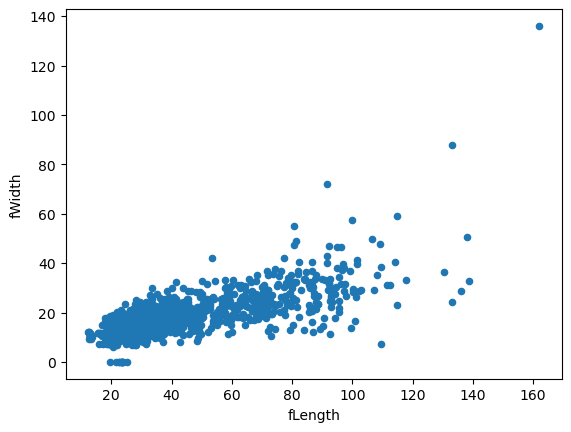

In [30]:
%matplotlib inline

data.plot.scatter("fLength","fWidth",)


array([[<Axes: title={'center': 'fAlpha'}>]], dtype=object)

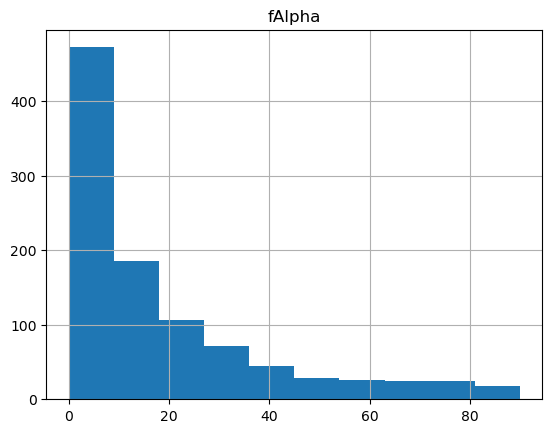

In [31]:
data.hist("fAlpha")

### ROOT

[ROOT](https://root.cern.ch/) needs a special mention. It is still nowadays, and by far, the most convenient tool to store and manage complex datasets pertaining physics experiments where "events" are recorded, in particular High Energy, Nuclear, Astro physics. It allows a nested structure, with complex data objects (classes) and references between them.

ROOT per se is obnoxious as it has been developed in the years as way-too-many-purposes package, but it's I/O is formidable.

Installing ROOT is (or at leaset used to be) a pain. 

(bare) ROOT files can be opened with non-ROOT library, [uproot](https://uproot.readthedocs.io/en/latest/index.html) (check its git [repo](https://github.com/scikit-hep/uproot))

A data structure, [RDataFrame](https://root.cern/doc/master/classROOT_1_1RDataFrame.html)
similar to the ones developed for modern Data Science applications has been put in production

In [32]:
import uproot


events = uproot.open("https://scikit-hep.org/uproot3/examples/Zmumu.root")["events"]
events

ModuleNotFoundError: No module named 'uproot'

In [ ]:
events.show()

In [ ]:
array = events["E1"].array(library="np")
array
plt.hist(array)

For more complicated examples, you can take a look at the CMS experiment [open data](http://opendata.cern.ch/docs/about-cms); sure you can find the Higgs boson in there, extracting the signal is way easier than obtaining, storing, and interpreting the data..